# EVA-4 : Assignment 15 - Final

### Summary
- Create dataset 
  - Only background (bg)
  - Background + Foreground (bg_fg)
  - Foreground Mask (fg_mask)
- Load Dataset
- Display sample images 
- Create Network
- Train Model
- Display Images


In [1]:
import torch
from IPython.display import Image, clear_output 

print('PyTorch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

PyTorch 1.5.0+cu101 _CudaDeviceProperties(name='Tesla K80', major=3, minor=7, total_memory=11441MB, multi_processor_count=13)


### Mount google drive

In [2]:
# Load data from Google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Install libraries

##### Dataset
- albumentation: Data Augmentation

##### Helper
- autotime : Prints cell execution time
- torchsummary : Prints model summary
- hiddenlayer: Print Model graph
- torchviz : Visualize model
- tensorboard : Tensorboard for visualizaton
- tensorboardX : Pytorch tensorboard

In [12]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-2stjzok8
  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-2stjzok8
     |████████████████████████████████| 634kB 2.8MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.5-cp36-none-any.whl size=65038 sha256=606225d4bb51baece218ed7e56819771474d642d936d931f3f32b42c9d6b2fec
  Stored in directory: /tmp/pip-ephem-wheel-cache-zb82im8l/wheels/45/8b/e4/2837bbcf517d00732b8e394f8646f22b8723ac00993230188b
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=e9d6b9a00782fac3f20244653024efa25d7b0b561742474ec6d409eb3ef01379
  Stored in directory: /tmp/pip-ephem-wheel-cache-zb82im8l/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built albumentations imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: album

time: 21.1 s


In [3]:
# Library to print cell execution time
!pip install ipython-autotime
%load_ext autotime

### Import all modules and libraries

In [4]:
# System
import os
import sys

# Scikit
import numpy as np

# Plotting
import matplotlib.pyplot as plt

# Pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torchsummary import summary

# Image Proessing
from PIL import Image

time: 243 ms


### Set the directory path of google drive

In [5]:
BASE_COLAB_PATH = '/content/drive/My Drive/eva-4/assignment-15/assignemnt-15-final' 

sys.path.append(BASE_COLAB_PATH)
sys.path.append(BASE_COLAB_PATH + '/models')
sys.path.append(BASE_COLAB_PATH + '/trial-1/dataset')
sys.path.append(BASE_COLAB_PATH + '/trial-1/dataset/bg')
sys.path.append(BASE_COLAB_PATH + '/trial-1/dataset/bg_fg')
sys.path.append(BASE_COLAB_PATH + '/trial-1/dataset/bg_fg_mask')

time: 4.43 ms


In [6]:
cd '/content/drive/My Drive/eva-4/assignment-15/assignment-15-final'

/content/drive/My Drive/eva-4/assignment-15/assignment-15-final
time: 3.67 ms


### Set Device

In [7]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
print(device)

cuda
time: 2.98 ms


### Import all the functions

In [8]:
#import custommodel
from models import custommodel
from functions import transformations, loaddataset, show, train
from dataset import ImageDataset # , loadcifar10dataset, getclasses, display, train, test, imshow, loadimage, saveimage
#from S12_functions import loadimagenetdataset, splittinyimagedataset, getloss, getoptimizer, getscheduler
#from gradcam import GradCAM, GradCAMpp, applygradcam
#from gradcam_utils import Normalize, visualize_cam
#from learningrate import findandplotlearningrate, plotCyclicLR, performLRRangeTest, getSchdeduler, getlr
#from plotutils import plotimages, plotmisclassifiedimages, savemisclassifiedimages, plotmisclassifiedgradcamimages, plotmetrics 

time: 499 ms


### Hyperparameters : TODO - Move it to config file



In [9]:
# Define hyper paramteres and constants
EPOCHS=50
BATCH_SIZE=32
IMAGENET_ROOT_DIR = BASE_COLAB_PATH + 'IMagenet/tiny-imagenet-200/'
IMAGENET_TRAIN_SET_DIR = "train_set"
IMAGENET_TEST_SET_DIR = "test_set"
IMAGENET_TRAIN_SET_DIR_PATH = IMAGENET_ROOT_DIR + IMAGENET_TRAIN_SET_DIR
IMAGENET_TEST_SET_DIR_PATH = IMAGENET_ROOT_DIR + IMAGENET_TEST_SET_DIR

trainaccuracies = []
trainlosses = []
testlosses = []
testaccuracies = []
lr_values = []

time: 5.38 ms


### Load Transformations

In [10]:
transform_train, transform_test = transformations()

time: 932 µs


### Load Dataset

In [11]:
data_root = '/content/drive/My Drive/eva-4/assignment-15/asssignment-15-A/s_ds/extracted_partial'
dataset, dataloader = loaddataset(data_root, transform_train)

Dataset: /content/drive/My Drive/eva-4/assignment-15/asssignment-15-A/s_ds/extracted_partial
Background and Foreground images: 500
Masks: 500
Depth maps: 500
time: 13.2 s


In [12]:
sample = next(iter(dataloader))

time: 1min 19s


In [13]:
images = sample['bg_fg']
masks = sample['mask']
depths = sample['depth']

time: 2.48 ms


In [14]:
print(images.shape)
print(masks.shape)
print(depths.shape)

torch.Size([32, 3, 224, 224])
torch.Size([32, 1, 224, 224])
torch.Size([32, 3, 224, 224])
time: 2.8 ms


### Display sample images

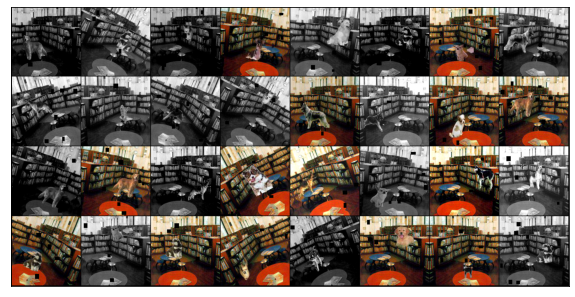

time: 432 ms


In [15]:
show(images)

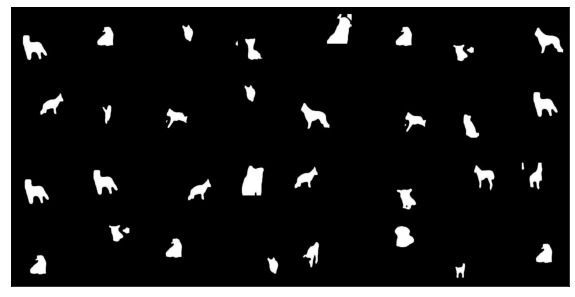

time: 338 ms


In [16]:
show(masks)

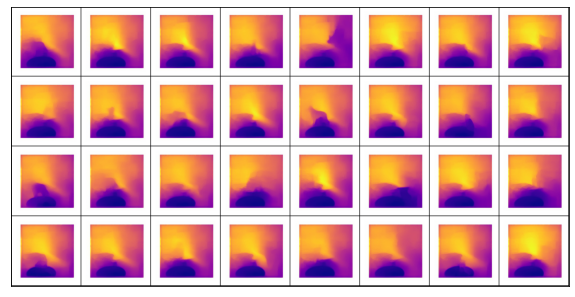

time: 459 ms


In [17]:
show(depths)

### Load Model

In [19]:
print("Building Model")
net = custommodel.CustomNet()

Building Model
time: 80.7 ms


In [20]:
model = net.to(device)
#summary(model, input_size=(3, 64, 64))

time: 21 ms


### Define loss function and optimizer


In [21]:
criterion = nn.BCEWithLogitsLoss() #SSIM( 3, reduction ="mean")
optimizer = torch.optim.SGD(model.parameters(),lr= 0.01, momentum=0.9, weight_decay=1e-5)

time: 1.76 ms


In [0]:
train(model, criterion, device, dataloader, optimizer, epoch=1)

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

Training Epoch: 1
  loss: 2.1029419898986816
Train Epoch: 1  [0/500  (0%)]	Loss:2.102942


Actual mask


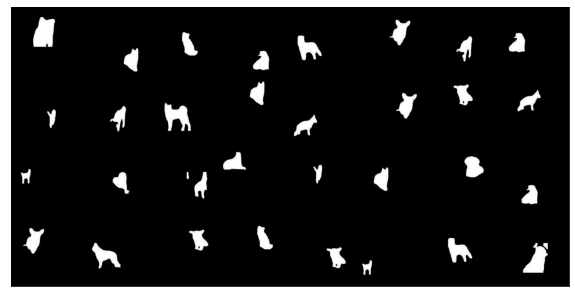



Predicted mask


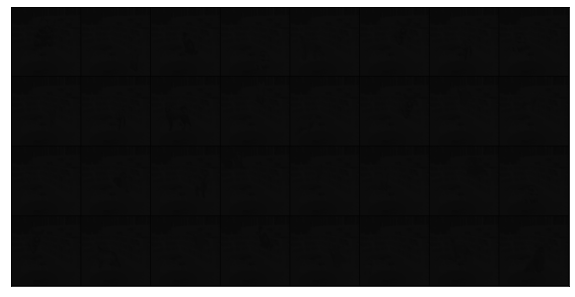



Actual Depth


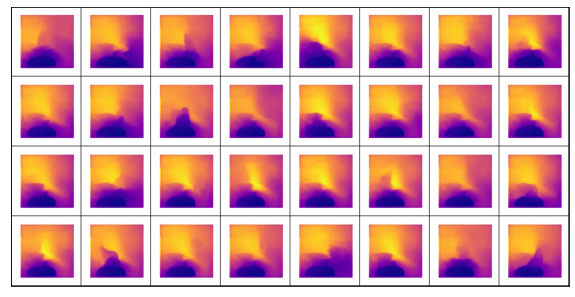

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


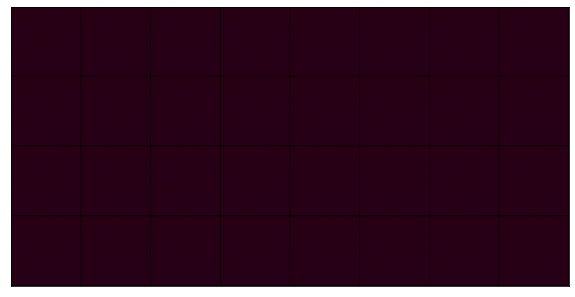

 12%|█▎        | 2/16 [00:53<06:26, 27.58s/it]

  loss: 2.09187388420105


 19%|█▉        | 3/16 [01:15<05:34, 25.77s/it]

  loss: 2.071507215499878


 25%|██▌       | 4/16 [01:40<05:06, 25.54s/it]

  loss: 2.0429365634918213


 31%|███▏      | 5/16 [02:02<04:28, 24.44s/it]

  loss: 2.007166862487793


 38%|███▊      | 6/16 [02:25<04:01, 24.19s/it]

  loss: 1.9681346416473389


 44%|████▍     | 7/16 [02:50<03:38, 24.24s/it]

  loss: 1.924577236175537


 50%|█████     | 8/16 [03:13<03:11, 23.89s/it]

  loss: 1.8768343925476074


 56%|█████▋    | 9/16 [03:37<02:47, 23.96s/it]

  loss: 1.8308875560760498


 62%|██████▎   | 10/16 [04:01<02:24, 24.07s/it]

  loss: 1.7779440879821777


 69%|██████▉   | 11/16 [04:25<01:59, 23.95s/it]

  loss: 1.7325727939605713


 75%|███████▌  | 12/16 [04:48<01:34, 23.73s/it]

  loss: 1.6828504800796509


 81%|████████▏ | 13/16 [05:13<01:11, 23.94s/it]

  loss: 1.6291685104370117


 88%|████████▊ | 14/16 [05:35<00:47, 23.51s/it]

  loss: 1.5851080417633057


 94%|█████████▍| 15/16 [05:59<00:23, 23.63s/it]

  loss: 1.5304031372070312


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 1.4959466457366943
Training Epoch: 2
  loss: 1.4433127641677856
Train Epoch: 2  [0/500  (0%)]	Loss:1.443313


Actual mask


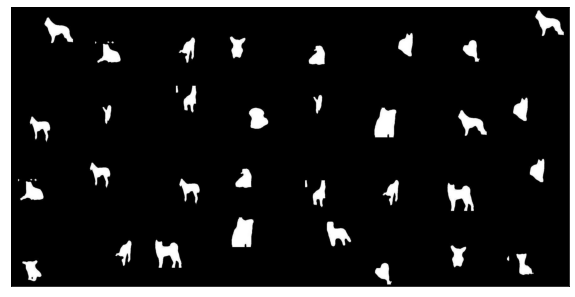

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


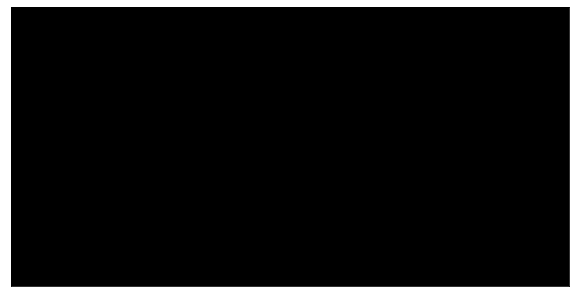



Actual Depth


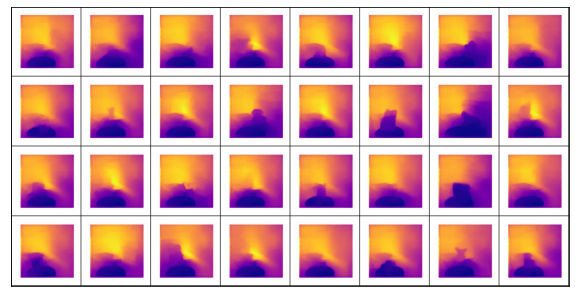



Predicted Depth


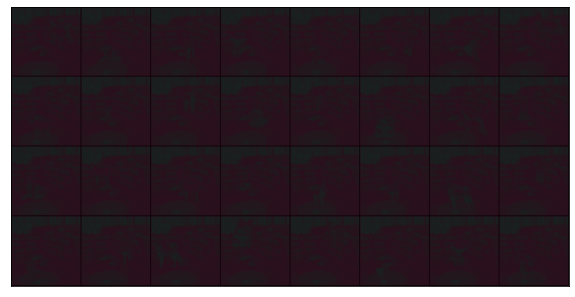

 12%|█▎        | 2/16 [00:05<00:44,  3.14s/it]

  loss: 1.3890351057052612


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 1.3518610000610352


 25%|██▌       | 4/16 [00:08<00:28,  2.40s/it]

  loss: 1.3082385063171387


 31%|███▏      | 5/16 [00:10<00:23,  2.18s/it]

  loss: 1.2537431716918945


 38%|███▊      | 6/16 [00:11<00:20,  2.03s/it]

  loss: 1.2227534055709839


 44%|████▍     | 7/16 [00:13<00:17,  1.92s/it]

  loss: 1.1763845682144165


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 1.1414258480072021


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 1.1087220907211304


 62%|██████▎   | 10/16 [00:18<00:10,  1.76s/it]

  loss: 1.1343342065811157


 69%|██████▉   | 11/16 [00:20<00:08,  1.73s/it]

  loss: 1.0657312870025635


 75%|███████▌  | 12/16 [00:21<00:06,  1.72s/it]

  loss: 1.084672451019287


 81%|████████▏ | 13/16 [00:23<00:05,  1.71s/it]

  loss: 1.0735535621643066


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 1.0181845426559448


 94%|█████████▍| 15/16 [00:26<00:01,  1.69s/it]

  loss: 1.1164268255233765


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 1.0889300107955933
Training Epoch: 3
  loss: 1.1001336574554443
Train Epoch: 3  [0/500  (0%)]	Loss:1.100134


Actual mask


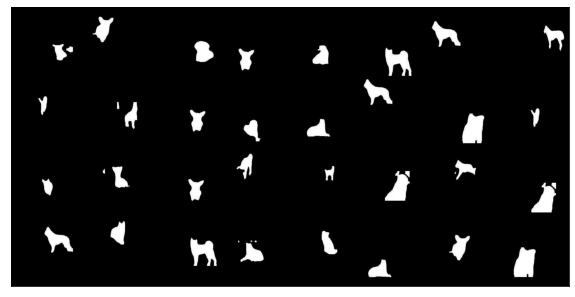

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


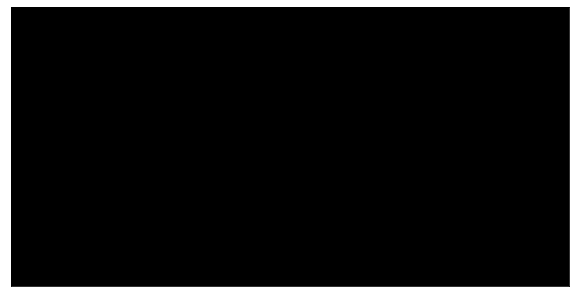



Actual Depth


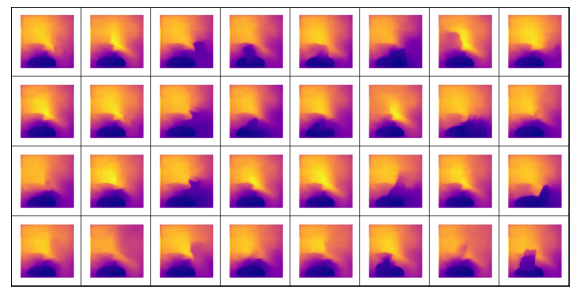



Predicted Depth


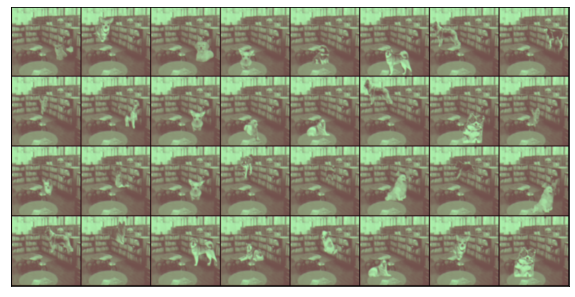

 12%|█▎        | 2/16 [00:05<00:46,  3.30s/it]

  loss: 1.0689973831176758


 19%|█▉        | 3/16 [00:07<00:36,  2.82s/it]

  loss: 0.9842367768287659


 25%|██▌       | 4/16 [00:08<00:29,  2.48s/it]

  loss: 1.0193451642990112


 31%|███▏      | 5/16 [00:10<00:24,  2.23s/it]

  loss: 1.0375264883041382


 38%|███▊      | 6/16 [00:12<00:20,  2.07s/it]

  loss: 1.0412297248840332


 44%|████▍     | 7/16 [00:13<00:17,  1.95s/it]

  loss: 0.9931400418281555


 50%|█████     | 8/16 [00:15<00:14,  1.87s/it]

  loss: 0.96734219789505


 56%|█████▋    | 9/16 [00:17<00:12,  1.81s/it]

  loss: 0.9945507049560547


 62%|██████▎   | 10/16 [00:18<00:10,  1.77s/it]

  loss: 0.9722749590873718


 69%|██████▉   | 11/16 [00:20<00:08,  1.74s/it]

  loss: 1.0099748373031616


 75%|███████▌  | 12/16 [00:22<00:06,  1.72s/it]

  loss: 0.9785779714584351


 81%|████████▏ | 13/16 [00:23<00:05,  1.72s/it]

  loss: 0.9831959009170532


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 0.9684072732925415


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.976688802242279


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9822849035263062
Training Epoch: 4
  loss: 0.9745556116104126
Train Epoch: 4  [0/500  (0%)]	Loss:0.974556


Actual mask


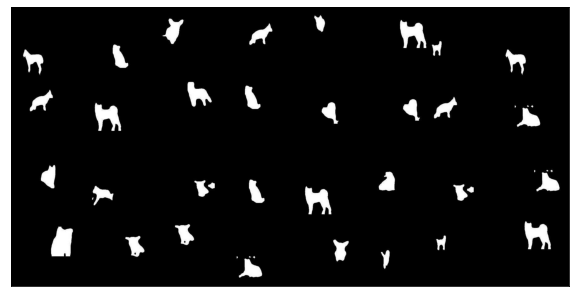

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


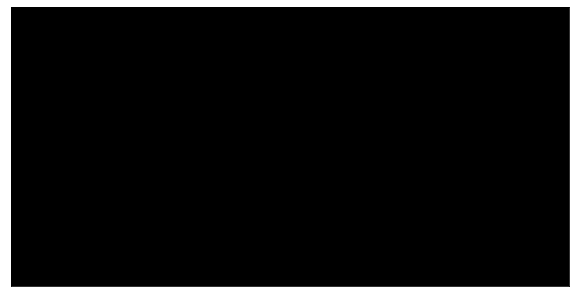



Actual Depth


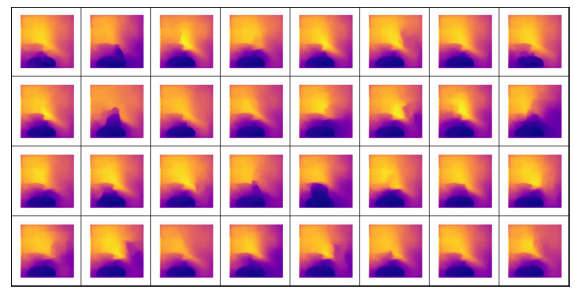

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


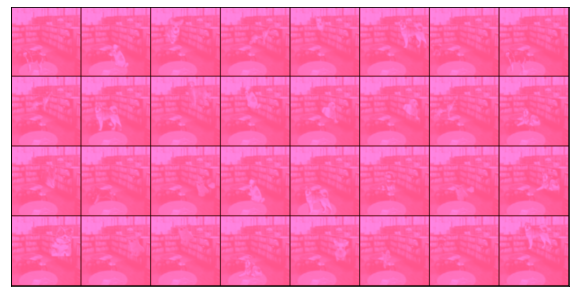

 12%|█▎        | 2/16 [00:05<00:46,  3.31s/it]

  loss: 0.9748835563659668


 19%|█▉        | 3/16 [00:07<00:36,  2.83s/it]

  loss: 1.0029690265655518


 25%|██▌       | 4/16 [00:08<00:29,  2.48s/it]

  loss: 1.0015301704406738


 31%|███▏      | 5/16 [00:10<00:24,  2.24s/it]

  loss: 0.9548810720443726


 38%|███▊      | 6/16 [00:12<00:20,  2.08s/it]

  loss: 0.9629895687103271


 44%|████▍     | 7/16 [00:13<00:17,  1.96s/it]

  loss: 0.9988056421279907


 50%|█████     | 8/16 [00:15<00:14,  1.87s/it]

  loss: 0.9712485671043396


 56%|█████▋    | 9/16 [00:17<00:12,  1.80s/it]

  loss: 0.956287145614624


 62%|██████▎   | 10/16 [00:18<00:10,  1.76s/it]

  loss: 0.942283570766449


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.9830429553985596


 75%|███████▌  | 12/16 [00:22<00:06,  1.70s/it]

  loss: 0.9230989217758179


 81%|████████▏ | 13/16 [00:23<00:05,  1.68s/it]

  loss: 0.9771856069564819


 88%|████████▊ | 14/16 [00:25<00:03,  1.67s/it]

  loss: 0.9489504098892212


 94%|█████████▍| 15/16 [00:27<00:01,  1.67s/it]

  loss: 1.0086430311203003


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9657588601112366
Training Epoch: 5
  loss: 0.9702556133270264
Train Epoch: 5  [0/500  (0%)]	Loss:0.970256


Actual mask


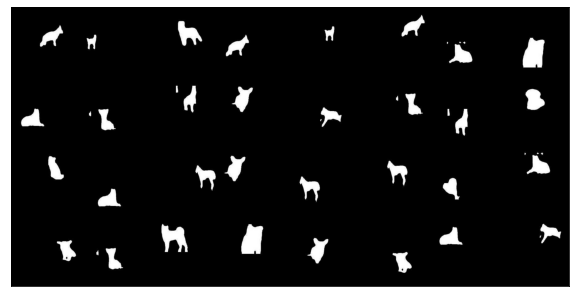

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


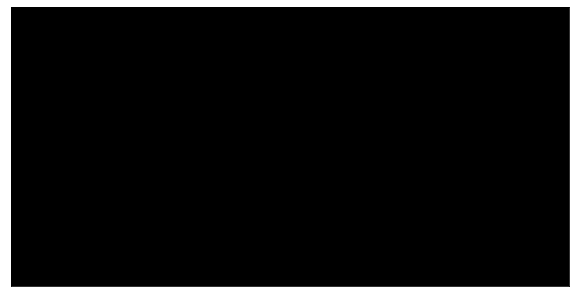



Actual Depth


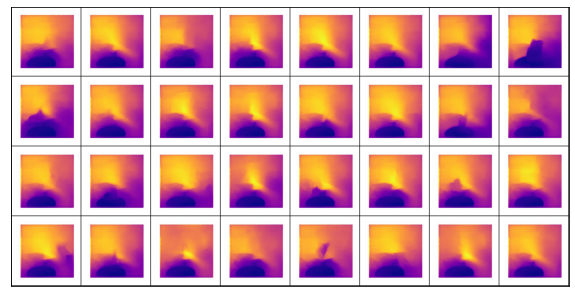

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


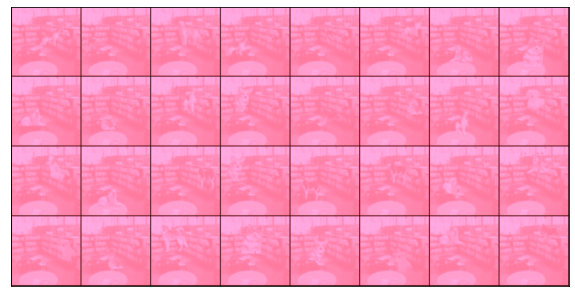

 12%|█▎        | 2/16 [00:05<00:43,  3.13s/it]

  loss: 0.9872164726257324


 19%|█▉        | 3/16 [00:06<00:35,  2.69s/it]

  loss: 0.9863557815551758


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.9725779294967651


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.9997941255569458


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.9801112413406372


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9790443181991577


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.9629002809524536


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9368640184402466


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9794576168060303


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.9679368138313293


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9499940872192383


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9566264152526855


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.9544504284858704


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.9481951594352722


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9214707612991333
Training Epoch: 6
  loss: 1.0030901432037354
Train Epoch: 6  [0/500  (0%)]	Loss:1.003090


Actual mask


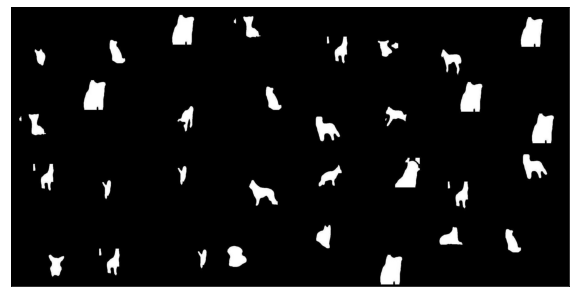

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


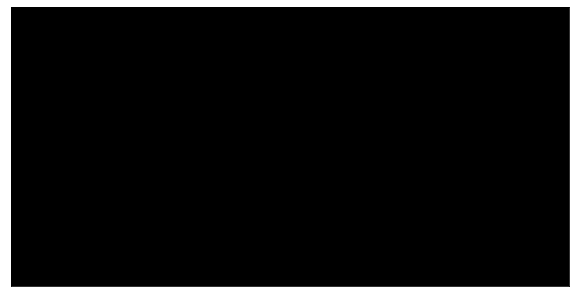



Actual Depth


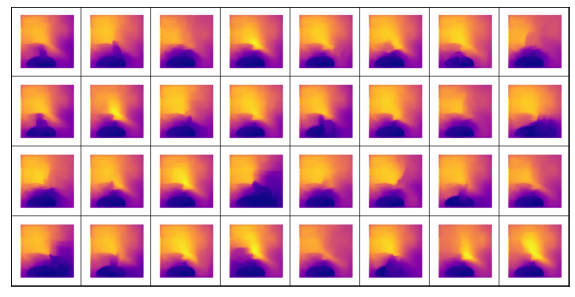

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


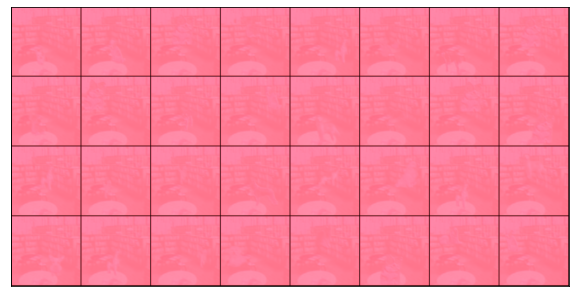

 12%|█▎        | 2/16 [00:05<00:43,  3.11s/it]

  loss: 0.9704924821853638


 19%|█▉        | 3/16 [00:06<00:34,  2.67s/it]

  loss: 0.9248776435852051


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.9272300004959106


 31%|███▏      | 5/16 [00:10<00:23,  2.15s/it]

  loss: 0.9437450170516968


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.9655159115791321


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 1.0228265523910522


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.962607741355896


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.996281623840332


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9391106367111206


 69%|██████▉   | 11/16 [00:19<00:08,  1.71s/it]

  loss: 0.9328941702842712


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9748607873916626


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9625297784805298


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.9621716737747192


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.951251208782196


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9763936996459961
Training Epoch: 7
  loss: 0.960399866104126
Train Epoch: 7  [0/500  (0%)]	Loss:0.960400


Actual mask


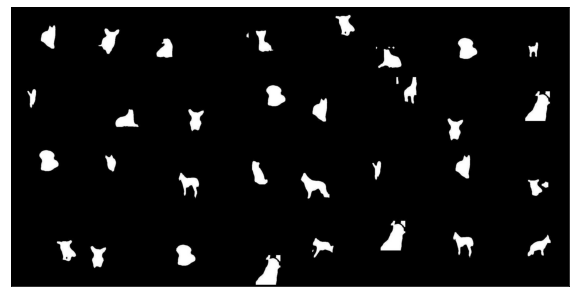

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


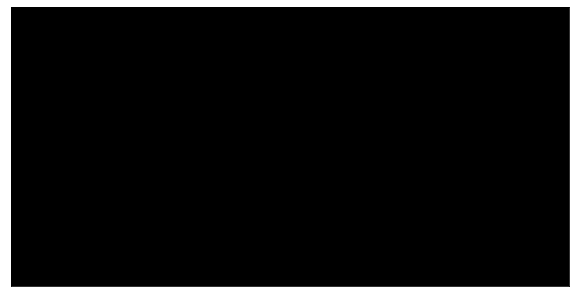



Actual Depth


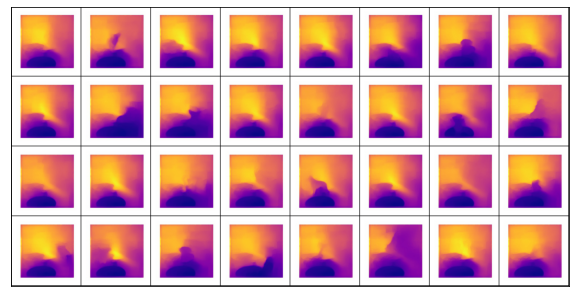

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


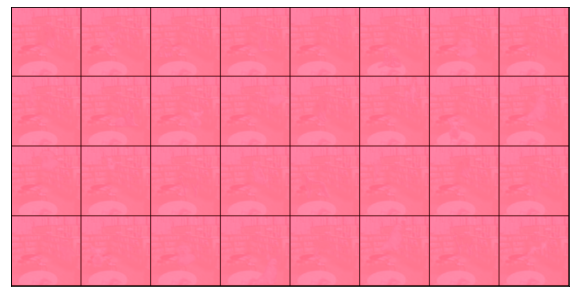

 12%|█▎        | 2/16 [00:05<00:43,  3.14s/it]

  loss: 0.9684463143348694


 19%|█▉        | 3/16 [00:06<00:35,  2.69s/it]

  loss: 0.943175196647644


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.9466073513031006


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.9823024272918701


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.9791233539581299


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9265896081924438


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.9393623471260071


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9441272020339966


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.98362135887146


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.9372759461402893


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9695172309875488


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9987246990203857


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.9733328223228455


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.9608114957809448


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.956778347492218
Training Epoch: 8
  loss: 0.9714083671569824
Train Epoch: 8  [0/500  (0%)]	Loss:0.971408


Actual mask


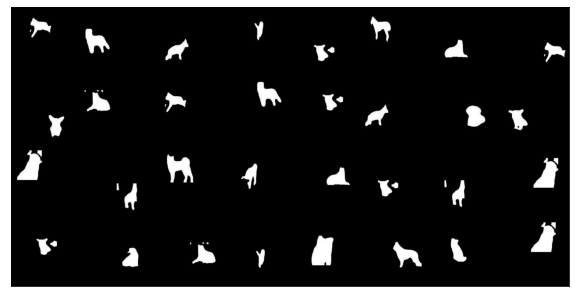

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


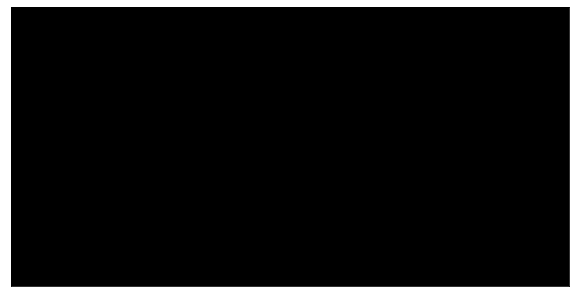



Actual Depth


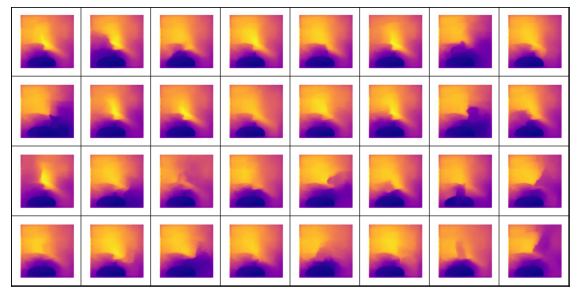

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


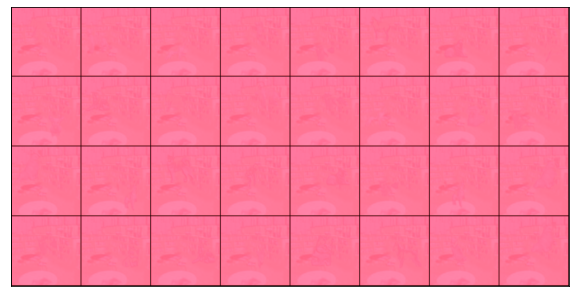

 12%|█▎        | 2/16 [00:05<00:43,  3.11s/it]

  loss: 0.9540824890136719


 19%|█▉        | 3/16 [00:06<00:34,  2.68s/it]

  loss: 0.9540197849273682


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.9990881085395813


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.9441339373588562


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.9501564502716064


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9467853903770447


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.9704901576042175


 56%|█████▋    | 9/16 [00:16<00:12,  1.77s/it]

  loss: 0.9658515453338623


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9847924709320068


 69%|██████▉   | 11/16 [00:19<00:08,  1.71s/it]

  loss: 0.9684357047080994


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9207663536071777


 81%|████████▏ | 13/16 [00:23<00:05,  1.68s/it]

  loss: 0.933944582939148


 88%|████████▊ | 14/16 [00:24<00:03,  1.67s/it]

  loss: 0.9605658054351807


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.9635530710220337


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9281625747680664
Training Epoch: 9
  loss: 0.9645185470581055
Train Epoch: 9  [0/500  (0%)]	Loss:0.964519


Actual mask


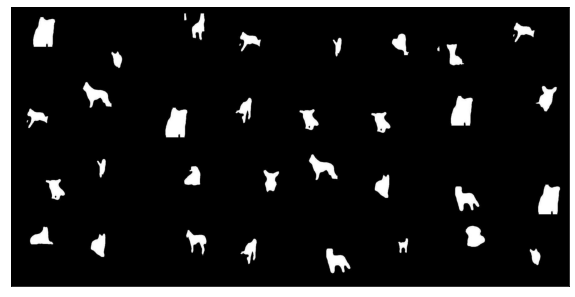

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


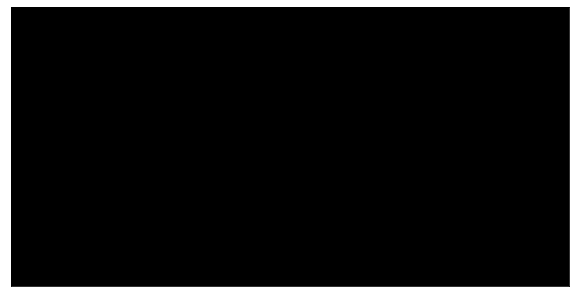



Actual Depth


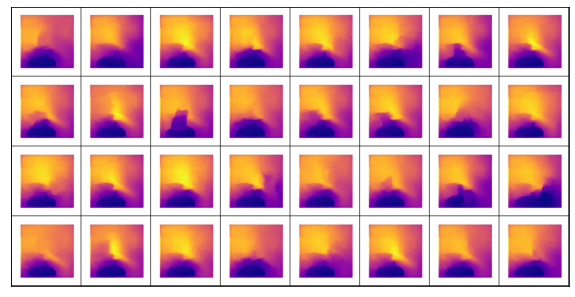

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


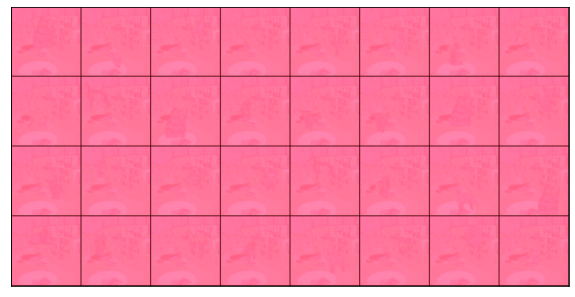

 12%|█▎        | 2/16 [00:05<00:43,  3.11s/it]

  loss: 0.9480608701705933


 19%|█▉        | 3/16 [00:06<00:34,  2.68s/it]

  loss: 0.9745831489562988


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.923965573310852


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.9576014280319214


 38%|███▊      | 6/16 [00:11<00:20,  2.00s/it]

  loss: 0.9447572231292725


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9448974132537842


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.9738028049468994


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9470934867858887


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9564511775970459


 69%|██████▉   | 11/16 [00:19<00:08,  1.71s/it]

  loss: 0.9555584788322449


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9554058313369751


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9543268084526062


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.9469521045684814


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.9647369384765625


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9735411405563354
Training Epoch: 10
  loss: 0.919589638710022
Train Epoch: 10  [0/500  (0%)]	Loss:0.919590


Actual mask


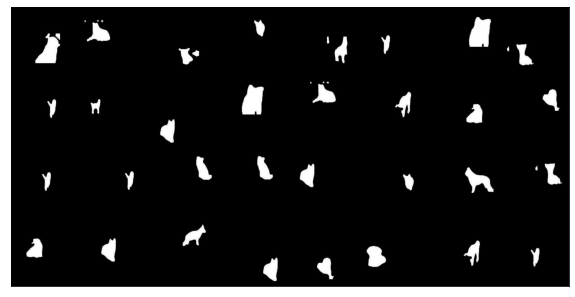

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


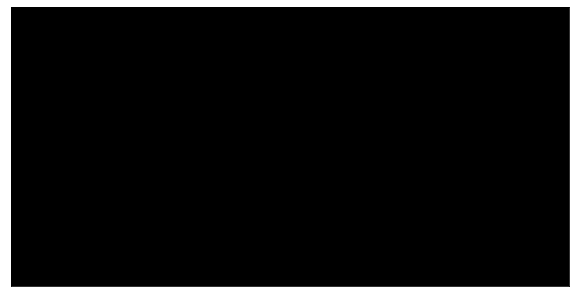



Actual Depth


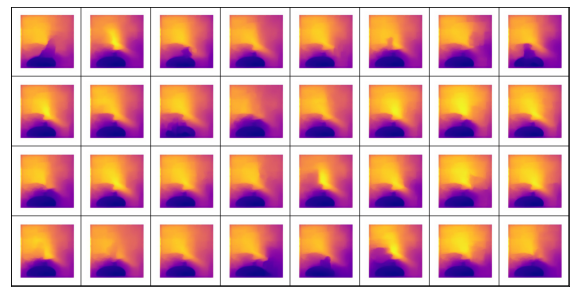

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


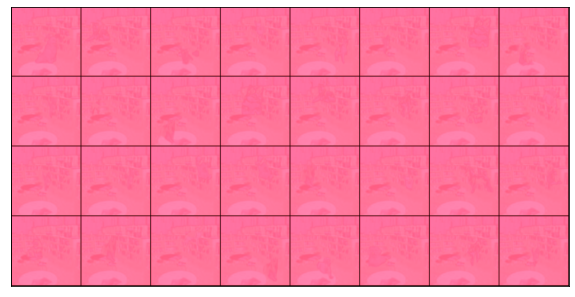

  6%|▋         | 1/16 [00:04<01:02,  4.15s/it]

  loss: 0.9721489548683167
Train Epoch: 10  [3/500  (6%)]	Loss:0.972149


Actual mask


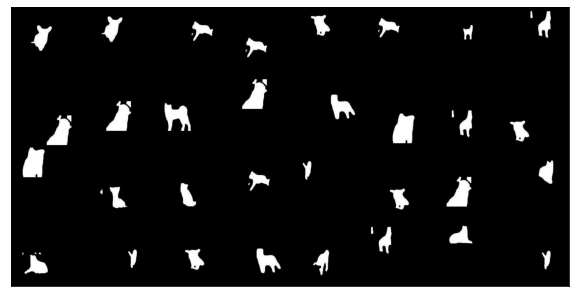

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


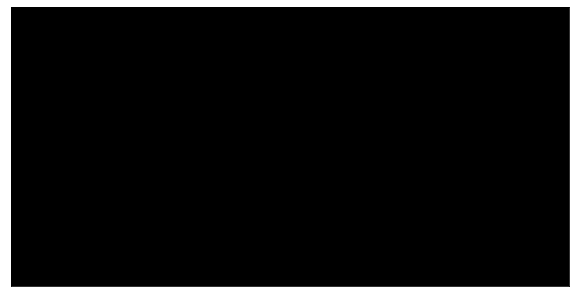



Actual Depth


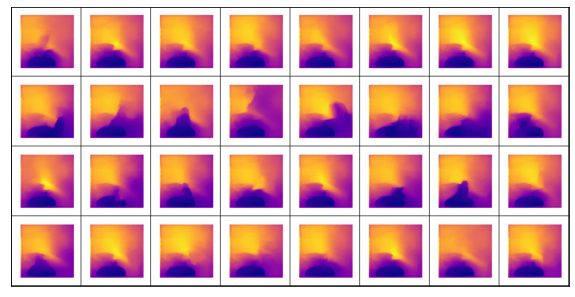

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


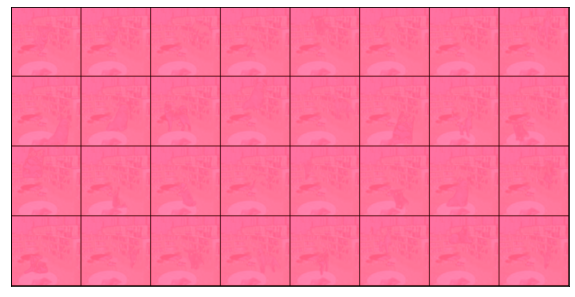

 12%|█▎        | 2/16 [00:08<00:57,  4.10s/it]

  loss: 0.9474166035652161
Train Epoch: 10  [6/500  (12%)]	Loss:0.947417


Actual mask


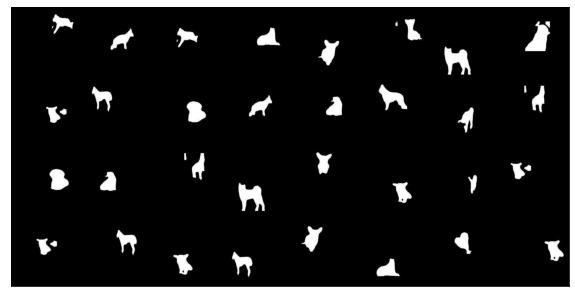

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


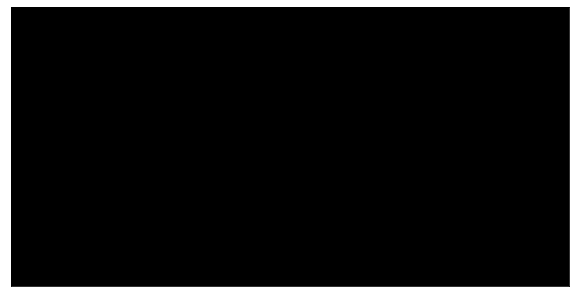



Actual Depth


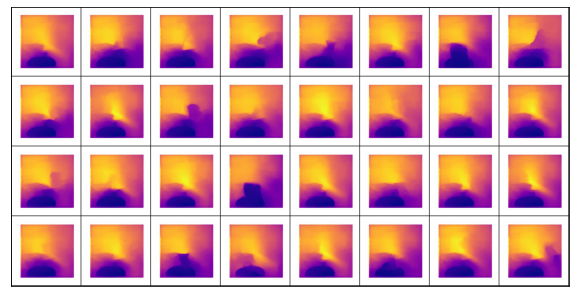

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


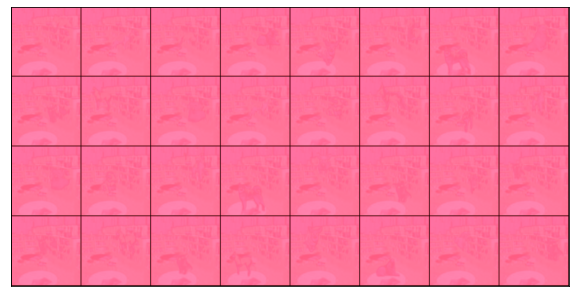

 19%|█▉        | 3/16 [00:12<00:52,  4.04s/it]

  loss: 1.0041446685791016
Train Epoch: 10  [9/500  (19%)]	Loss:1.004145


Actual mask


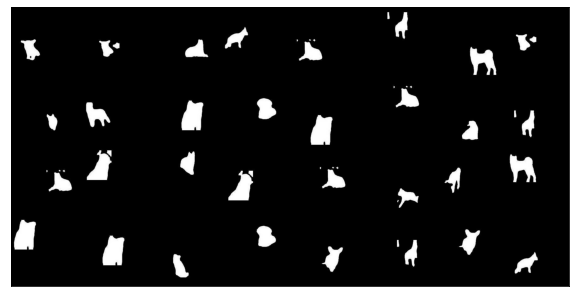

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


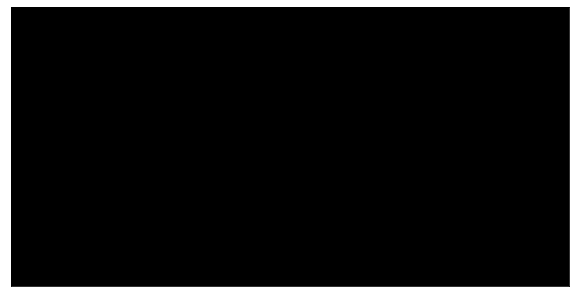



Actual Depth


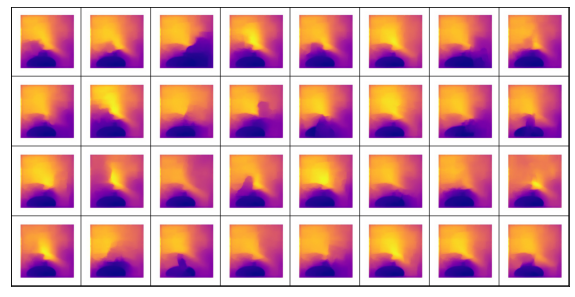

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


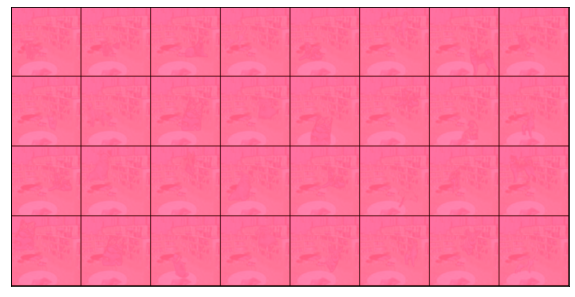

 25%|██▌       | 4/16 [00:15<00:48,  4.01s/it]

  loss: 0.960705041885376
Train Epoch: 10  [12/500  (25%)]	Loss:0.960705


Actual mask


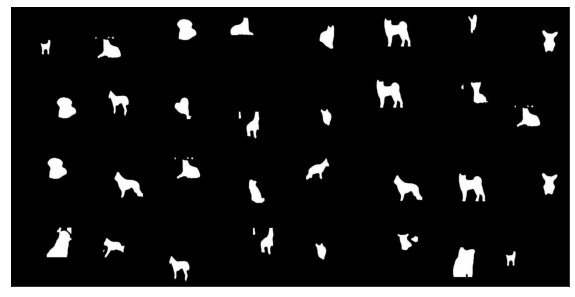

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


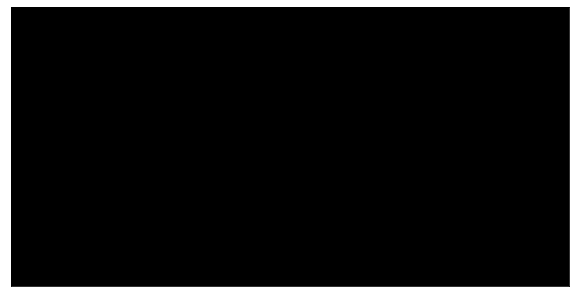



Actual Depth


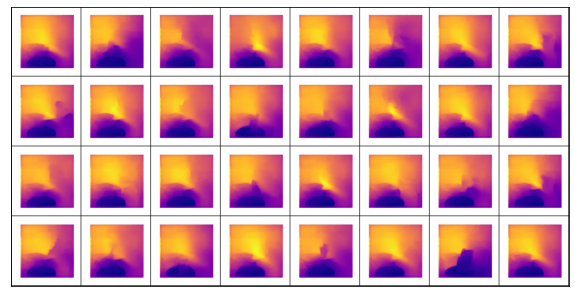

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


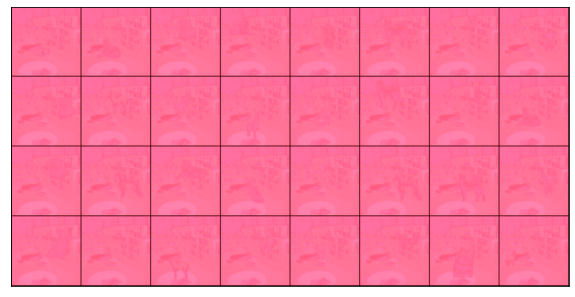

 31%|███▏      | 5/16 [00:19<00:43,  3.99s/it]

  loss: 0.9655977487564087
Train Epoch: 10  [15/500  (31%)]	Loss:0.965598


Actual mask


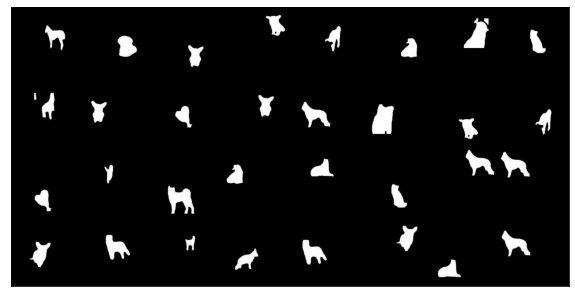

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


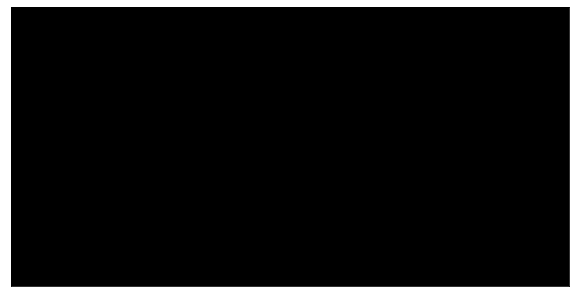



Actual Depth


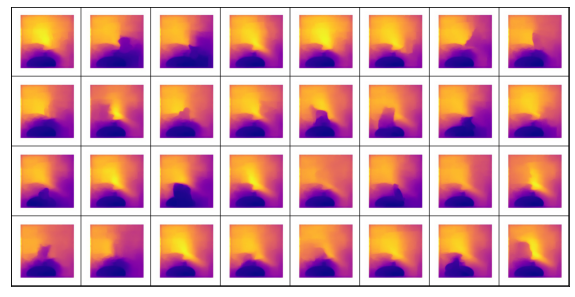

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


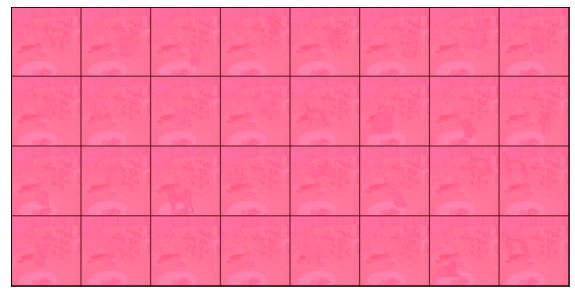

 38%|███▊      | 6/16 [00:23<00:39,  3.99s/it]

  loss: 0.9472981691360474
Train Epoch: 10  [18/500  (38%)]	Loss:0.947298


Actual mask


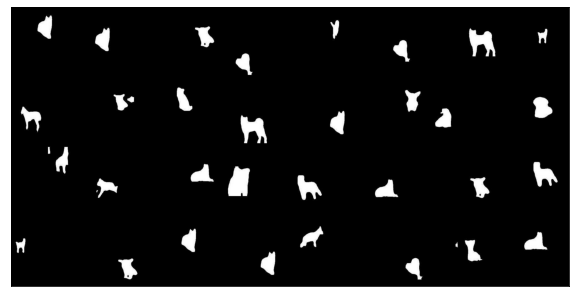

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


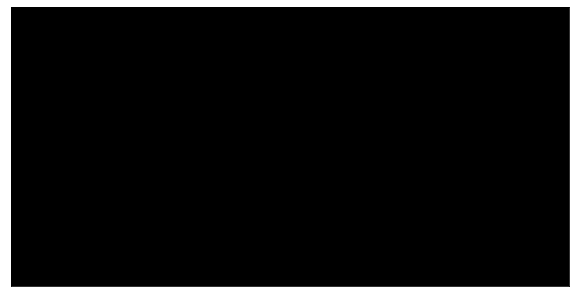



Actual Depth


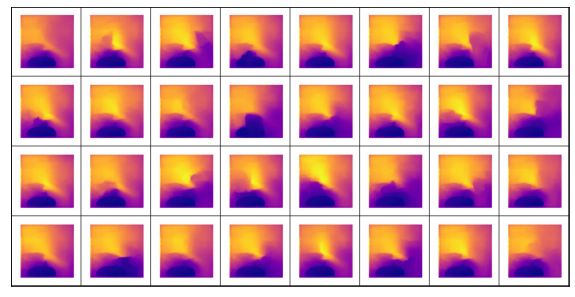

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


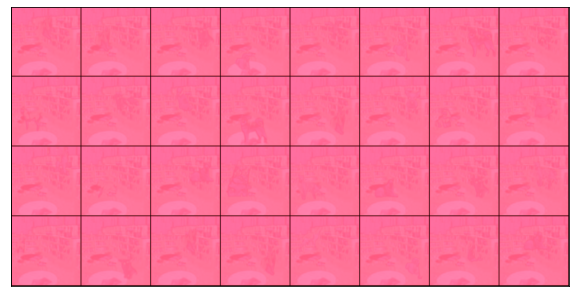

 44%|████▍     | 7/16 [00:27<00:35,  3.99s/it]

  loss: 0.9425256252288818
Train Epoch: 10  [21/500  (44%)]	Loss:0.942526


Actual mask


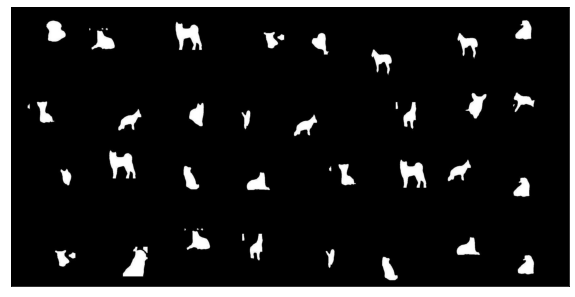

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


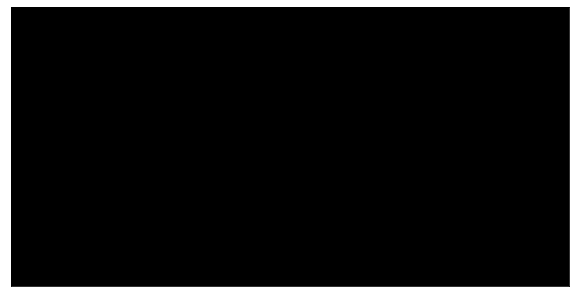



Actual Depth


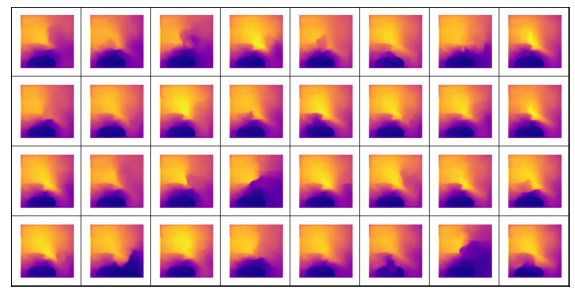

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


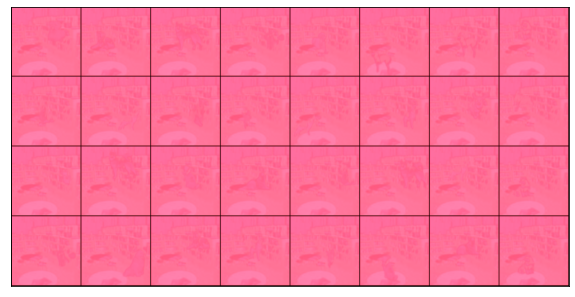

 50%|█████     | 8/16 [00:31<00:31,  3.99s/it]

  loss: 0.9336691498756409
Train Epoch: 10  [24/500  (50%)]	Loss:0.933669


Actual mask


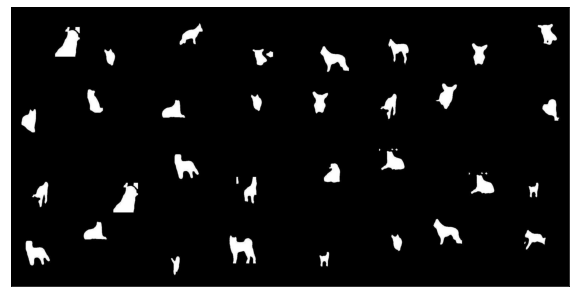

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


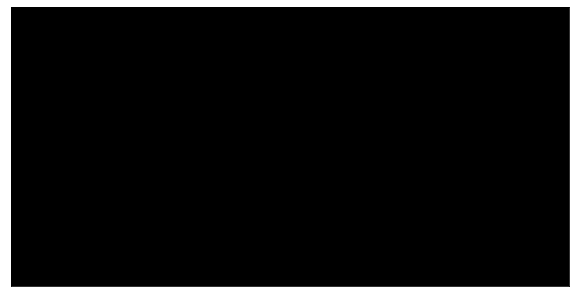



Actual Depth


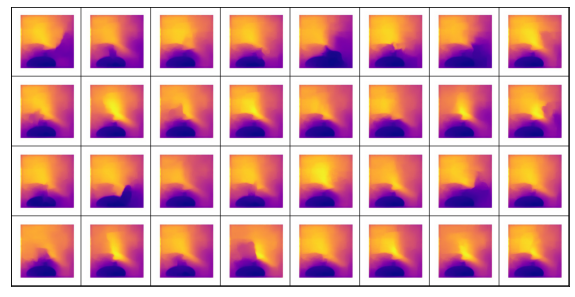

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


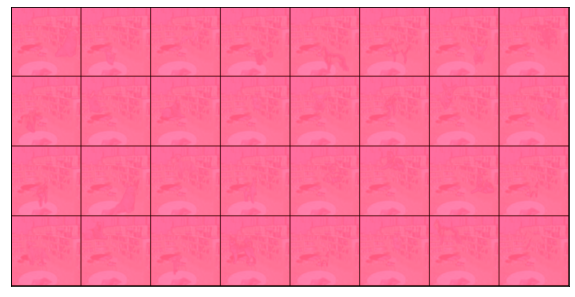

 56%|█████▋    | 9/16 [00:35<00:28,  4.02s/it]

  loss: 0.9494340419769287
Train Epoch: 10  [27/500  (56%)]	Loss:0.949434


Actual mask


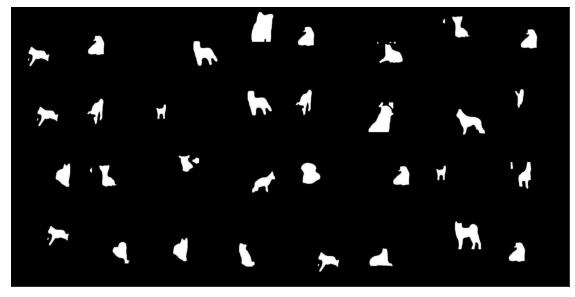

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


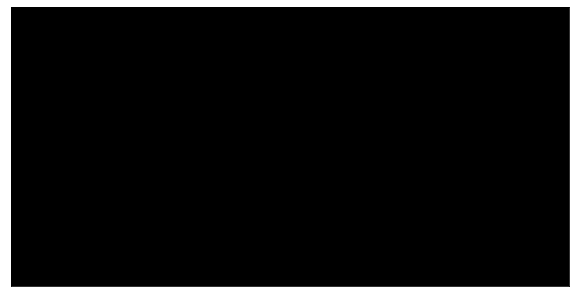



Actual Depth


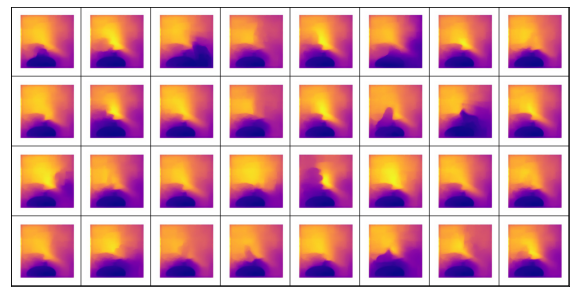

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


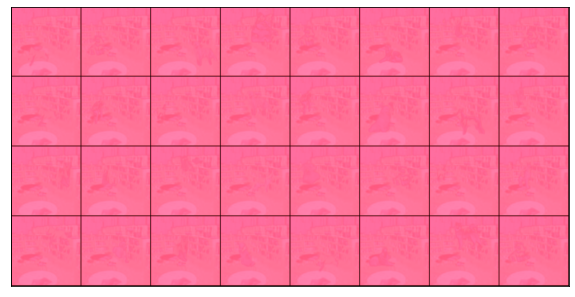

 62%|██████▎   | 10/16 [00:39<00:23,  3.99s/it]

  loss: 0.9405670166015625
Train Epoch: 10  [30/500  (62%)]	Loss:0.940567


Actual mask


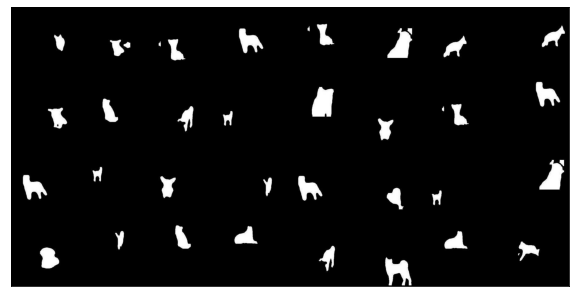

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


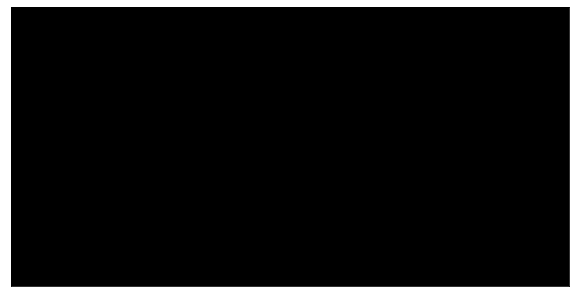



Actual Depth


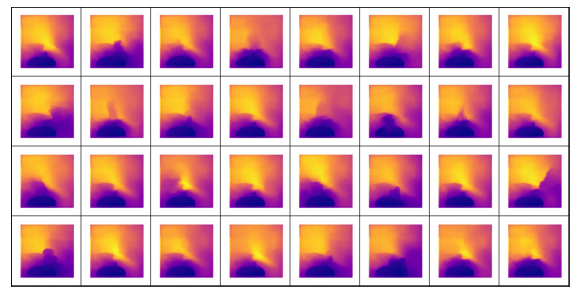

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


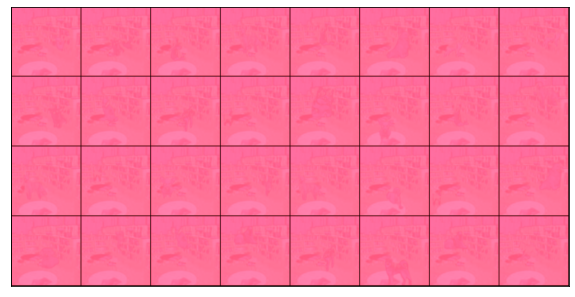

 69%|██████▉   | 11/16 [00:43<00:19,  3.97s/it]

  loss: 0.94004225730896
Train Epoch: 10  [33/500  (69%)]	Loss:0.940042


Actual mask


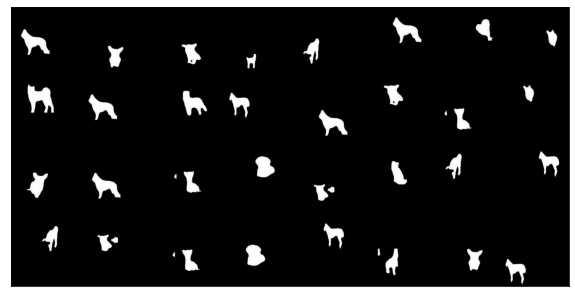

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


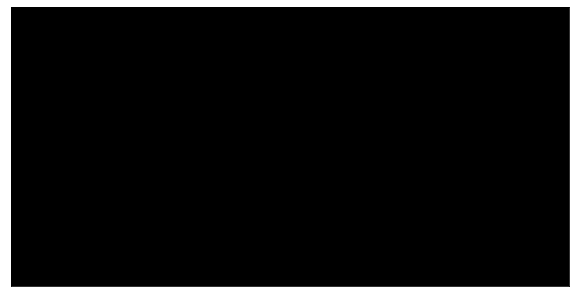



Actual Depth


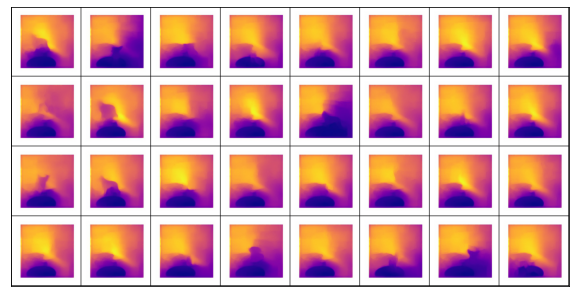

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


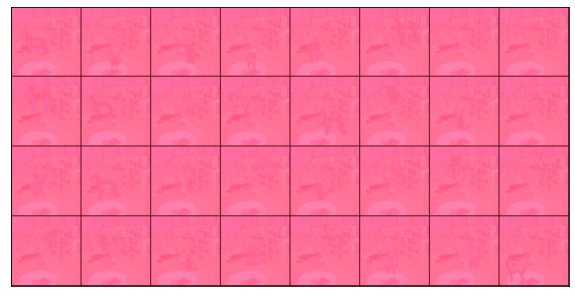

 75%|███████▌  | 12/16 [00:47<00:15,  3.97s/it]

  loss: 0.9328929781913757
Train Epoch: 10  [36/500  (75%)]	Loss:0.932893


Actual mask


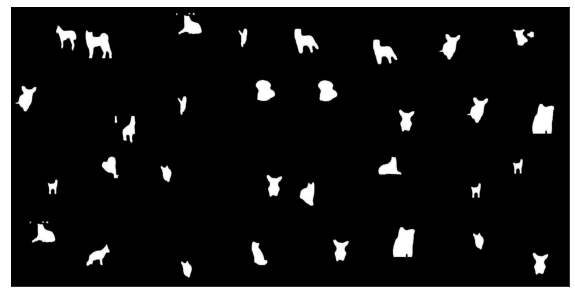

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


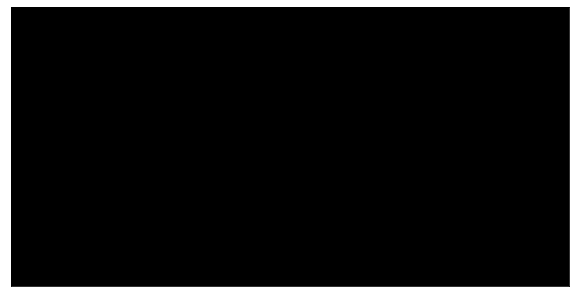



Actual Depth


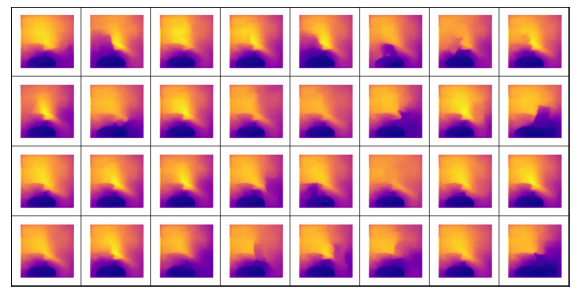

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


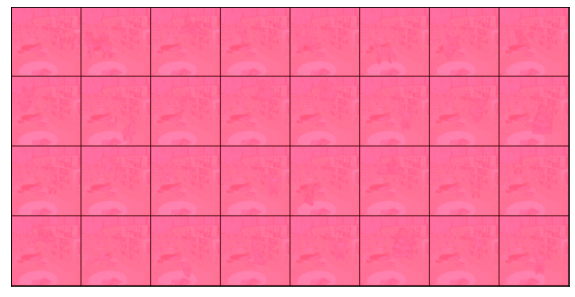

 81%|████████▏ | 13/16 [00:51<00:11,  3.95s/it]

  loss: 0.9448875188827515
Train Epoch: 10  [39/500  (81%)]	Loss:0.944888


Actual mask


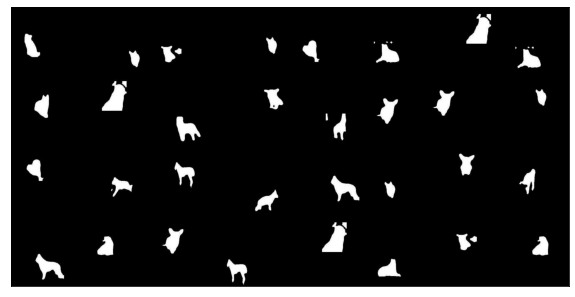

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


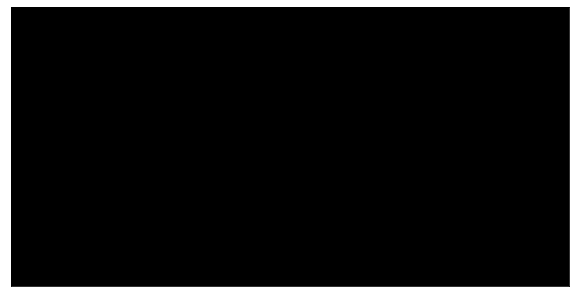



Actual Depth


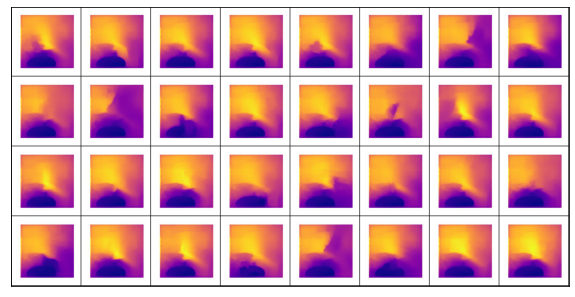

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


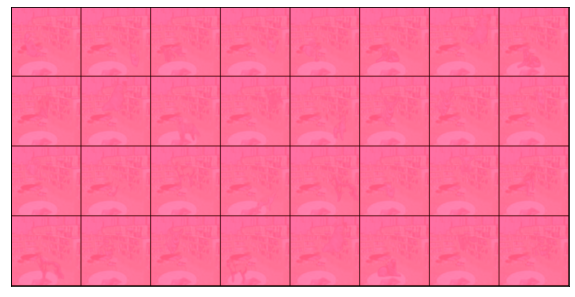

 88%|████████▊ | 14/16 [00:55<00:07,  3.96s/it]

  loss: 0.9878115653991699
Train Epoch: 10  [42/500  (88%)]	Loss:0.987812


Actual mask


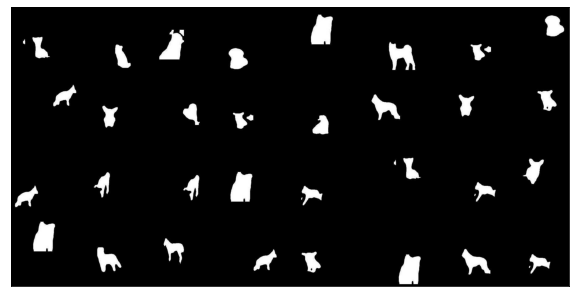

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


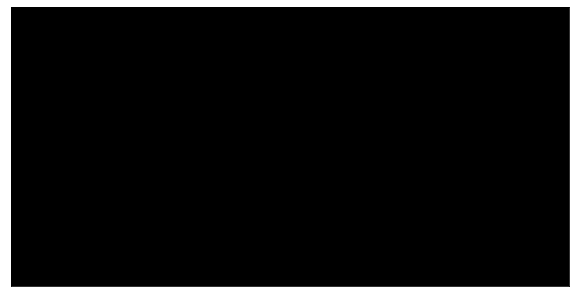



Actual Depth


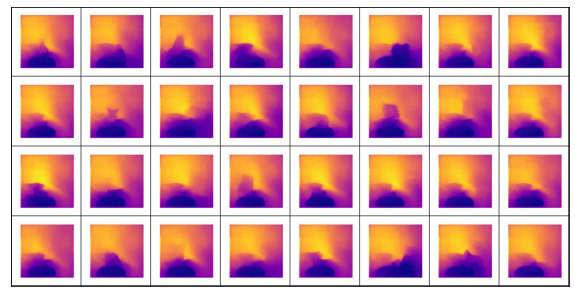

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


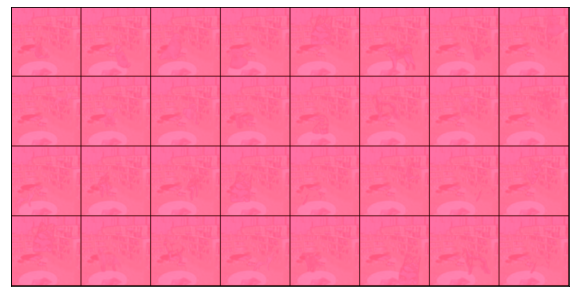

 94%|█████████▍| 15/16 [00:59<00:03,  3.99s/it]

  loss: 0.9262228012084961
Train Epoch: 10  [45/500  (94%)]	Loss:0.926223


Actual mask


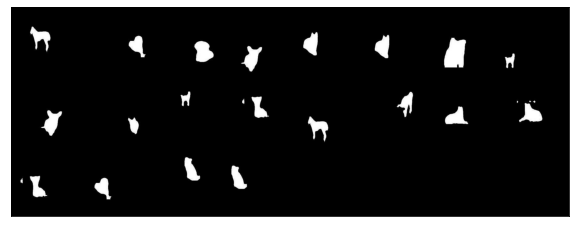

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


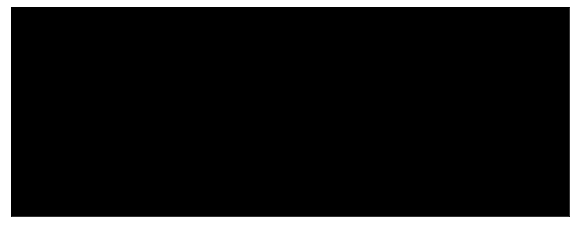



Actual Depth


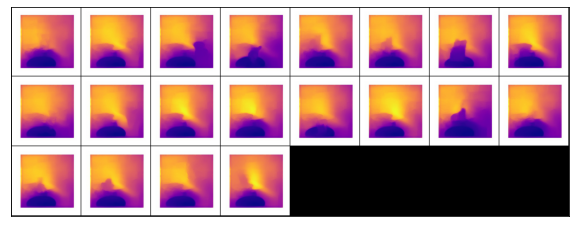

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


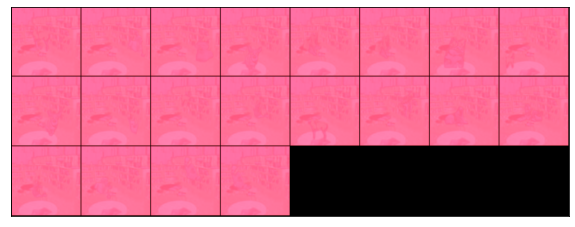

  0%|          | 0/16 [00:00<?, ?it/s]

Training Epoch: 11
  loss: 0.9426003694534302
Train Epoch: 11  [0/500  (0%)]	Loss:0.942600


Actual mask


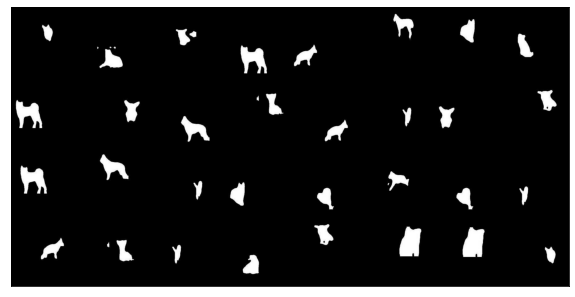

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


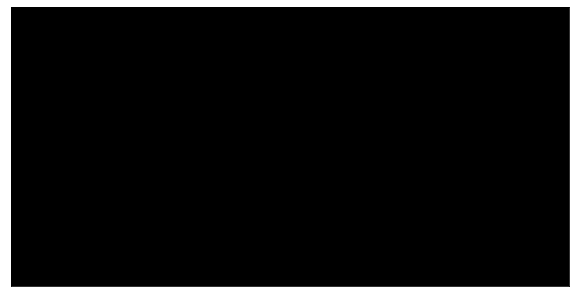



Actual Depth


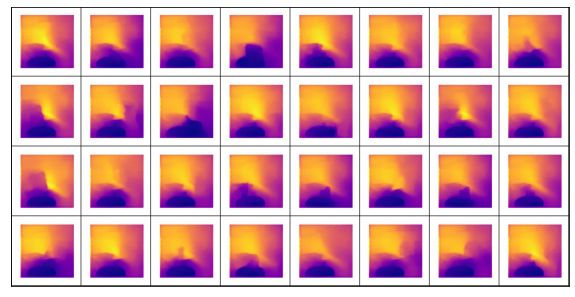

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


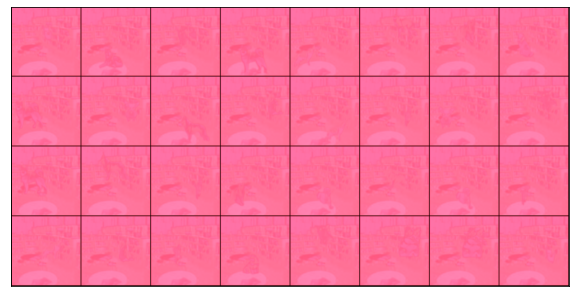

 12%|█▎        | 2/16 [00:04<00:42,  3.02s/it]

  loss: 0.9155309200286865


 19%|█▉        | 3/16 [00:06<00:34,  2.63s/it]

  loss: 0.9337016344070435


 25%|██▌       | 4/16 [00:08<00:28,  2.35s/it]

  loss: 0.9421526193618774


 31%|███▏      | 5/16 [00:10<00:23,  2.14s/it]

  loss: 0.931751012802124


 38%|███▊      | 6/16 [00:11<00:19,  2.00s/it]

  loss: 0.9220646023750305


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9625130295753479


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.9438321590423584


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9680101275444031


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.9447437524795532


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.9637900590896606


 75%|███████▌  | 12/16 [00:21<00:06,  1.71s/it]

  loss: 0.9839464426040649


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.9537292122840881


 88%|████████▊ | 14/16 [00:25<00:03,  1.69s/it]

  loss: 0.9634304642677307


 94%|█████████▍| 15/16 [00:26<00:01,  1.69s/it]

  loss: 0.9251483678817749


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9490392208099365
Training Epoch: 12
  loss: 0.9671381115913391
Train Epoch: 12  [0/500  (0%)]	Loss:0.967138


Actual mask


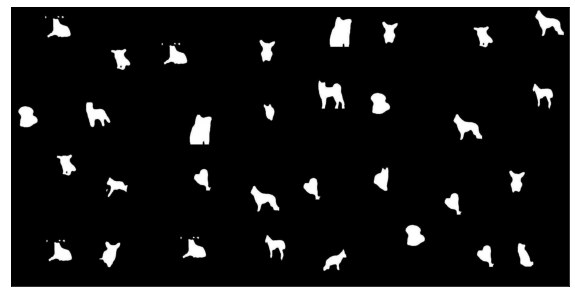

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


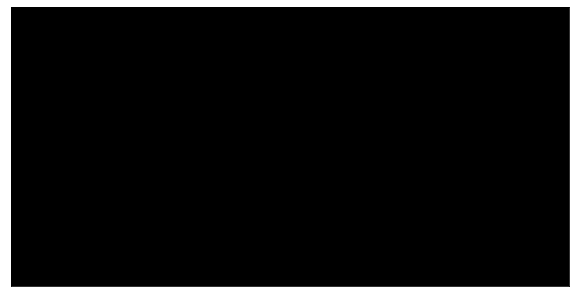



Actual Depth


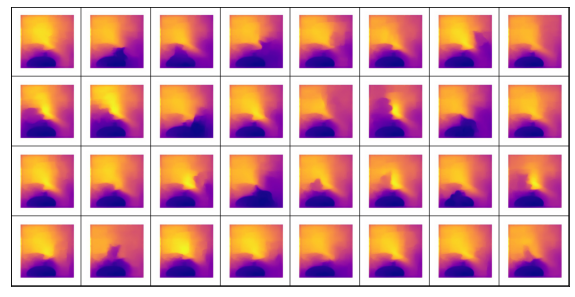

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


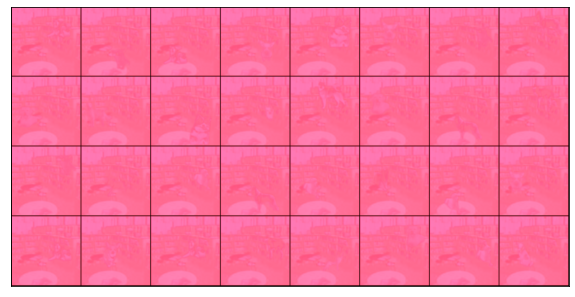

 12%|█▎        | 2/16 [00:05<00:44,  3.15s/it]

  loss: 0.9180759191513062


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 0.9506107568740845


 25%|██▌       | 4/16 [00:08<00:28,  2.40s/it]

  loss: 0.9360536336898804


 31%|███▏      | 5/16 [00:10<00:23,  2.18s/it]

  loss: 0.9432411193847656


 38%|███▊      | 6/16 [00:11<00:20,  2.03s/it]

  loss: 0.9399962425231934


 44%|████▍     | 7/16 [00:13<00:17,  1.92s/it]

  loss: 0.93967205286026


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.9282068014144897


 56%|█████▋    | 9/16 [00:16<00:12,  1.80s/it]

  loss: 0.9196522235870361


 62%|██████▎   | 10/16 [00:18<00:10,  1.77s/it]

  loss: 0.9573467969894409


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.9401698112487793


 75%|███████▌  | 12/16 [00:21<00:06,  1.73s/it]

  loss: 0.9611142873764038


 81%|████████▏ | 13/16 [00:23<00:05,  1.72s/it]

  loss: 0.939483642578125


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 0.9157995581626892


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.9835361242294312


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8936281204223633
Training Epoch: 13
  loss: 0.9300744533538818
Train Epoch: 13  [0/500  (0%)]	Loss:0.930074


Actual mask


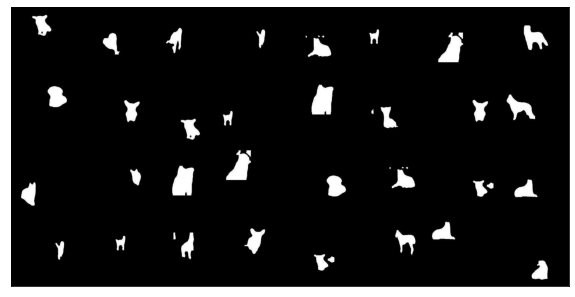

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


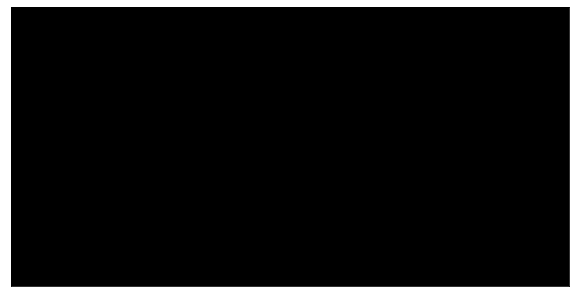



Actual Depth


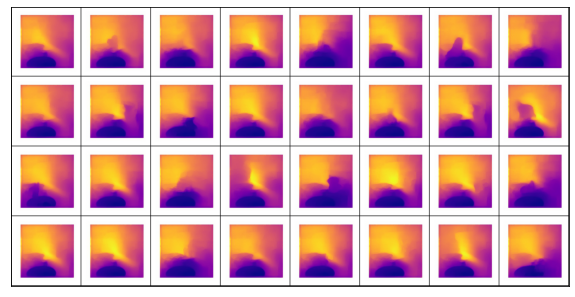

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


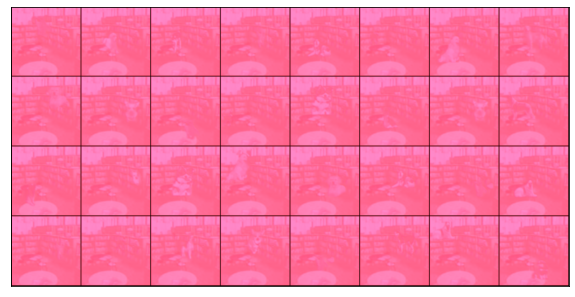

 12%|█▎        | 2/16 [00:05<00:46,  3.34s/it]

  loss: 0.9402416944503784


 19%|█▉        | 3/16 [00:07<00:37,  2.85s/it]

  loss: 0.9363071918487549


 25%|██▌       | 4/16 [00:08<00:30,  2.50s/it]

  loss: 0.9319885969161987


 31%|███▏      | 5/16 [00:10<00:24,  2.26s/it]

  loss: 0.9477404356002808


 38%|███▊      | 6/16 [00:12<00:20,  2.09s/it]

  loss: 0.9037512540817261


 44%|████▍     | 7/16 [00:13<00:17,  1.96s/it]

  loss: 0.9502546787261963


 50%|█████     | 8/16 [00:15<00:15,  1.88s/it]

  loss: 0.8772964477539062


 56%|█████▋    | 9/16 [00:17<00:12,  1.82s/it]

  loss: 0.9637503623962402


 62%|██████▎   | 10/16 [00:19<00:10,  1.78s/it]

  loss: 0.9293326735496521


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.9359087944030762


 75%|███████▌  | 12/16 [00:22<00:06,  1.73s/it]

  loss: 0.9201751947402954


 81%|████████▏ | 13/16 [00:24<00:05,  1.72s/it]

  loss: 0.9408717155456543


 88%|████████▊ | 14/16 [00:25<00:03,  1.71s/it]

  loss: 0.9564881324768066


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.9442796111106873


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9138171672821045
Training Epoch: 14
  loss: 0.947704017162323
Train Epoch: 14  [0/500  (0%)]	Loss:0.947704


Actual mask


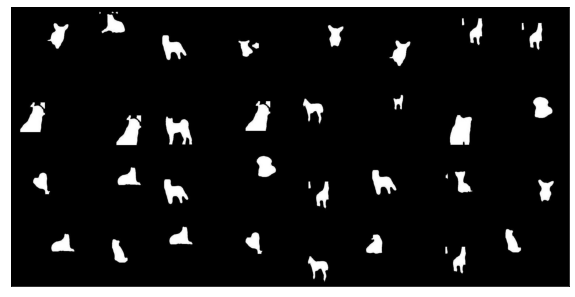

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


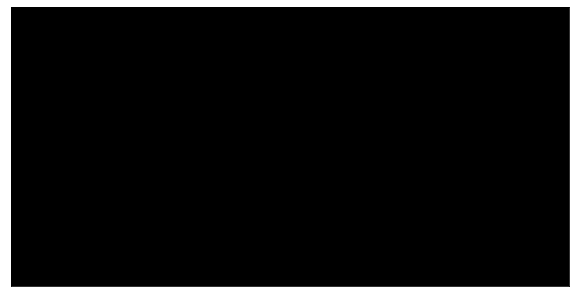



Actual Depth


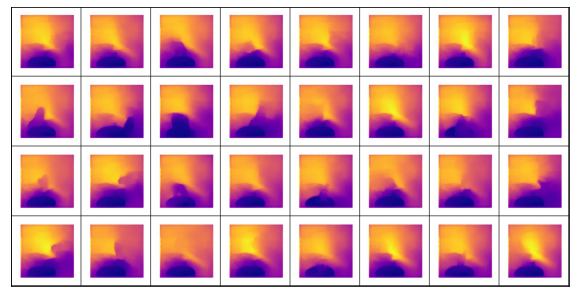

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


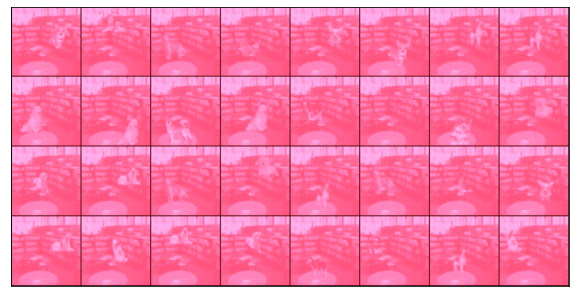

 12%|█▎        | 2/16 [00:05<00:45,  3.25s/it]

  loss: 0.939285159111023


 19%|█▉        | 3/16 [00:07<00:36,  2.79s/it]

  loss: 0.9127886891365051


 25%|██▌       | 4/16 [00:08<00:29,  2.46s/it]

  loss: 0.9382089376449585


 31%|███▏      | 5/16 [00:10<00:24,  2.23s/it]

  loss: 0.9334557056427002


 38%|███▊      | 6/16 [00:12<00:20,  2.07s/it]

  loss: 0.9469790458679199


 44%|████▍     | 7/16 [00:13<00:17,  1.95s/it]

  loss: 0.9351616501808167


 50%|█████     | 8/16 [00:15<00:14,  1.87s/it]

  loss: 0.9175970554351807


 56%|█████▋    | 9/16 [00:17<00:12,  1.82s/it]

  loss: 0.9192814826965332


 62%|██████▎   | 10/16 [00:18<00:10,  1.78s/it]

  loss: 0.9068421125411987


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.8862079381942749


 75%|███████▌  | 12/16 [00:22<00:06,  1.72s/it]

  loss: 0.9055272340774536


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.9340392351150513


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8916037082672119


 94%|█████████▍| 15/16 [00:27<00:01,  1.67s/it]

  loss: 0.9394428730010986


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9127427339553833
Training Epoch: 15
  loss: 0.8857812881469727
Train Epoch: 15  [0/500  (0%)]	Loss:0.885781


Actual mask


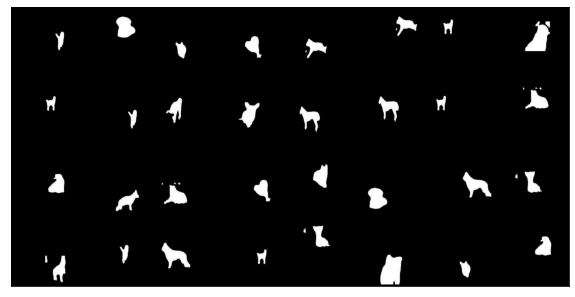

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


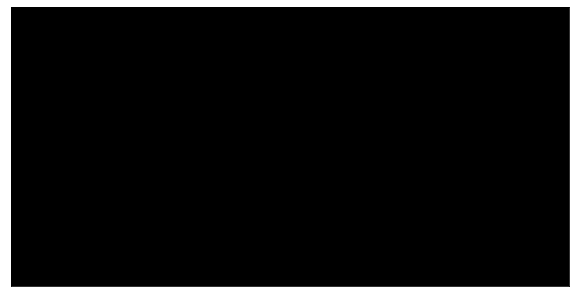



Actual Depth


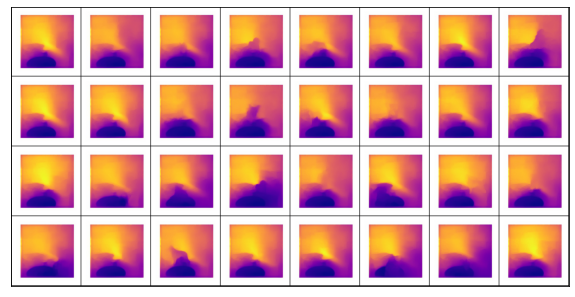

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


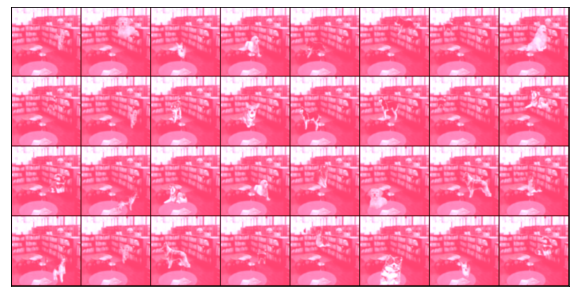

 12%|█▎        | 2/16 [00:05<00:44,  3.21s/it]

  loss: 0.9294435977935791


 19%|█▉        | 3/16 [00:06<00:35,  2.74s/it]

  loss: 0.9111818671226501


 25%|██▌       | 4/16 [00:08<00:28,  2.42s/it]

  loss: 0.9308014512062073


 31%|███▏      | 5/16 [00:10<00:24,  2.18s/it]

  loss: 0.9062995314598083


 38%|███▊      | 6/16 [00:11<00:20,  2.03s/it]

  loss: 0.9191591143608093


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.9331074357032776


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.9015519022941589


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9013651609420776


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.909072995185852


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.9148402810096741


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9066596031188965


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9113039970397949


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.9184560775756836


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.909407913684845


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9076939225196838
Training Epoch: 16
  loss: 0.8991882801055908
Train Epoch: 16  [0/500  (0%)]	Loss:0.899188


Actual mask


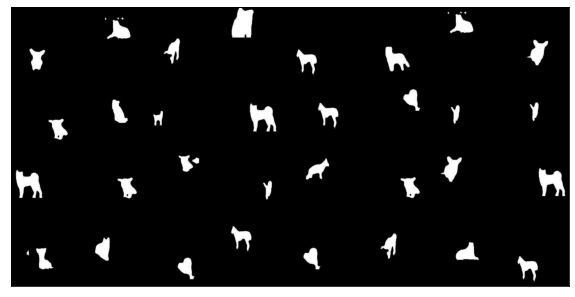

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


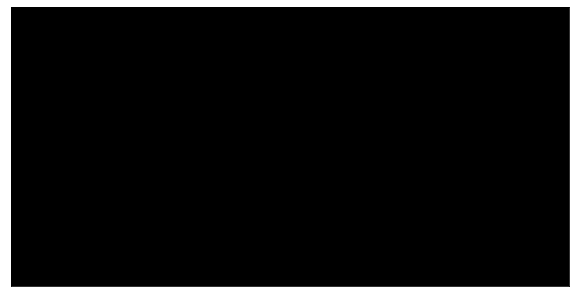



Actual Depth


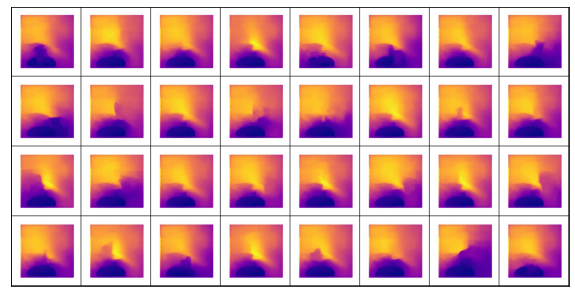

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


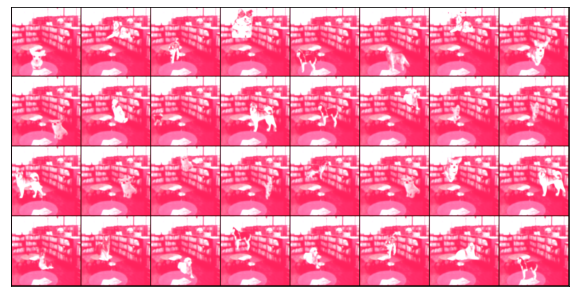

 12%|█▎        | 2/16 [00:05<00:43,  3.13s/it]

  loss: 0.9033764600753784


 19%|█▉        | 3/16 [00:06<00:34,  2.69s/it]

  loss: 0.9019120335578918


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.9235612154006958


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.9267210960388184


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8759829998016357


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8961848020553589


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8709192872047424


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9052023887634277


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9089144468307495


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8748189210891724


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9386410117149353


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9002211689949036


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.9125393033027649


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.9126708507537842


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.928727388381958
Training Epoch: 17
  loss: 0.9286980628967285
Train Epoch: 17  [0/500  (0%)]	Loss:0.928698


Actual mask


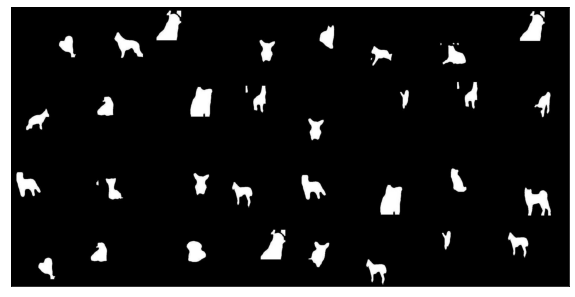

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


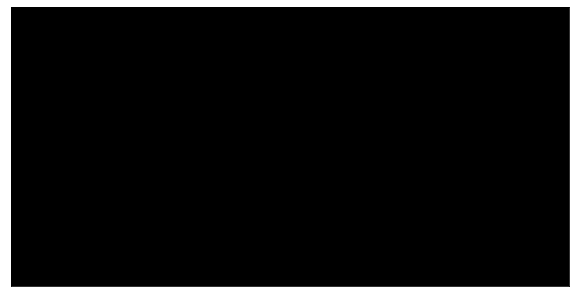



Actual Depth


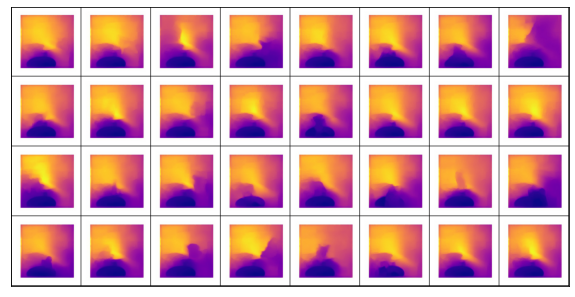

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


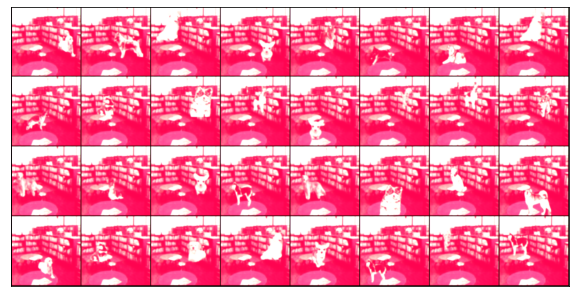

 12%|█▎        | 2/16 [00:05<00:44,  3.16s/it]

  loss: 0.9092121720314026


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 0.9076255559921265


 25%|██▌       | 4/16 [00:08<00:28,  2.40s/it]

  loss: 0.9158756136894226


 31%|███▏      | 5/16 [00:10<00:23,  2.18s/it]

  loss: 0.8970563411712646


 38%|███▊      | 6/16 [00:11<00:20,  2.02s/it]

  loss: 0.9132266044616699


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.906480073928833


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8815911412239075


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8935208320617676


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.9140370488166809


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8690365552902222


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8902850151062012


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9124794602394104


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8998119831085205


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8771027326583862


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8773559331893921
Training Epoch: 18
  loss: 0.8847311735153198
Train Epoch: 18  [0/500  (0%)]	Loss:0.884731


Actual mask


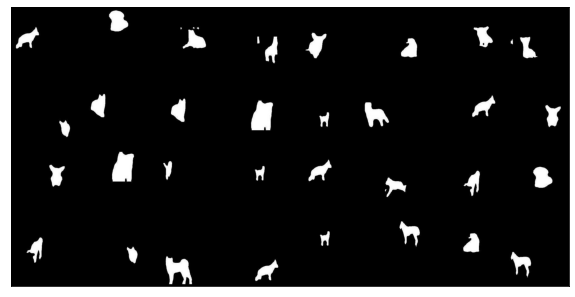

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


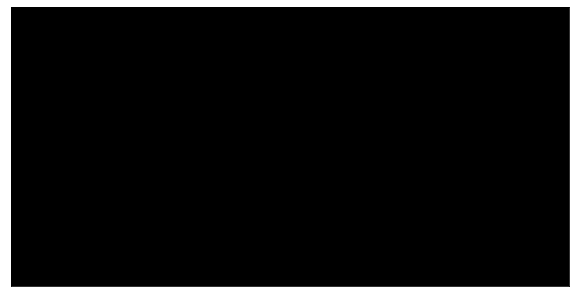



Actual Depth


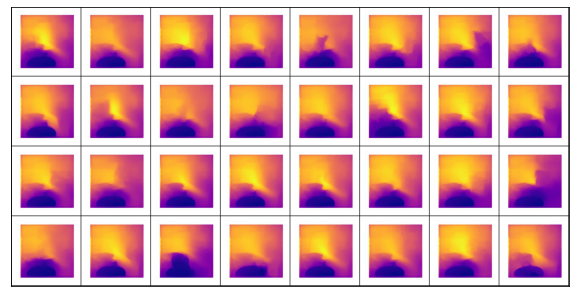

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


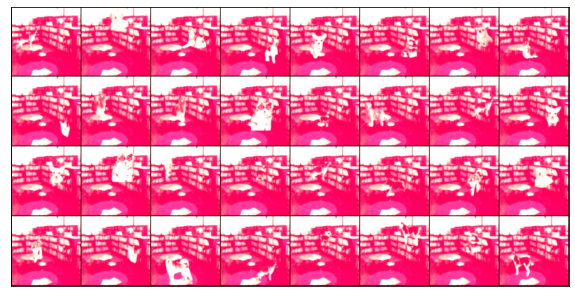

 12%|█▎        | 2/16 [00:05<00:43,  3.14s/it]

  loss: 0.8803145885467529


 19%|█▉        | 3/16 [00:06<00:35,  2.69s/it]

  loss: 0.8921664357185364


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.9224531054496765


 31%|███▏      | 5/16 [00:10<00:23,  2.17s/it]

  loss: 0.9197225570678711


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.9109382629394531


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8754485249519348


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8912163972854614


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9030498266220093


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9166791439056396


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.895033597946167


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9103387594223022


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9166015386581421


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8886486291885376


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8624523878097534


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8714556694030762
Training Epoch: 19
  loss: 0.8976660966873169
Train Epoch: 19  [0/500  (0%)]	Loss:0.897666


Actual mask


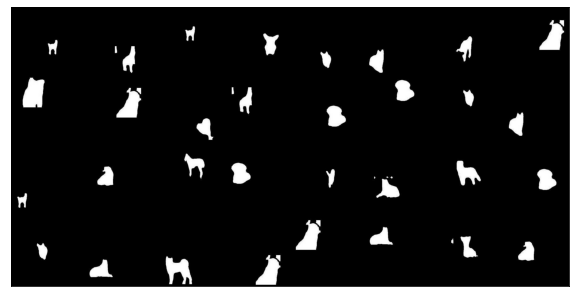

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


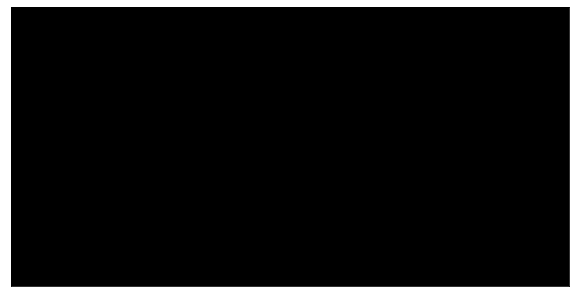



Actual Depth


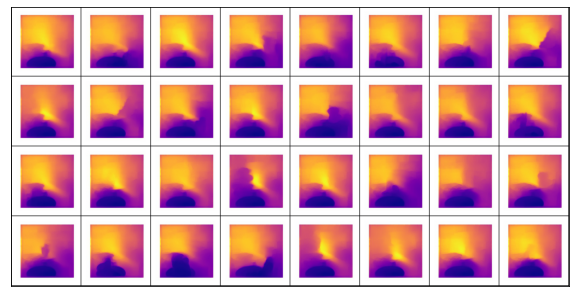

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


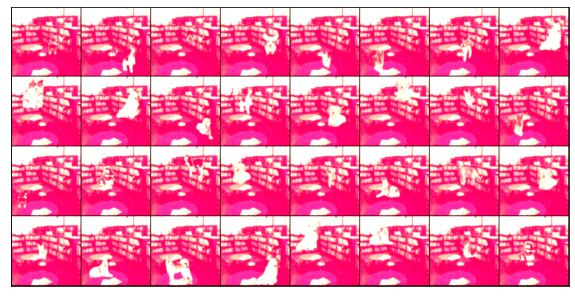

 12%|█▎        | 2/16 [00:05<00:43,  3.12s/it]

  loss: 0.8892508149147034


 19%|█▉        | 3/16 [00:06<00:34,  2.68s/it]

  loss: 0.8940818309783936


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.8973278999328613


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.8651029467582703


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8846814632415771


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9051371812820435


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8885680437088013


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.9173324108123779


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9088853001594543


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.899308443069458


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.905789852142334


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.89668869972229


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.8632110357284546


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8908477425575256


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8943496942520142
Training Epoch: 20
  loss: 0.9329791069030762
Train Epoch: 20  [0/500  (0%)]	Loss:0.932979


Actual mask


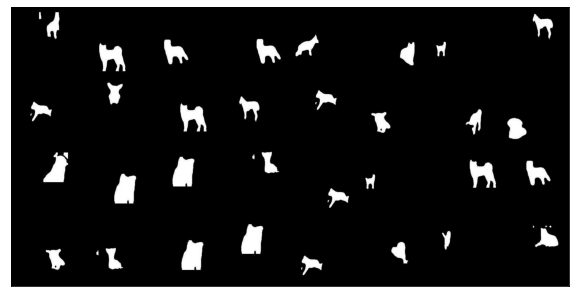

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


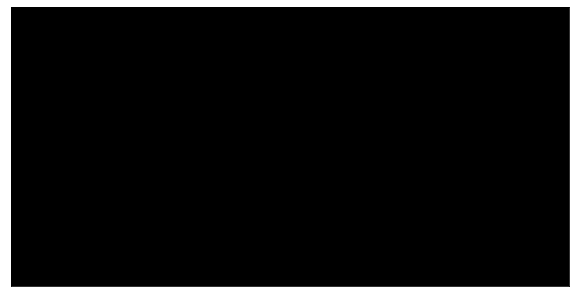



Actual Depth


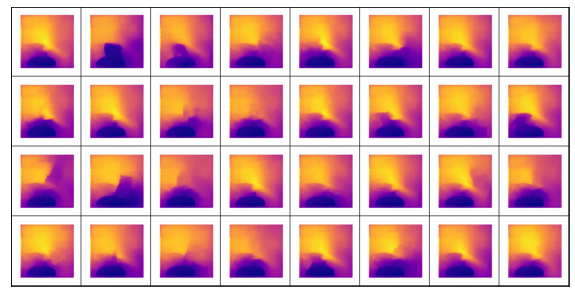

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


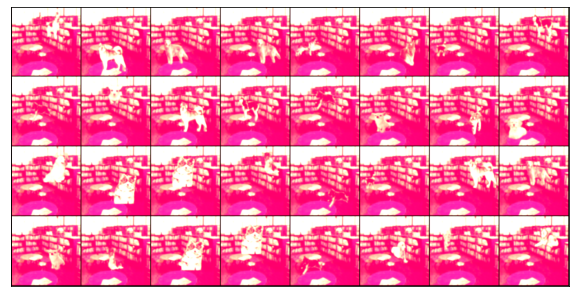

  6%|▋         | 1/16 [00:04<01:00,  4.00s/it]

  loss: 0.904693603515625
Train Epoch: 20  [3/500  (6%)]	Loss:0.904694


Actual mask


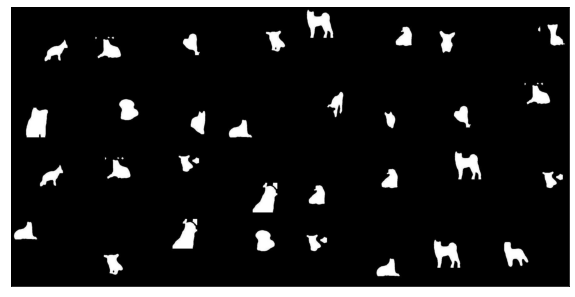

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


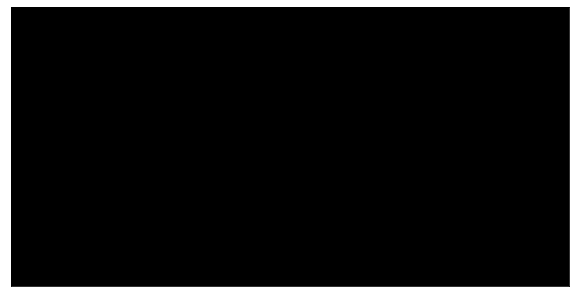



Actual Depth


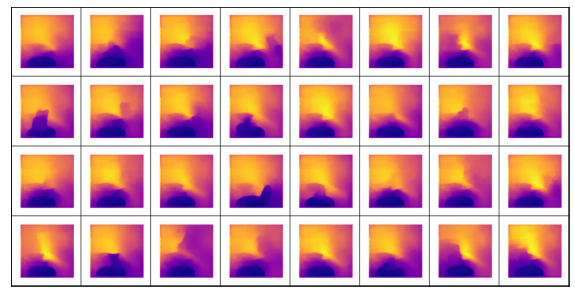

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


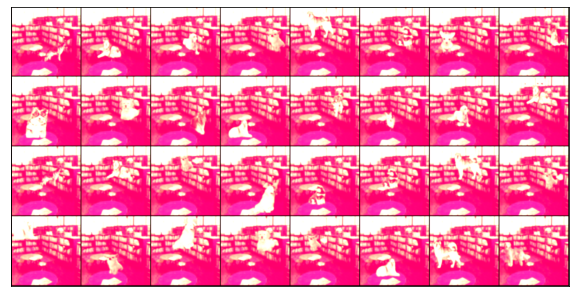

 12%|█▎        | 2/16 [00:07<00:55,  3.98s/it]

  loss: 0.8918938636779785
Train Epoch: 20  [6/500  (12%)]	Loss:0.891894


Actual mask


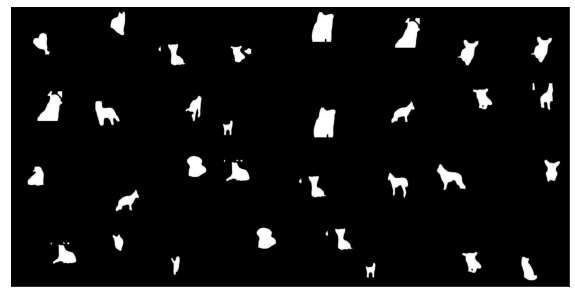

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


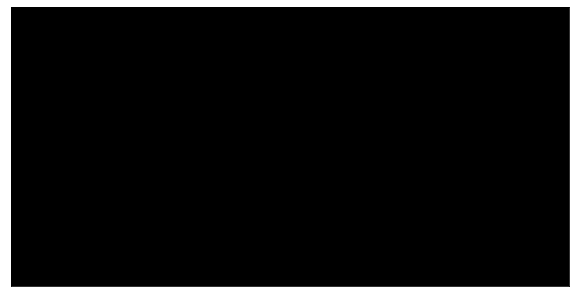



Actual Depth


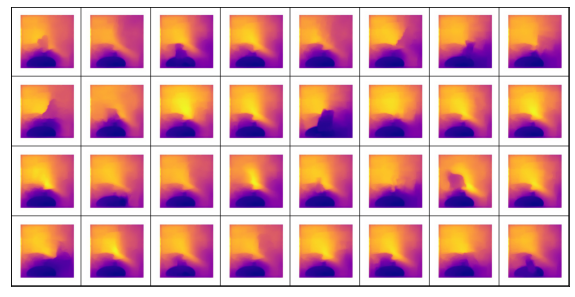

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


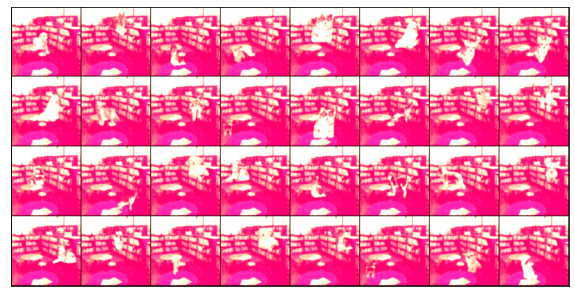

 19%|█▉        | 3/16 [00:11<00:51,  4.00s/it]

  loss: 0.9009925127029419
Train Epoch: 20  [9/500  (19%)]	Loss:0.900993


Actual mask


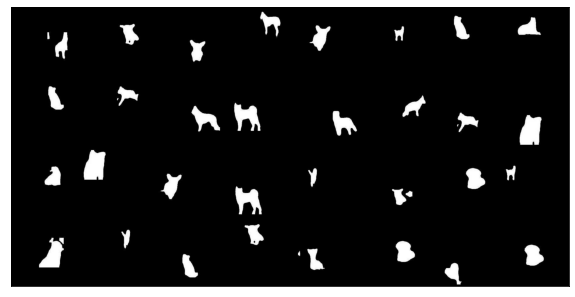

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


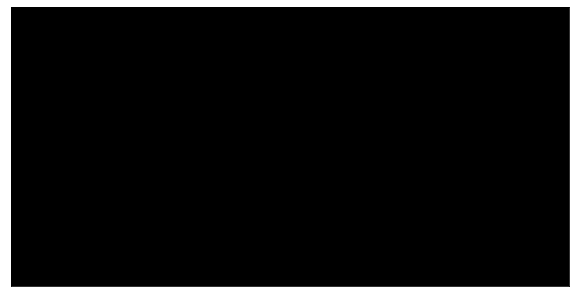



Actual Depth


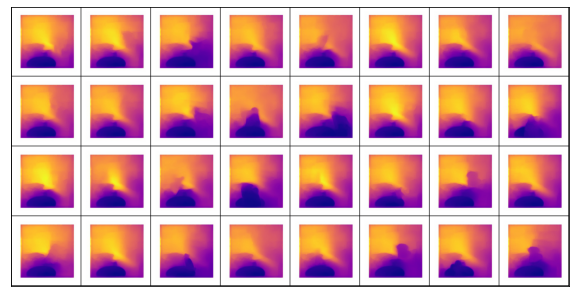

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


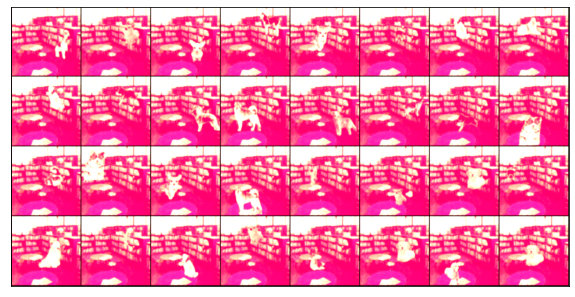

 25%|██▌       | 4/16 [00:15<00:47,  3.98s/it]

  loss: 0.8843913078308105
Train Epoch: 20  [12/500  (25%)]	Loss:0.884391


Actual mask


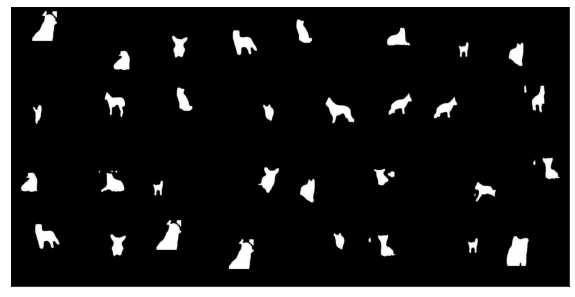

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


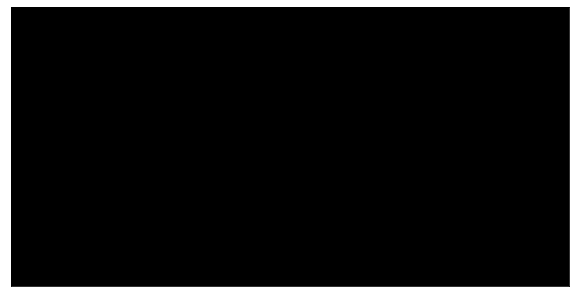



Actual Depth


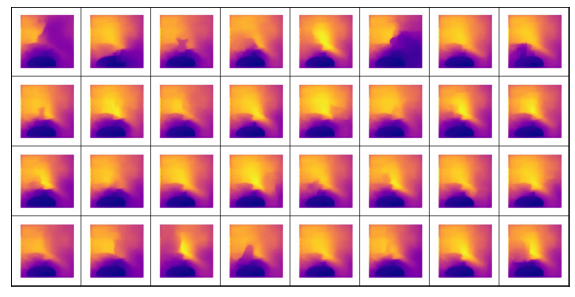

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


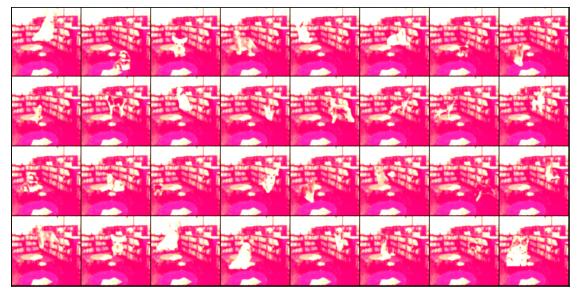

 31%|███▏      | 5/16 [00:19<00:43,  3.96s/it]

  loss: 0.8899663090705872
Train Epoch: 20  [15/500  (31%)]	Loss:0.889966


Actual mask


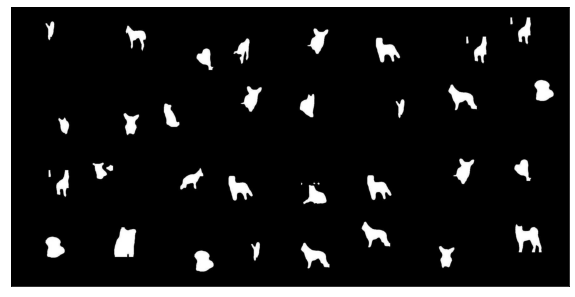

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


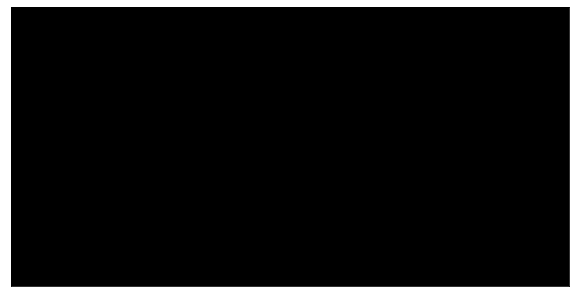



Actual Depth


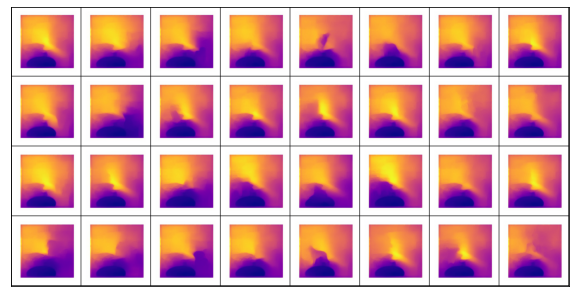

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


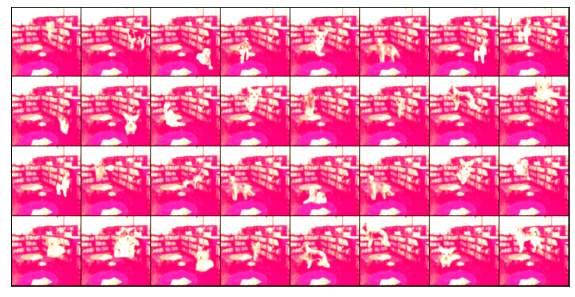

 38%|███▊      | 6/16 [00:23<00:39,  3.96s/it]

  loss: 0.8921253681182861
Train Epoch: 20  [18/500  (38%)]	Loss:0.892125


Actual mask


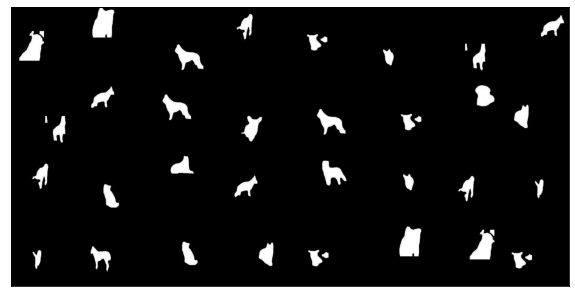

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


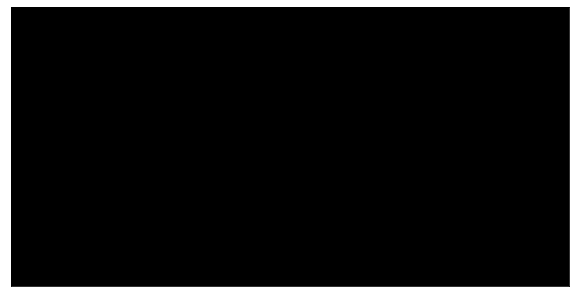



Actual Depth


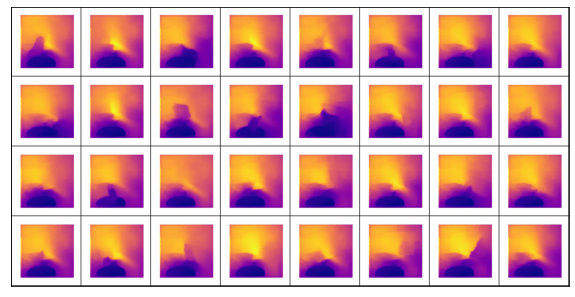

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


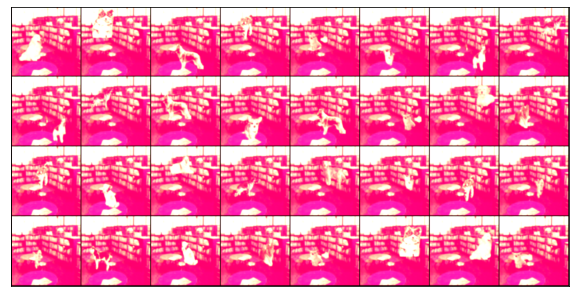

 44%|████▍     | 7/16 [00:27<00:35,  3.96s/it]

  loss: 0.8663227558135986
Train Epoch: 20  [21/500  (44%)]	Loss:0.866323


Actual mask


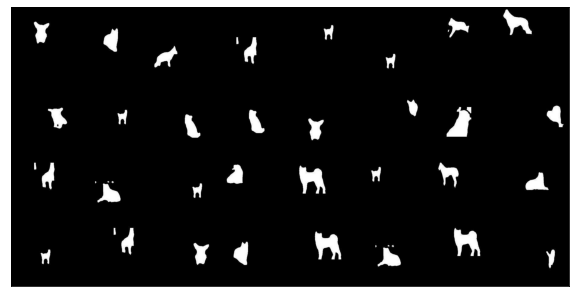

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


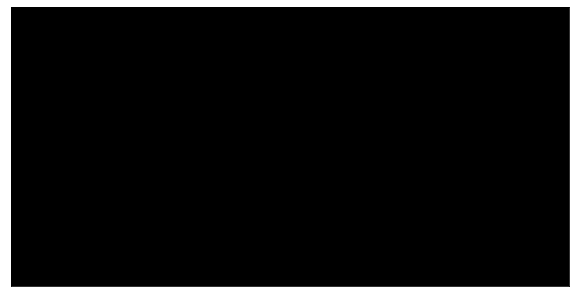



Actual Depth


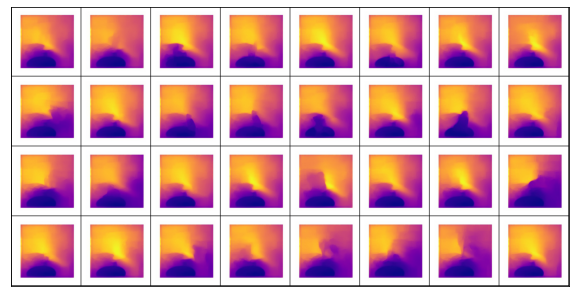

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


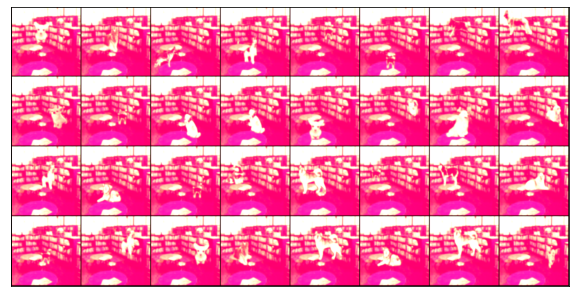

 50%|█████     | 8/16 [00:31<00:31,  3.97s/it]

  loss: 0.9078149795532227
Train Epoch: 20  [24/500  (50%)]	Loss:0.907815


Actual mask


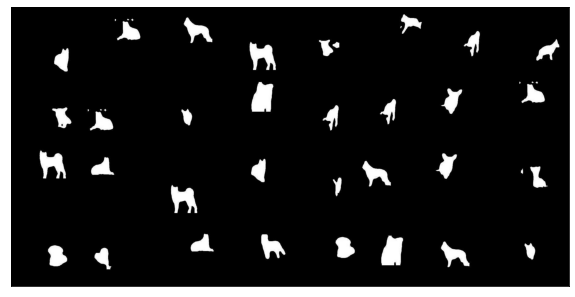

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


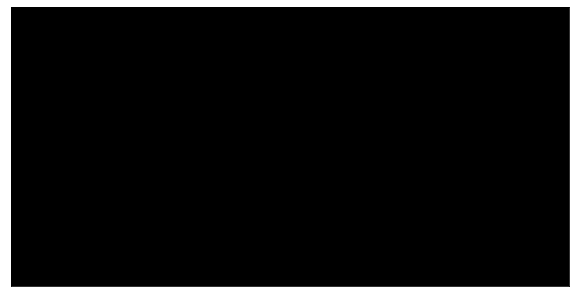



Actual Depth


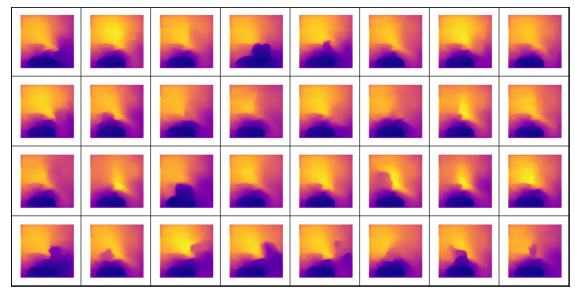

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


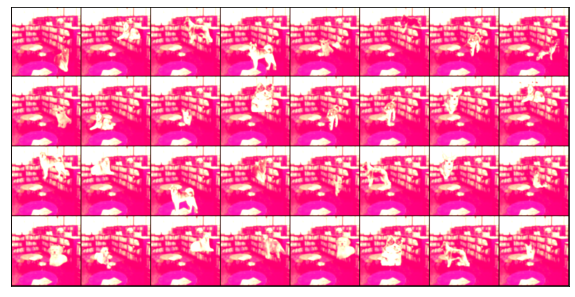

 56%|█████▋    | 9/16 [00:35<00:28,  4.01s/it]

  loss: 0.8861936330795288
Train Epoch: 20  [27/500  (56%)]	Loss:0.886194


Actual mask


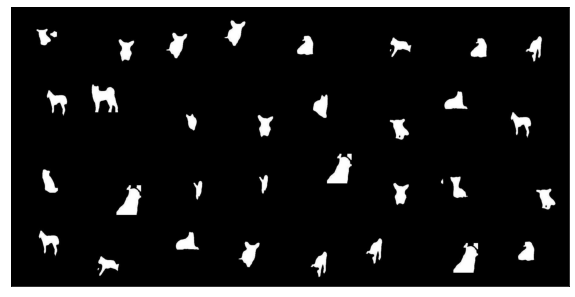

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


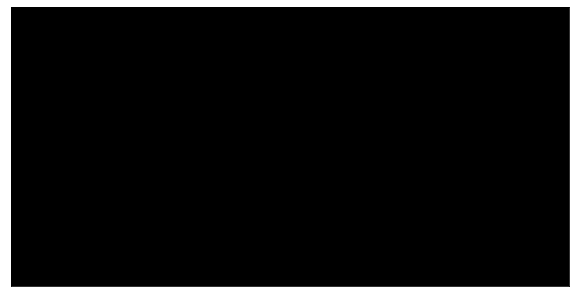



Actual Depth


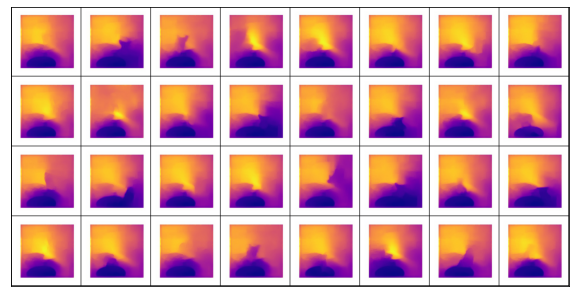

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


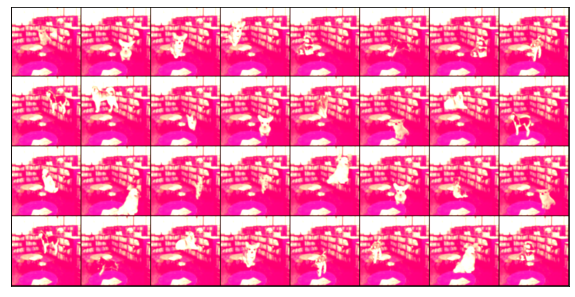

 62%|██████▎   | 10/16 [00:39<00:23,  3.99s/it]

  loss: 0.8747122287750244
Train Epoch: 20  [30/500  (62%)]	Loss:0.874712


Actual mask


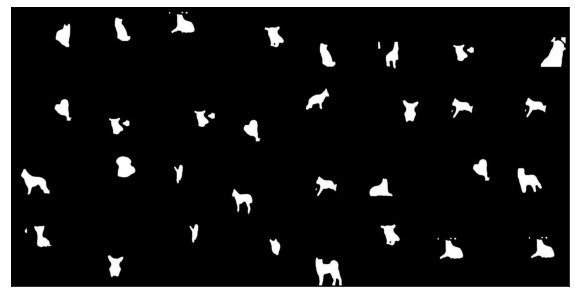

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


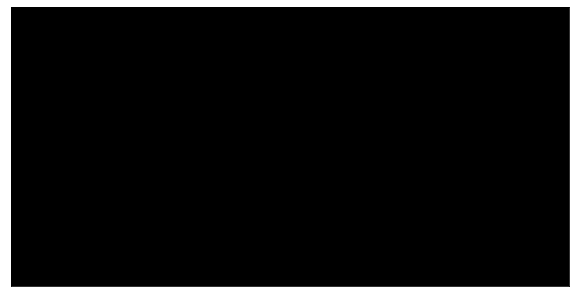



Actual Depth


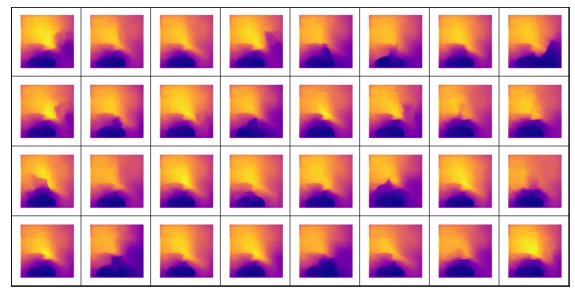

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


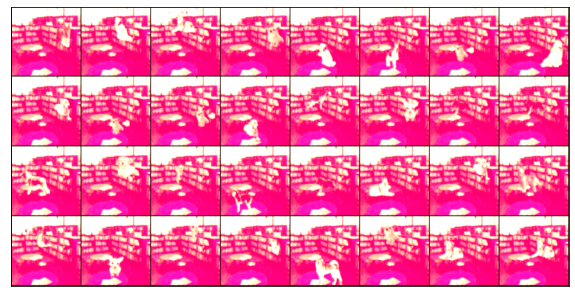

 69%|██████▉   | 11/16 [00:43<00:19,  3.97s/it]

  loss: 0.8773483037948608
Train Epoch: 20  [33/500  (69%)]	Loss:0.877348


Actual mask


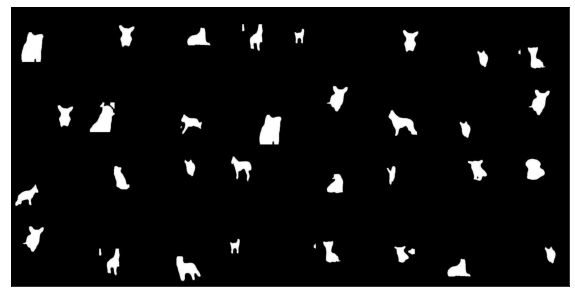

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


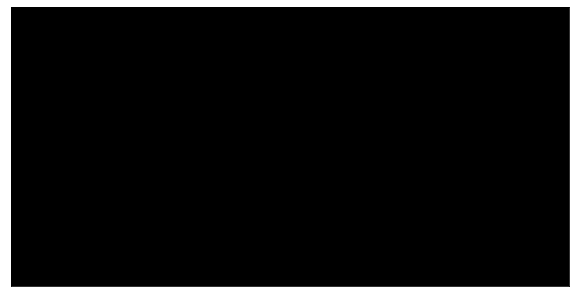



Actual Depth


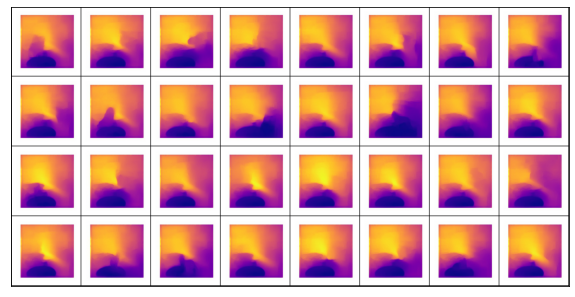

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


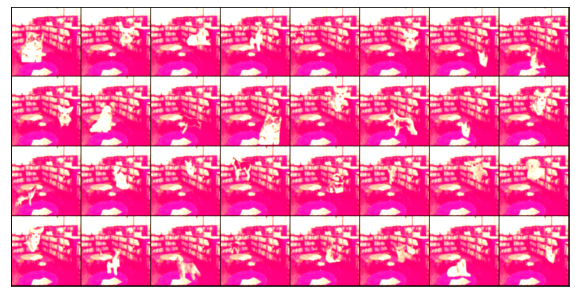

 75%|███████▌  | 12/16 [00:47<00:15,  3.98s/it]

  loss: 0.9165788888931274
Train Epoch: 20  [36/500  (75%)]	Loss:0.916579


Actual mask


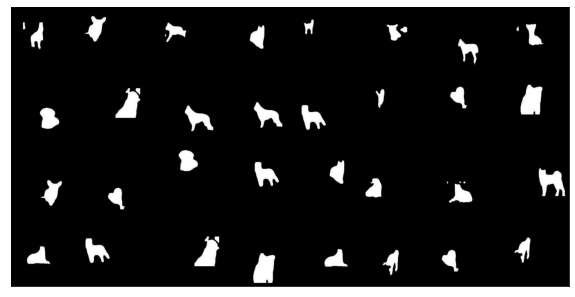

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


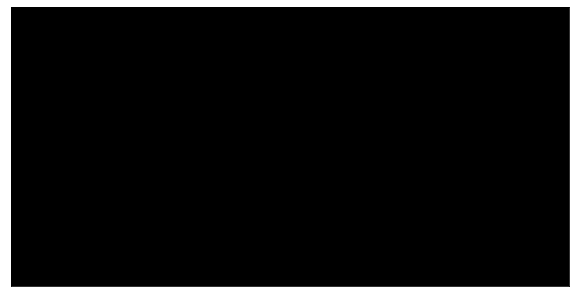



Actual Depth


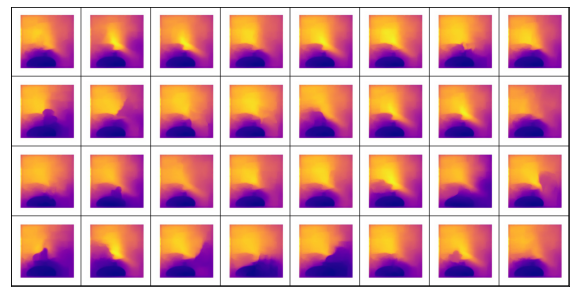

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


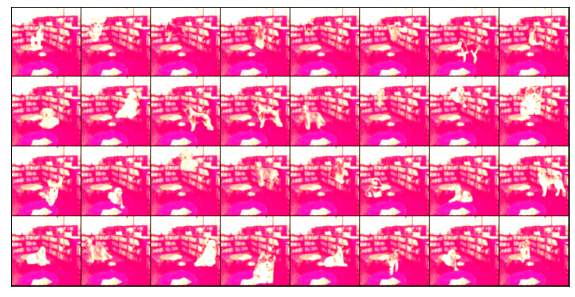

 81%|████████▏ | 13/16 [00:51<00:11,  3.98s/it]

  loss: 0.8786240816116333
Train Epoch: 20  [39/500  (81%)]	Loss:0.878624


Actual mask


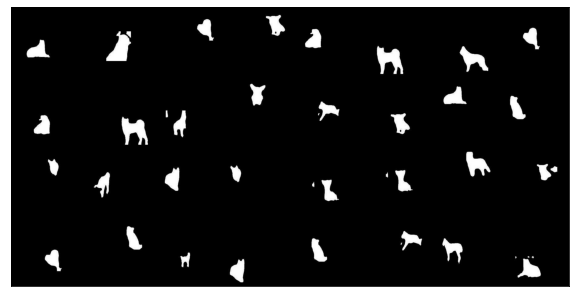

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


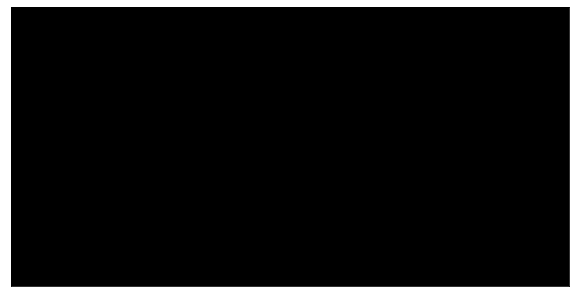



Actual Depth


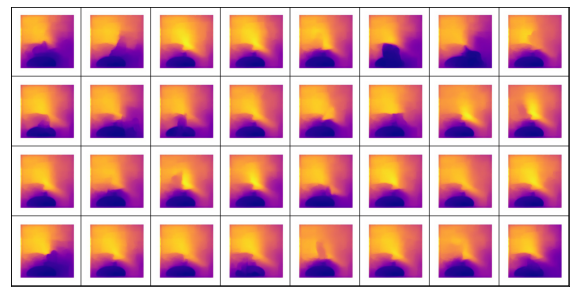

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


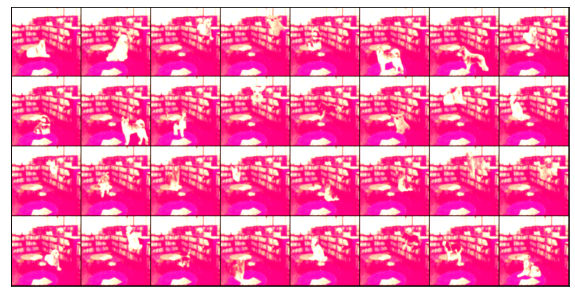

 88%|████████▊ | 14/16 [00:55<00:07,  3.97s/it]

  loss: 0.8784210681915283
Train Epoch: 20  [42/500  (88%)]	Loss:0.878421


Actual mask


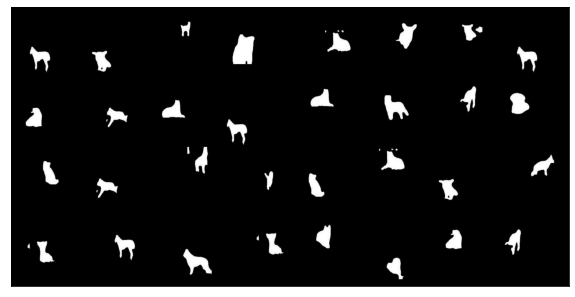

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


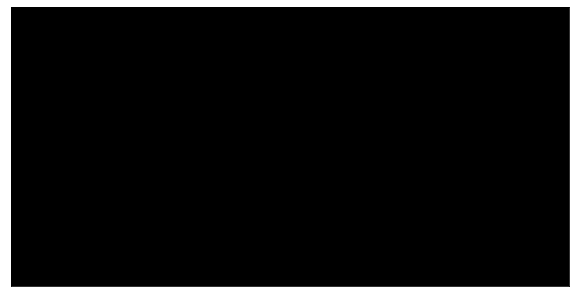



Actual Depth


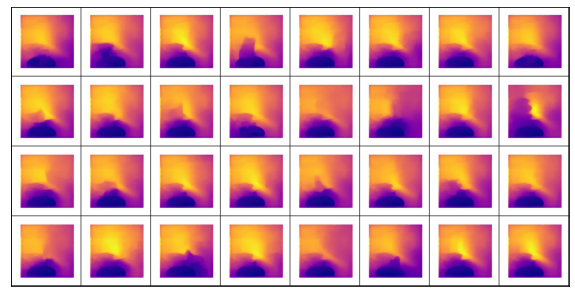

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


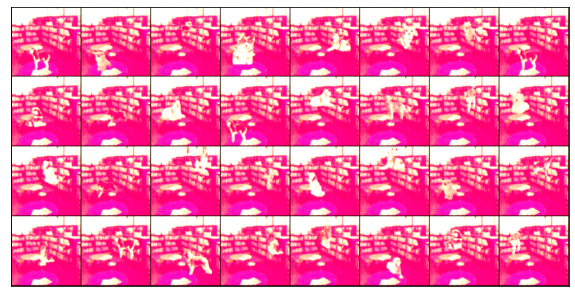

 94%|█████████▍| 15/16 [00:59<00:03,  3.97s/it]

  loss: 0.8563172817230225
Train Epoch: 20  [45/500  (94%)]	Loss:0.856317


Actual mask


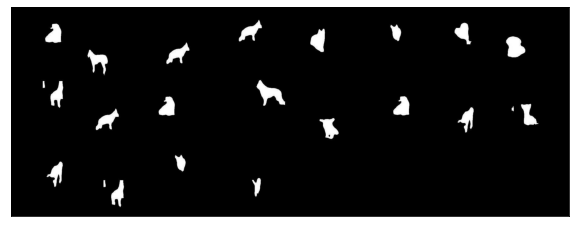

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


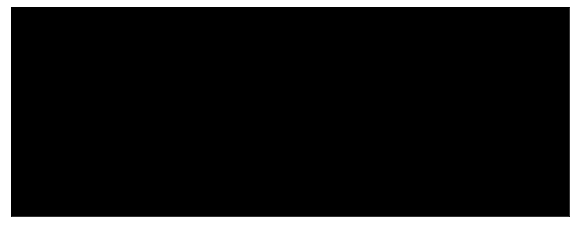



Actual Depth


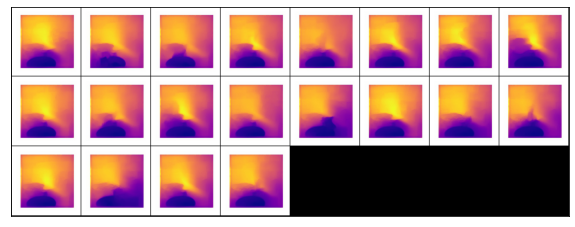

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


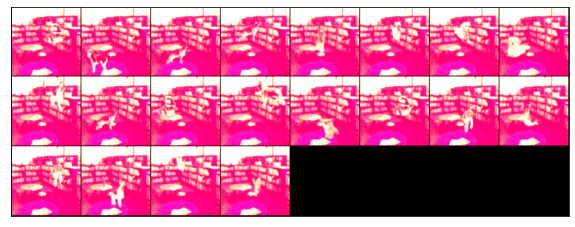

  0%|          | 0/16 [00:00<?, ?it/s]

Training Epoch: 21
  loss: 0.8637659549713135
Train Epoch: 21  [0/500  (0%)]	Loss:0.863766


Actual mask


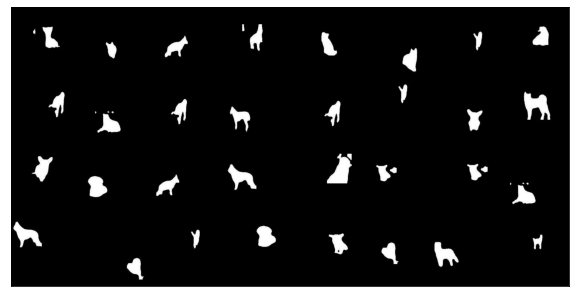

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


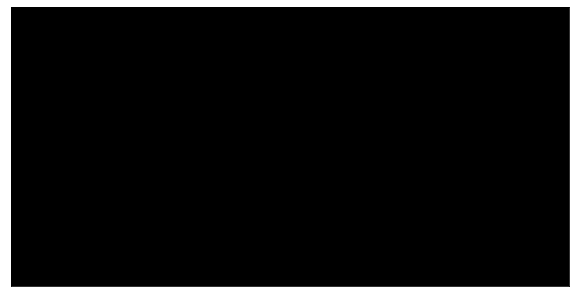



Actual Depth


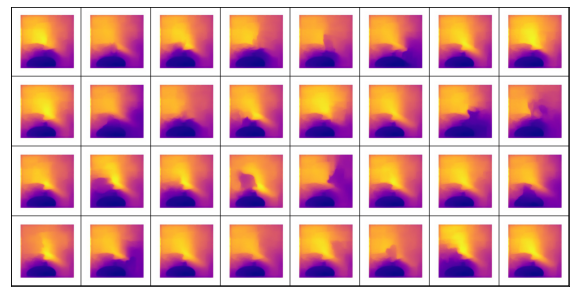

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


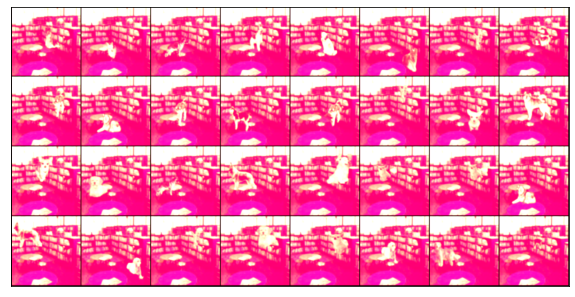

 12%|█▎        | 2/16 [00:04<00:42,  3.03s/it]

  loss: 0.8675313591957092


 19%|█▉        | 3/16 [00:06<00:34,  2.64s/it]

  loss: 0.9129635095596313


 25%|██▌       | 4/16 [00:08<00:28,  2.35s/it]

  loss: 0.9072633981704712


 31%|███▏      | 5/16 [00:10<00:23,  2.15s/it]

  loss: 0.899432897567749


 38%|███▊      | 6/16 [00:11<00:20,  2.00s/it]

  loss: 0.8934199213981628


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.9014008641242981


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8653823733329773


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8986655473709106


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.8624322414398193


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8876227140426636


 75%|███████▌  | 12/16 [00:21<00:06,  1.71s/it]

  loss: 0.9021523594856262


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.9136009216308594


 88%|████████▊ | 14/16 [00:25<00:03,  1.69s/it]

  loss: 0.8852088451385498


 94%|█████████▍| 15/16 [00:26<00:01,  1.68s/it]

  loss: 0.8770194053649902


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8701735734939575
Training Epoch: 22
  loss: 0.8936120271682739
Train Epoch: 22  [0/500  (0%)]	Loss:0.893612


Actual mask


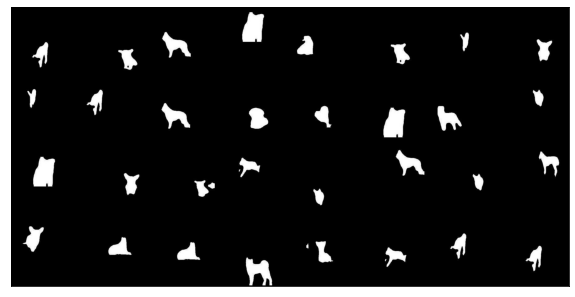

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


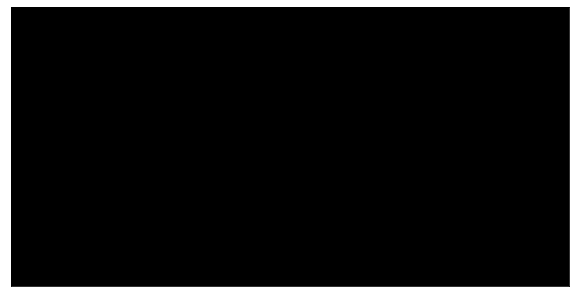



Actual Depth


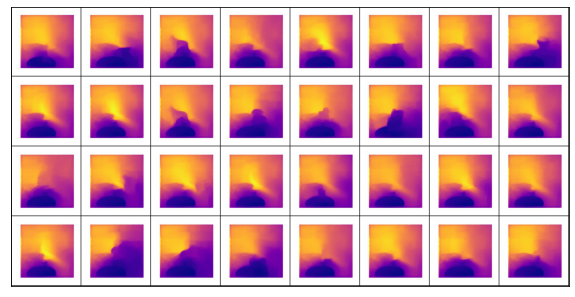

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


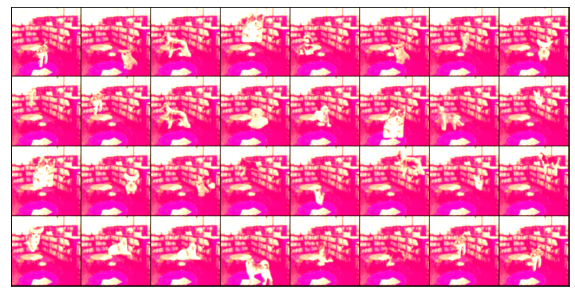

 12%|█▎        | 2/16 [00:05<00:43,  3.14s/it]

  loss: 0.8877617120742798


 19%|█▉        | 3/16 [00:06<00:35,  2.70s/it]

  loss: 0.9065173268318176


 25%|██▌       | 4/16 [00:08<00:28,  2.40s/it]

  loss: 0.8751393556594849


 31%|███▏      | 5/16 [00:10<00:23,  2.18s/it]

  loss: 0.8862029910087585


 38%|███▊      | 6/16 [00:11<00:20,  2.03s/it]

  loss: 0.8937200307846069


 44%|████▍     | 7/16 [00:13<00:17,  1.92s/it]

  loss: 0.852666974067688


 50%|█████     | 8/16 [00:15<00:14,  1.85s/it]

  loss: 0.876659631729126


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8648838996887207


 62%|██████▎   | 10/16 [00:18<00:10,  1.76s/it]

  loss: 0.9008517265319824


 69%|██████▉   | 11/16 [00:20<00:08,  1.73s/it]

  loss: 0.916658878326416


 75%|███████▌  | 12/16 [00:21<00:06,  1.72s/it]

  loss: 0.8980674743652344


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.8862981200218201


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 0.8731101155281067


 94%|█████████▍| 15/16 [00:26<00:01,  1.70s/it]

  loss: 0.8856735229492188


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8740528225898743
Training Epoch: 23
  loss: 0.8801102638244629
Train Epoch: 23  [0/500  (0%)]	Loss:0.880110


Actual mask


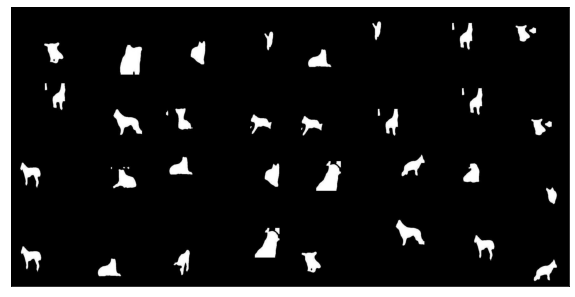

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


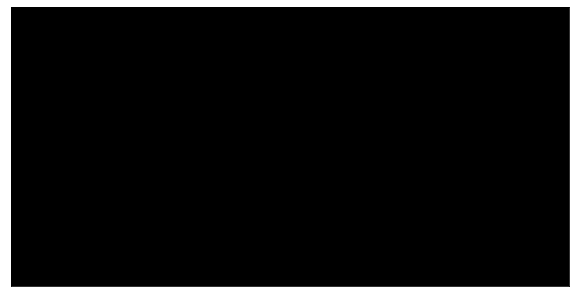



Actual Depth


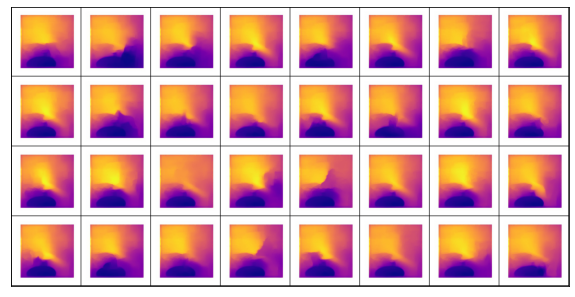

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


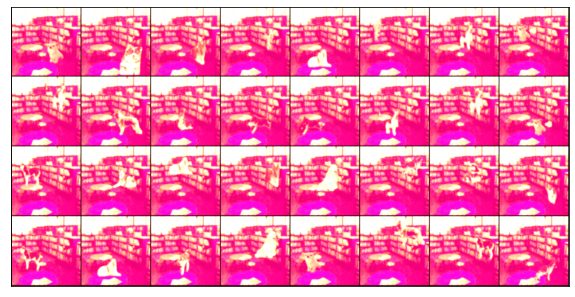

 12%|█▎        | 2/16 [00:05<00:46,  3.35s/it]

  loss: 0.8700856566429138


 19%|█▉        | 3/16 [00:07<00:37,  2.89s/it]

  loss: 0.8723210096359253


 25%|██▌       | 4/16 [00:09<00:30,  2.51s/it]

  loss: 0.8959027528762817


 31%|███▏      | 5/16 [00:10<00:24,  2.27s/it]

  loss: 0.8901458978652954


 38%|███▊      | 6/16 [00:12<00:20,  2.09s/it]

  loss: 0.8944278955459595


 44%|████▍     | 7/16 [00:14<00:17,  1.97s/it]

  loss: 0.8994008898735046


 50%|█████     | 8/16 [00:15<00:15,  1.88s/it]

  loss: 0.8750349283218384


 56%|█████▋    | 9/16 [00:17<00:12,  1.83s/it]

  loss: 0.8767794966697693


 62%|██████▎   | 10/16 [00:19<00:10,  1.78s/it]

  loss: 0.8896872401237488


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.8849329948425293


 75%|███████▌  | 12/16 [00:22<00:06,  1.73s/it]

  loss: 0.8710644245147705


 81%|████████▏ | 13/16 [00:24<00:05,  1.72s/it]

  loss: 0.8659895658493042


 88%|████████▊ | 14/16 [00:25<00:03,  1.71s/it]

  loss: 0.9153863191604614


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.8837835788726807


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8754290342330933
Training Epoch: 24
  loss: 0.8671343326568604
Train Epoch: 24  [0/500  (0%)]	Loss:0.867134


Actual mask


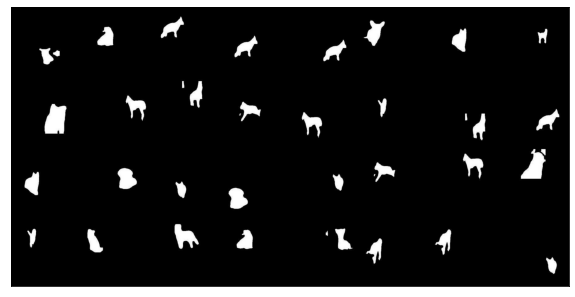

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


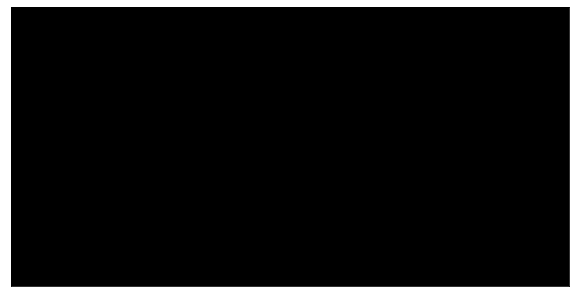



Actual Depth


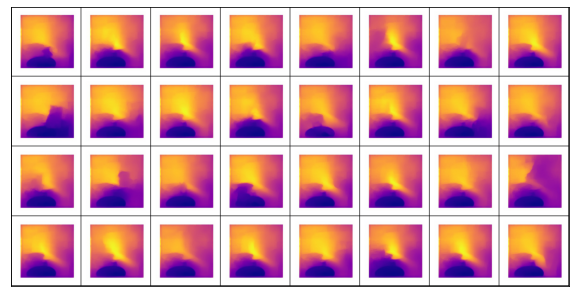

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


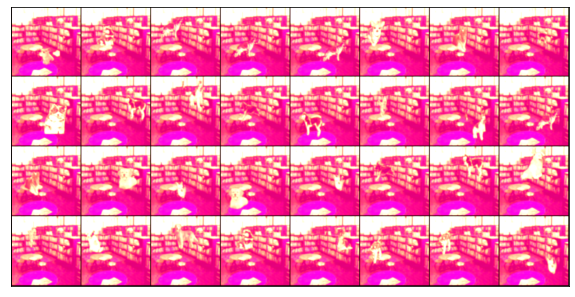

 12%|█▎        | 2/16 [00:05<00:45,  3.28s/it]

  loss: 0.883681058883667


 19%|█▉        | 3/16 [00:07<00:36,  2.81s/it]

  loss: 0.8764215111732483


 25%|██▌       | 4/16 [00:08<00:29,  2.47s/it]

  loss: 0.9216896295547485


 31%|███▏      | 5/16 [00:10<00:24,  2.24s/it]

  loss: 0.8834716081619263


 38%|███▊      | 6/16 [00:12<00:20,  2.07s/it]

  loss: 0.8414112329483032


 44%|████▍     | 7/16 [00:13<00:17,  1.95s/it]

  loss: 0.9165869951248169


 50%|█████     | 8/16 [00:15<00:14,  1.87s/it]

  loss: 0.8820838928222656


 56%|█████▋    | 9/16 [00:17<00:12,  1.81s/it]

  loss: 0.8627899885177612


 62%|██████▎   | 10/16 [00:18<00:10,  1.77s/it]

  loss: 0.873140275478363


 69%|██████▉   | 11/16 [00:20<00:08,  1.74s/it]

  loss: 0.8884408473968506


 75%|███████▌  | 12/16 [00:22<00:06,  1.72s/it]

  loss: 0.8769502639770508


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.8832056522369385


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 0.8976228833198547


 94%|█████████▍| 15/16 [00:27<00:01,  1.69s/it]

  loss: 0.8684835433959961


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8921946287155151
Training Epoch: 25
  loss: 0.8633393049240112
Train Epoch: 25  [0/500  (0%)]	Loss:0.863339


Actual mask


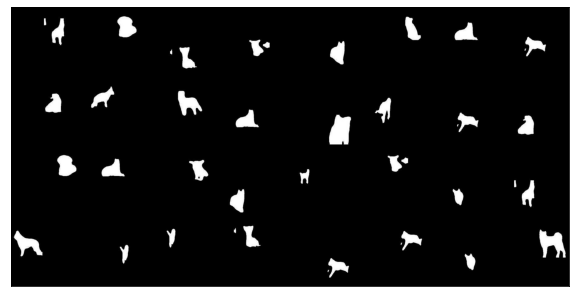

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


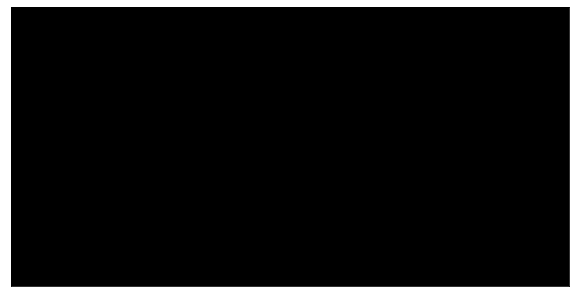



Actual Depth


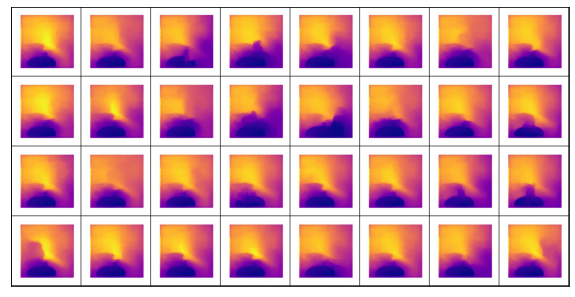

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


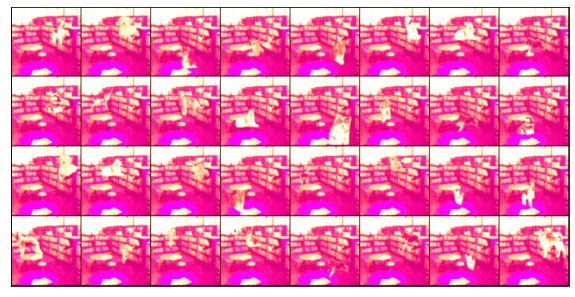

 12%|█▎        | 2/16 [00:05<00:44,  3.18s/it]

  loss: 0.8848199844360352


 19%|█▉        | 3/16 [00:06<00:35,  2.73s/it]

  loss: 0.8696750402450562


 25%|██▌       | 4/16 [00:08<00:28,  2.41s/it]

  loss: 0.8711498975753784


 31%|███▏      | 5/16 [00:10<00:23,  2.18s/it]

  loss: 0.8869593739509583


 38%|███▊      | 6/16 [00:11<00:20,  2.02s/it]

  loss: 0.9030271768569946


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8942565321922302


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8578653335571289


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8737884163856506


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.8754620552062988


 69%|██████▉   | 11/16 [00:20<00:08,  1.71s/it]

  loss: 0.8711453676223755


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8829507827758789


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.874187707901001


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.888775110244751


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8956433534622192


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8913050889968872
Training Epoch: 26
  loss: 0.8660837411880493
Train Epoch: 26  [0/500  (0%)]	Loss:0.866084


Actual mask


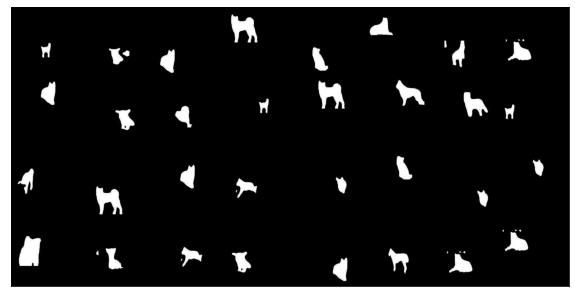

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


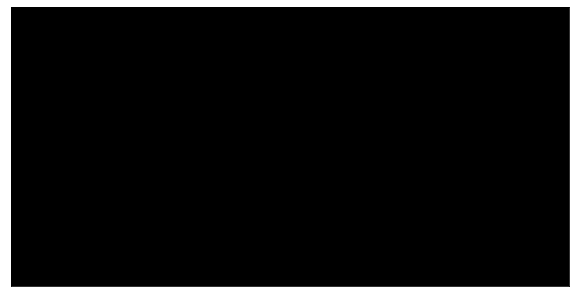



Actual Depth


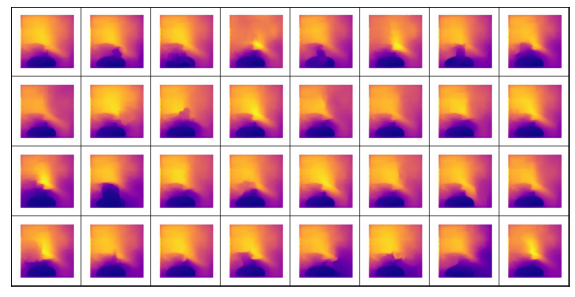

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


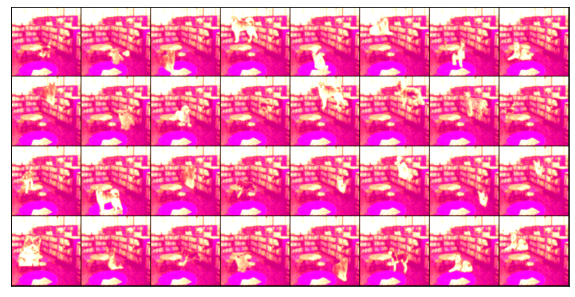

 12%|█▎        | 2/16 [00:05<00:44,  3.16s/it]

  loss: 0.8882034420967102


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 0.8780581951141357


 25%|██▌       | 4/16 [00:08<00:28,  2.39s/it]

  loss: 0.848312258720398


 31%|███▏      | 5/16 [00:10<00:23,  2.17s/it]

  loss: 0.8778250813484192


 38%|███▊      | 6/16 [00:11<00:20,  2.02s/it]

  loss: 0.8895901441574097


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8891123533248901


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8684718608856201


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8566416501998901


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.8588020205497742


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8604581356048584


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.9282793998718262


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.9115257859230042


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8879649639129639


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8646808862686157


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8750981092453003
Training Epoch: 27
  loss: 0.8595037460327148
Train Epoch: 27  [0/500  (0%)]	Loss:0.859504


Actual mask


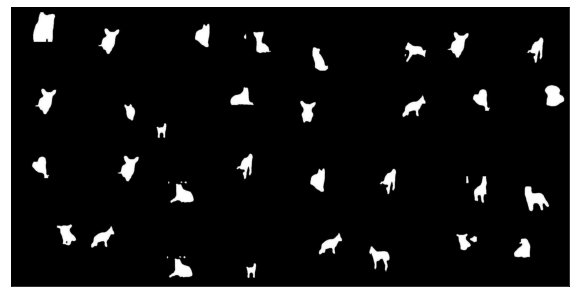

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


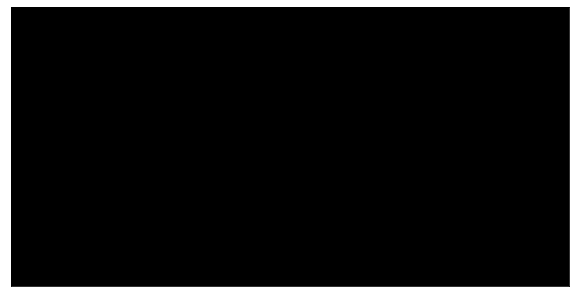



Actual Depth


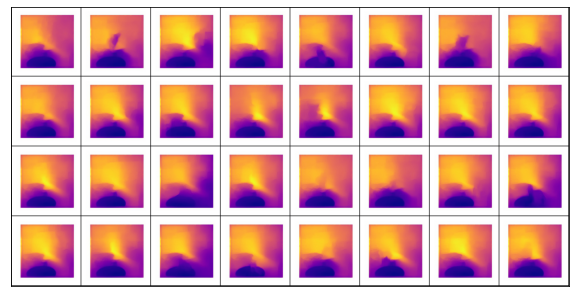

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


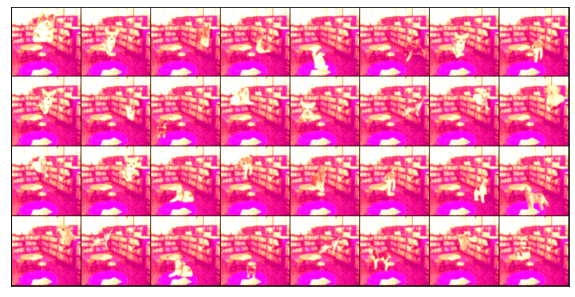

 12%|█▎        | 2/16 [00:05<00:43,  3.11s/it]

  loss: 0.9075876474380493


 19%|█▉        | 3/16 [00:06<00:34,  2.68s/it]

  loss: 0.8721596598625183


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.8786618709564209


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.8973232507705688


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8800827860832214


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.8756396174430847


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8898535966873169


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8639245629310608


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.9042467474937439


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8371816277503967


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8469023704528809


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8632023334503174


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.8908692002296448


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8759278655052185


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8695727586746216
Training Epoch: 28
  loss: 0.8447104692459106
Train Epoch: 28  [0/500  (0%)]	Loss:0.844710


Actual mask


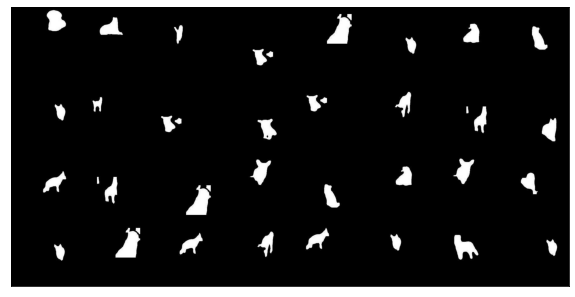

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


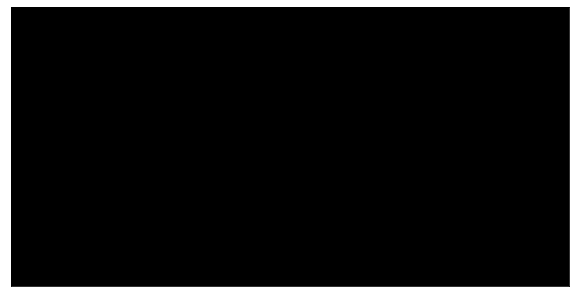



Actual Depth


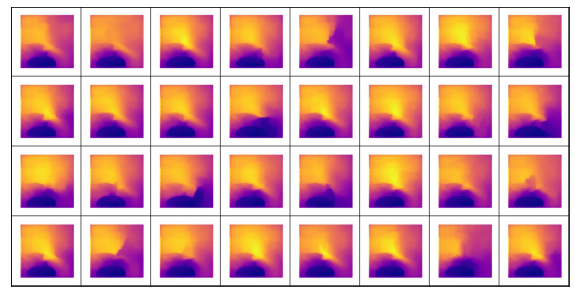

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


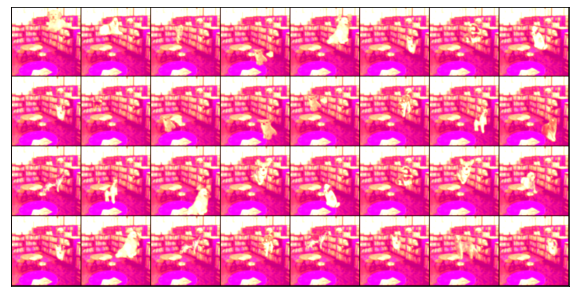

 12%|█▎        | 2/16 [00:05<00:43,  3.12s/it]

  loss: 0.8870653510093689


 19%|█▉        | 3/16 [00:06<00:34,  2.69s/it]

  loss: 0.9026501178741455


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.8835077285766602


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.886417031288147


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8685508370399475


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.886491596698761


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8709572553634644


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.870524525642395


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.8489091396331787


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.863404393196106


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8865567445755005


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8394687175750732


 88%|████████▊ | 14/16 [00:25<00:03,  1.67s/it]

  loss: 0.8915821313858032


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8804240226745605


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8618476986885071
Training Epoch: 29
  loss: 0.8694860339164734
Train Epoch: 29  [0/500  (0%)]	Loss:0.869486


Actual mask


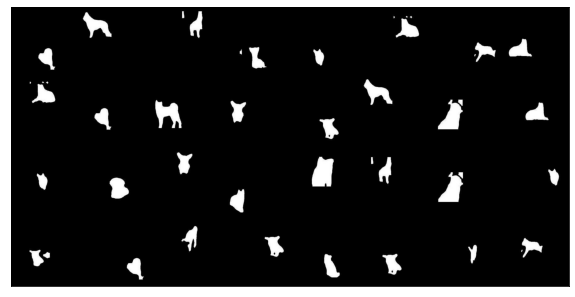

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


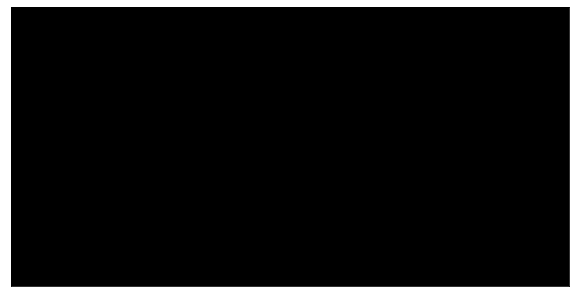



Actual Depth


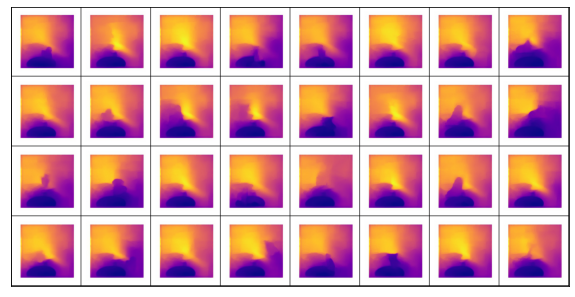

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


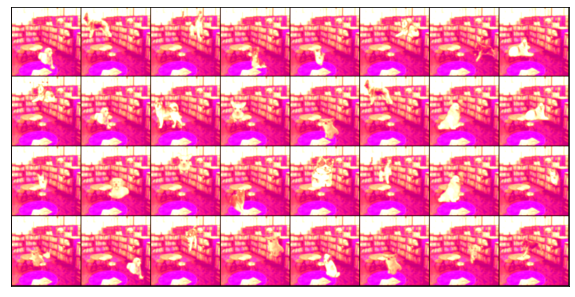

 12%|█▎        | 2/16 [00:05<00:43,  3.14s/it]

  loss: 0.8930638432502747


 19%|█▉        | 3/16 [00:06<00:35,  2.70s/it]

  loss: 0.8550435304641724


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.8693970441818237


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.8652522563934326


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8565978407859802


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8409159183502197


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8903120160102844


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8879219889640808


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.881301999092102


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8853646516799927


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.865444004535675


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8872331976890564


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8645415306091309


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8362777829170227


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.9182006120681763
Training Epoch: 30
  loss: 0.8763729333877563
Train Epoch: 30  [0/500  (0%)]	Loss:0.876373


Actual mask


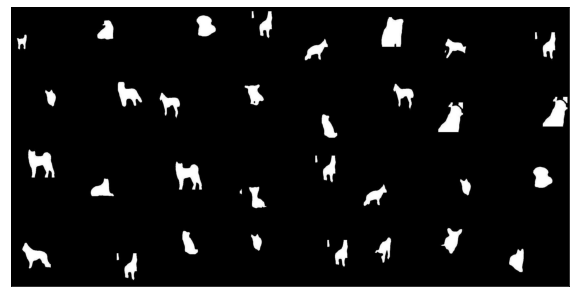

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


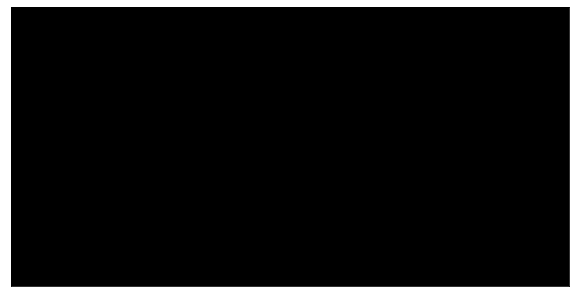



Actual Depth


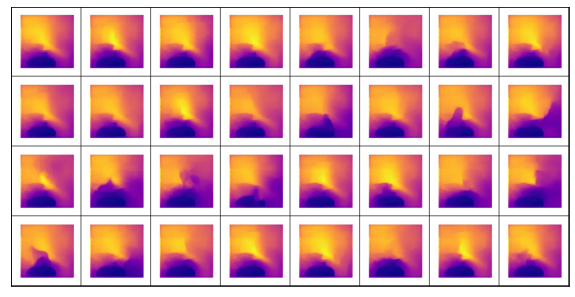

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


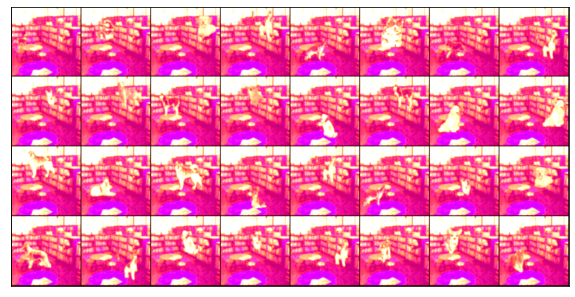

  6%|▋         | 1/16 [00:03<00:59,  3.99s/it]

  loss: 0.8608496189117432
Train Epoch: 30  [3/500  (6%)]	Loss:0.860850


Actual mask


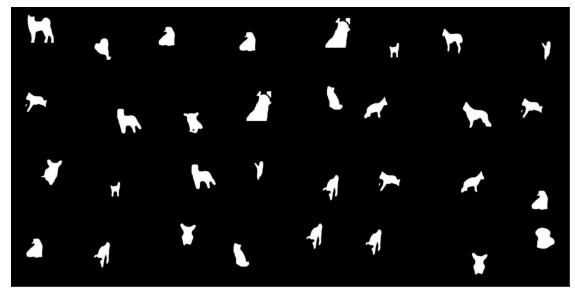

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


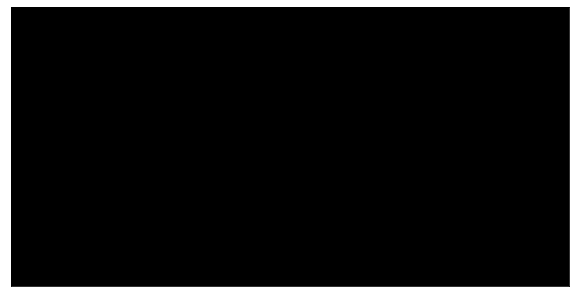



Actual Depth


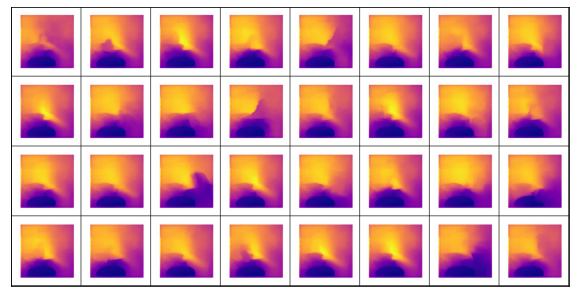

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


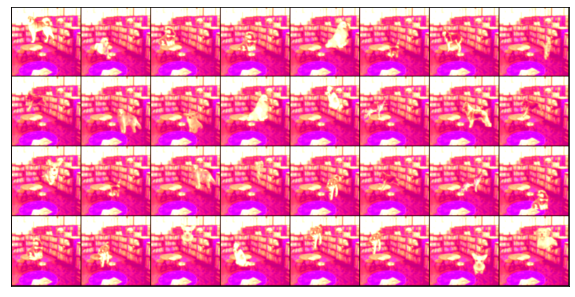

 12%|█▎        | 2/16 [00:07<00:55,  3.94s/it]

  loss: 0.8455750942230225
Train Epoch: 30  [6/500  (12%)]	Loss:0.845575


Actual mask


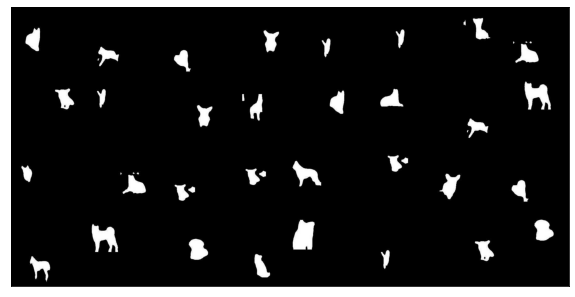

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


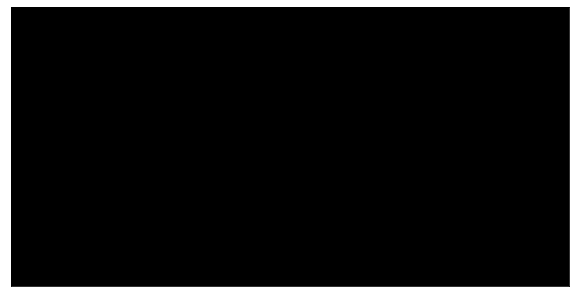



Actual Depth


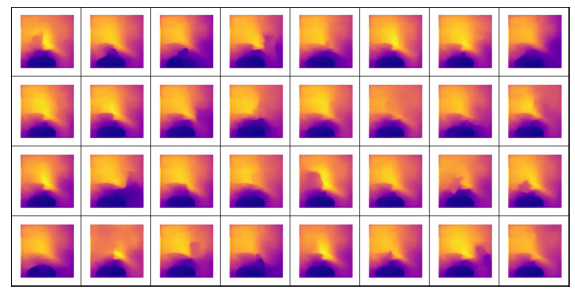

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


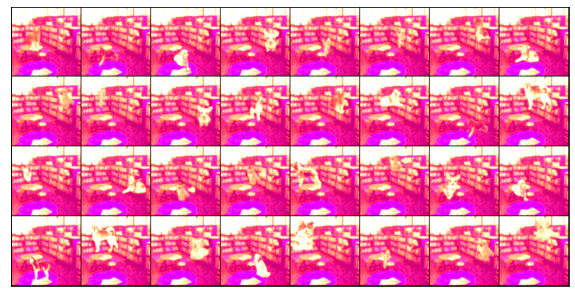

 19%|█▉        | 3/16 [00:11<00:51,  3.95s/it]

  loss: 0.893632709980011
Train Epoch: 30  [9/500  (19%)]	Loss:0.893633


Actual mask


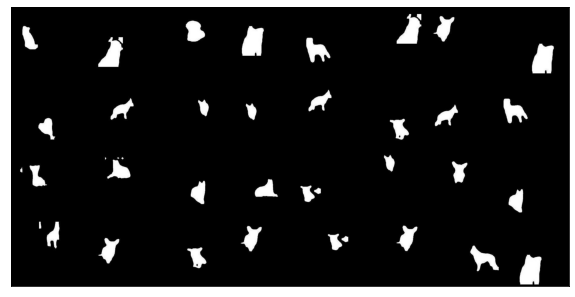

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


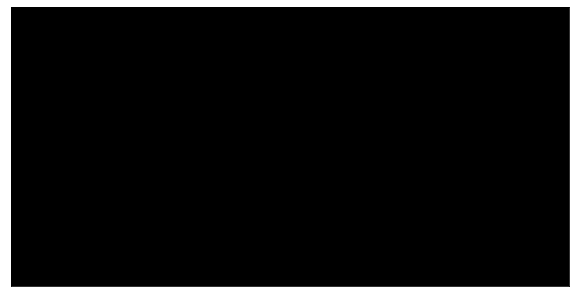



Actual Depth


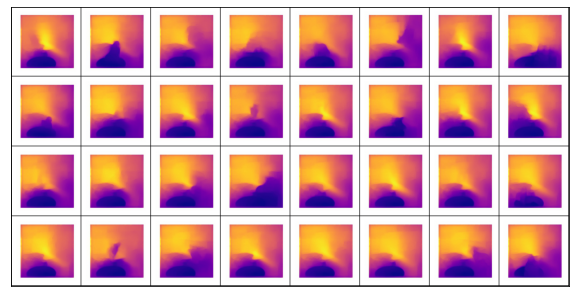

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


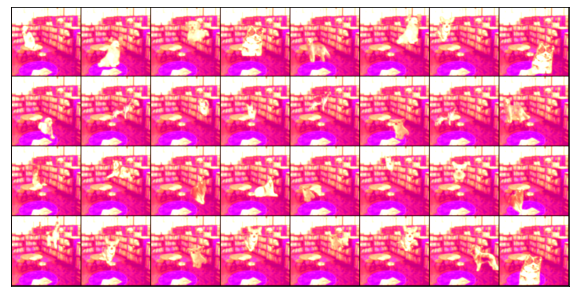

 25%|██▌       | 4/16 [00:15<00:46,  3.90s/it]

  loss: 0.8787070512771606
Train Epoch: 30  [12/500  (25%)]	Loss:0.878707


Actual mask


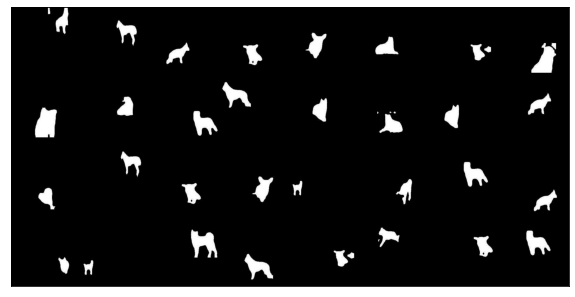

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


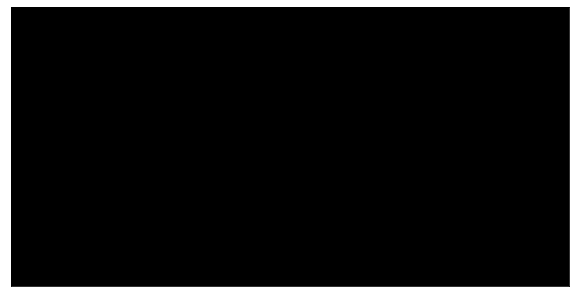



Actual Depth


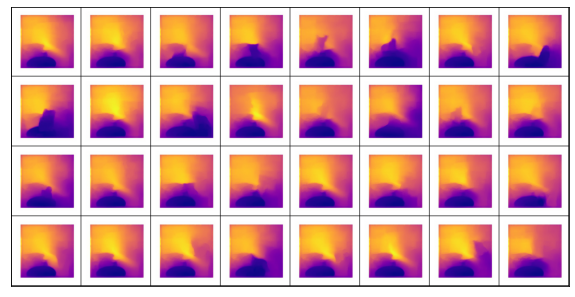

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


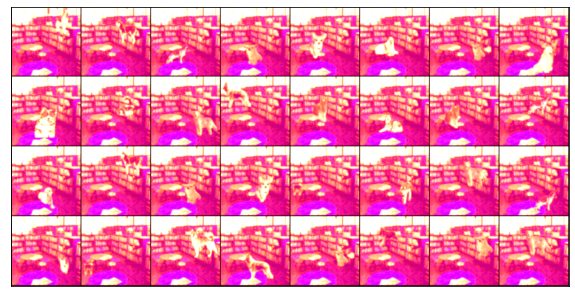

 31%|███▏      | 5/16 [00:19<00:43,  3.92s/it]

  loss: 0.869762659072876
Train Epoch: 30  [15/500  (31%)]	Loss:0.869763


Actual mask


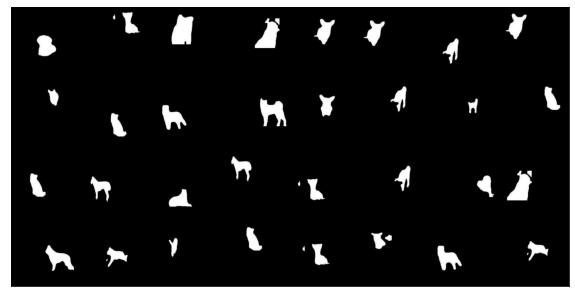

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


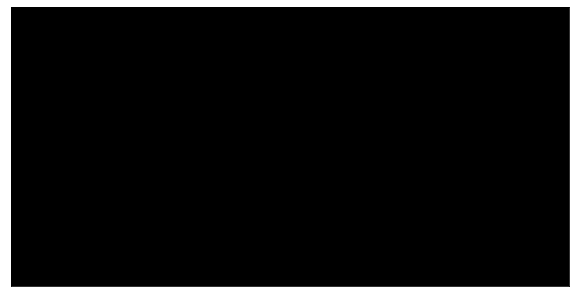



Actual Depth


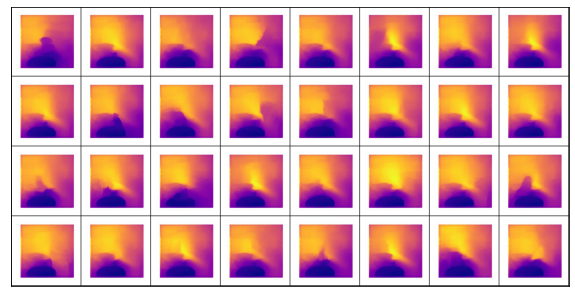

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


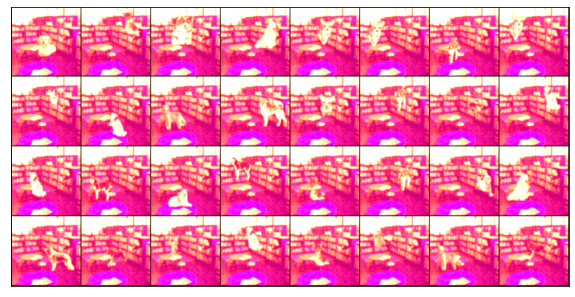

 38%|███▊      | 6/16 [00:23<00:39,  3.94s/it]

  loss: 0.8574943542480469
Train Epoch: 30  [18/500  (38%)]	Loss:0.857494


Actual mask


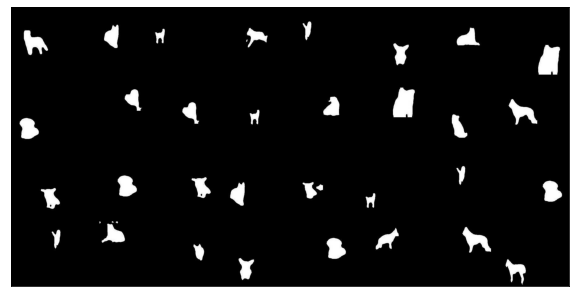

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


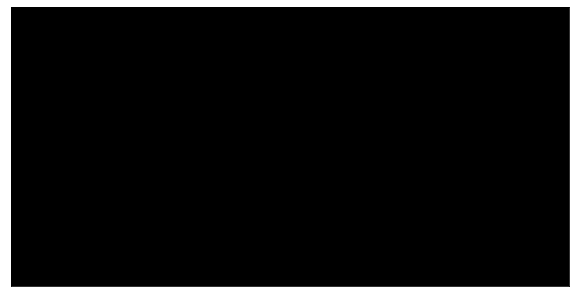



Actual Depth


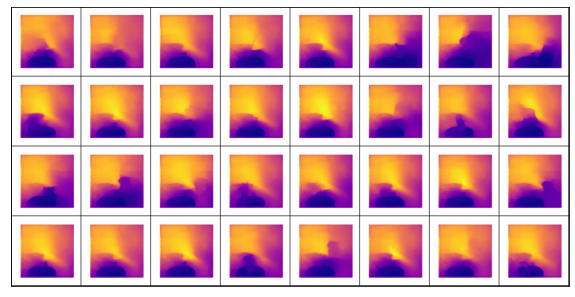

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


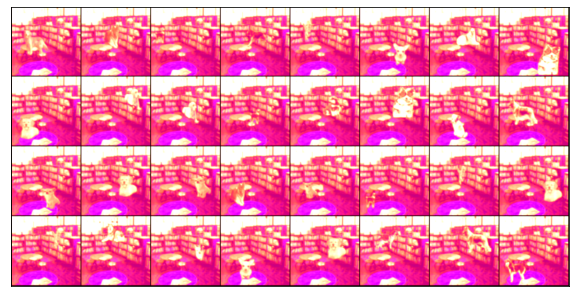

 44%|████▍     | 7/16 [00:27<00:35,  3.97s/it]

  loss: 0.8698946833610535
Train Epoch: 30  [21/500  (44%)]	Loss:0.869895


Actual mask


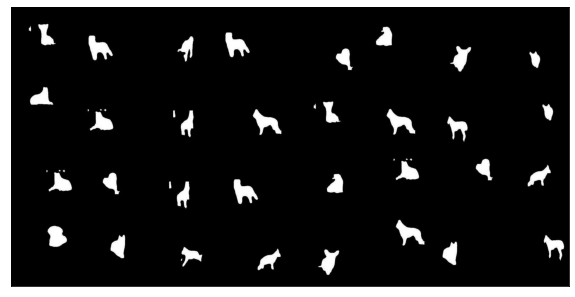

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


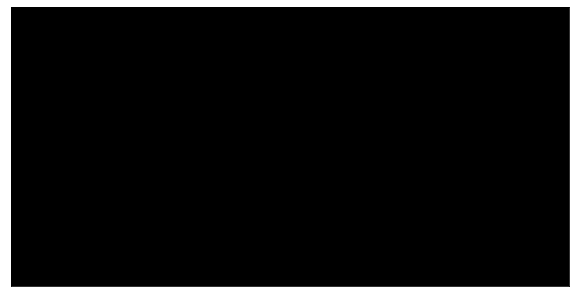



Actual Depth


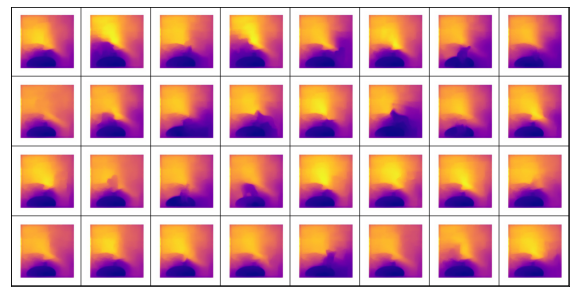

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


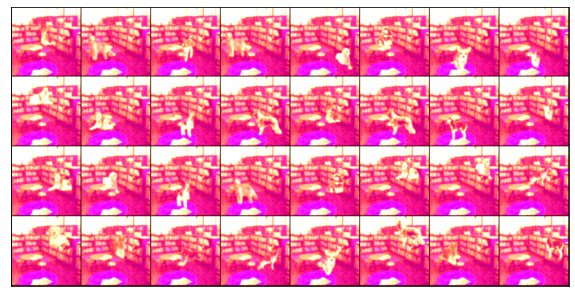

 50%|█████     | 8/16 [00:31<00:31,  3.97s/it]

  loss: 0.9112902879714966
Train Epoch: 30  [24/500  (50%)]	Loss:0.911290


Actual mask


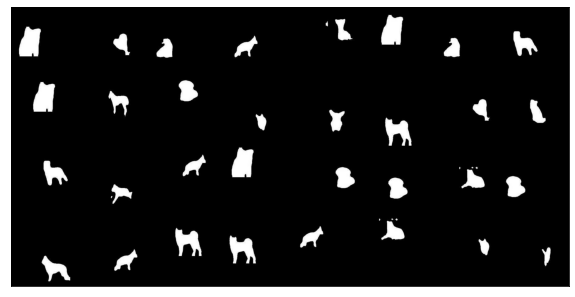

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


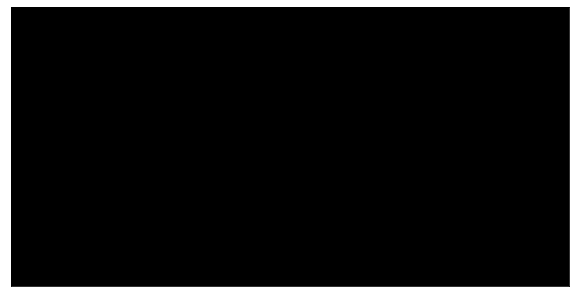



Actual Depth


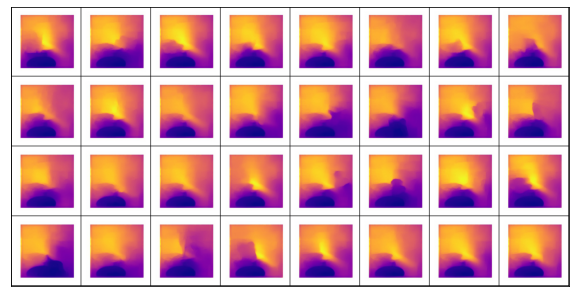

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


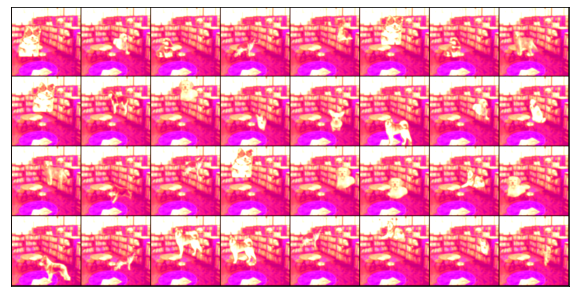

 56%|█████▋    | 9/16 [00:35<00:27,  3.99s/it]

  loss: 0.835027813911438
Train Epoch: 30  [27/500  (56%)]	Loss:0.835028


Actual mask


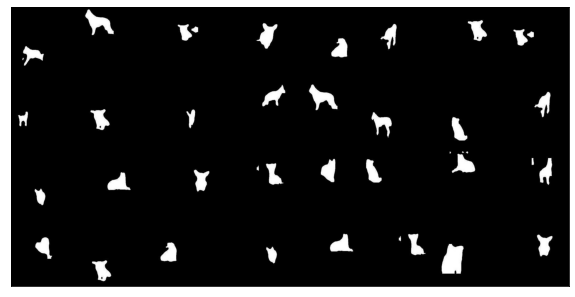

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


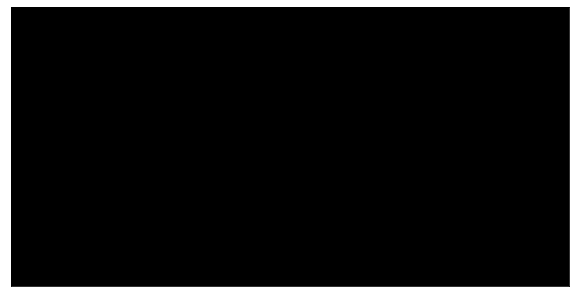



Actual Depth


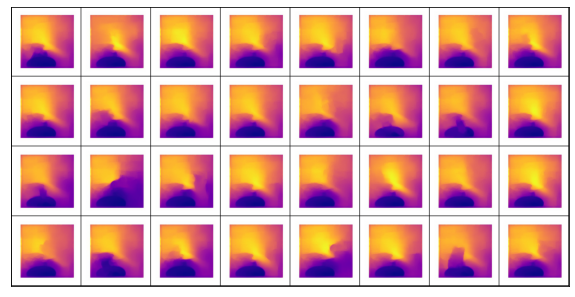

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


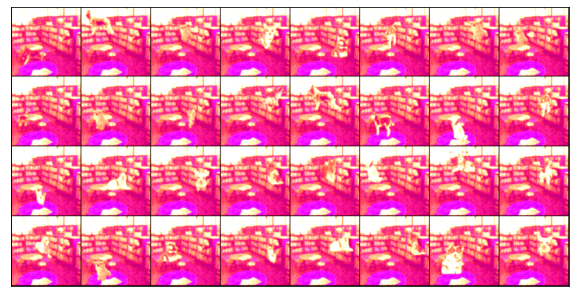

 62%|██████▎   | 10/16 [00:39<00:23,  4.00s/it]

  loss: 0.8937115669250488
Train Epoch: 30  [30/500  (62%)]	Loss:0.893712


Actual mask


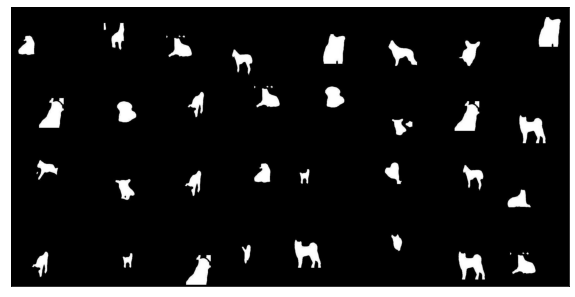

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


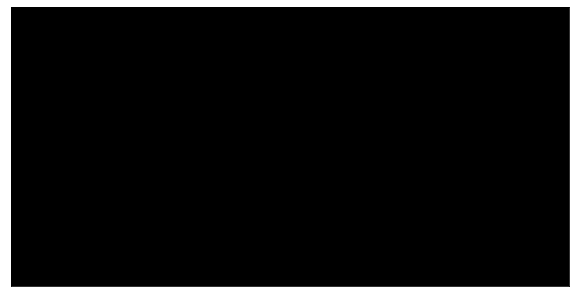



Actual Depth


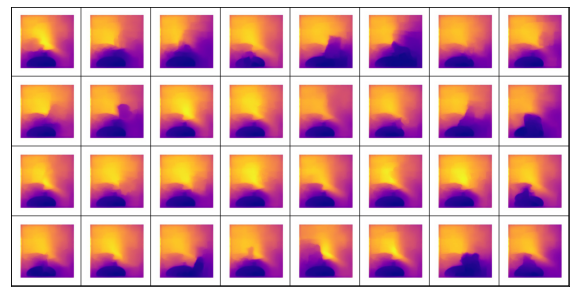

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


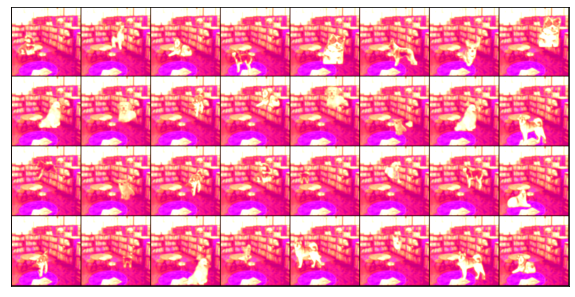

 69%|██████▉   | 11/16 [00:43<00:19,  3.99s/it]

  loss: 0.8497301340103149
Train Epoch: 30  [33/500  (69%)]	Loss:0.849730


Actual mask


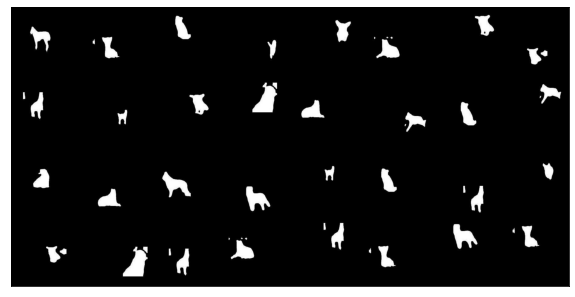

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


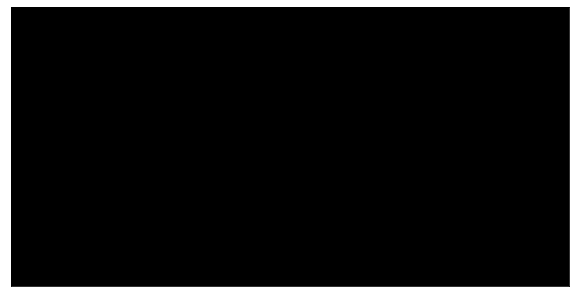



Actual Depth


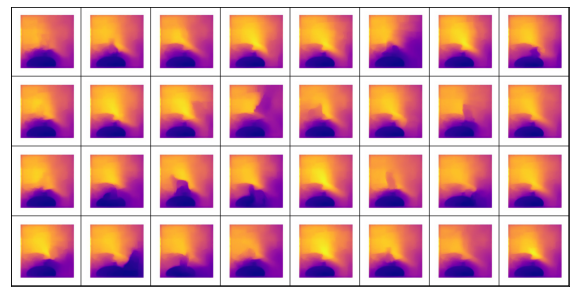

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


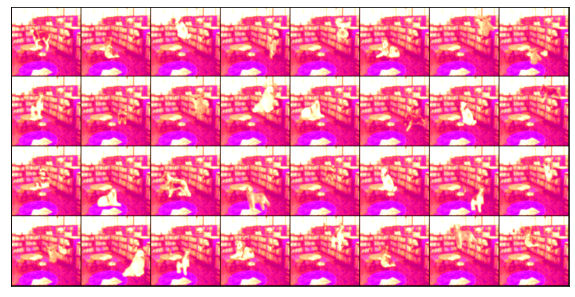

 75%|███████▌  | 12/16 [00:47<00:15,  3.98s/it]

  loss: 0.8709794282913208
Train Epoch: 30  [36/500  (75%)]	Loss:0.870979


Actual mask


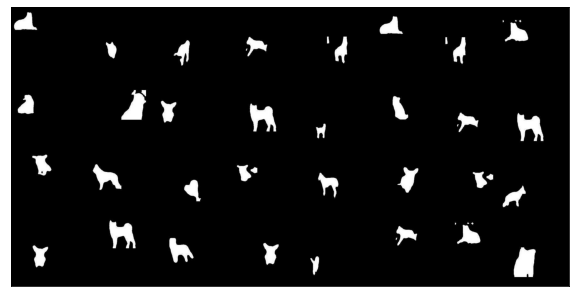

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


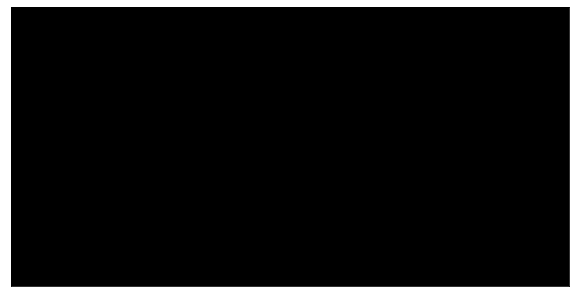



Actual Depth


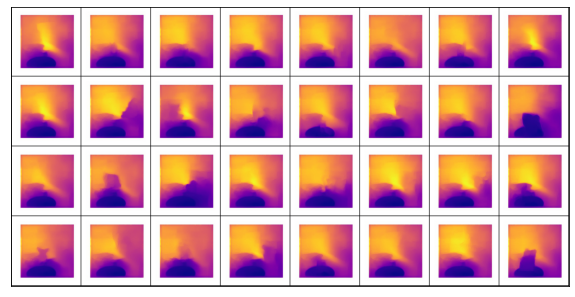

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


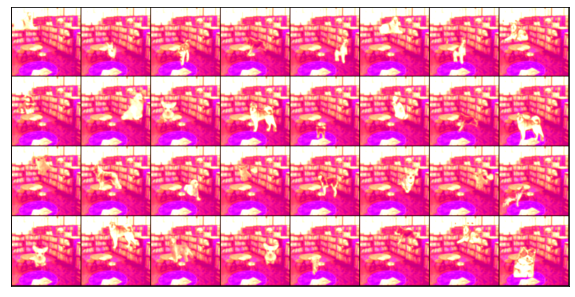

 81%|████████▏ | 13/16 [00:51<00:11,  3.97s/it]

  loss: 0.8591646552085876
Train Epoch: 30  [39/500  (81%)]	Loss:0.859165


Actual mask


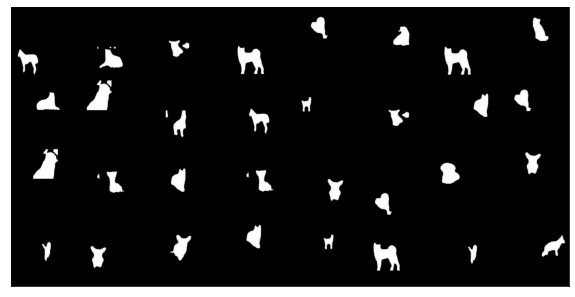

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


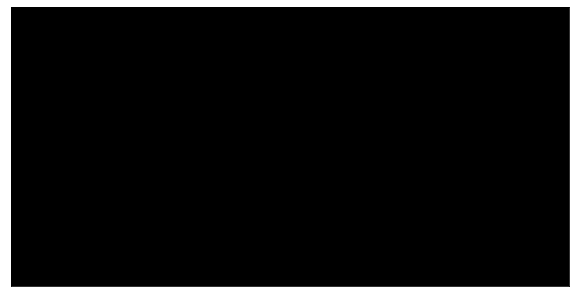



Actual Depth


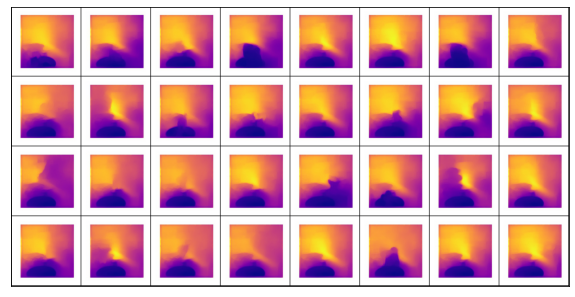

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


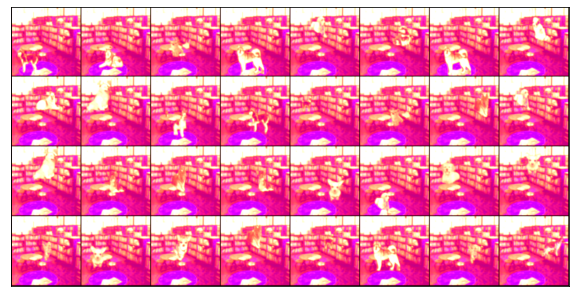

 88%|████████▊ | 14/16 [00:55<00:08,  4.00s/it]

  loss: 0.8591288328170776
Train Epoch: 30  [42/500  (88%)]	Loss:0.859129


Actual mask


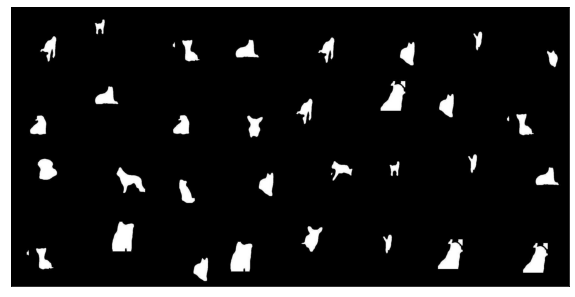

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


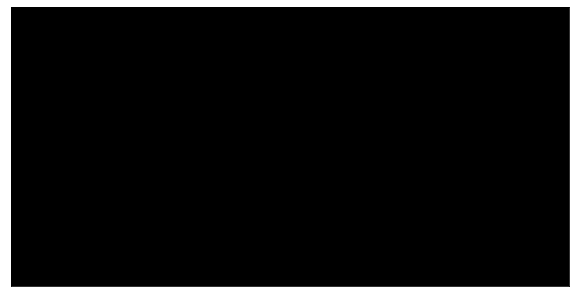



Actual Depth


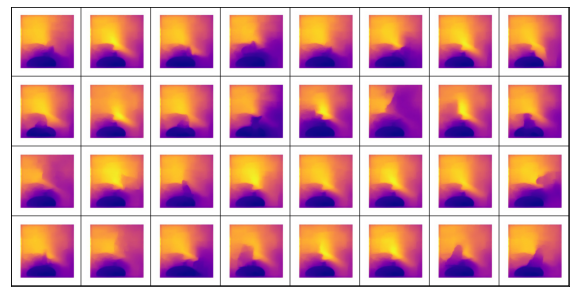

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


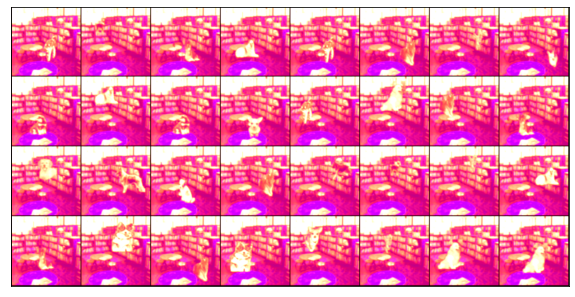

 94%|█████████▍| 15/16 [00:59<00:03,  4.00s/it]

  loss: 0.8587906956672668
Train Epoch: 30  [45/500  (94%)]	Loss:0.858791


Actual mask


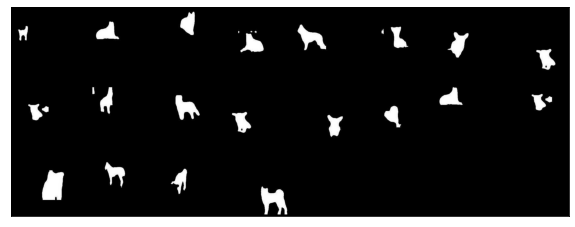

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


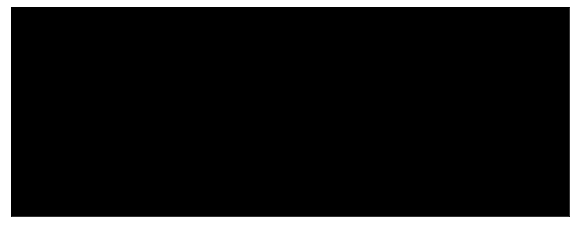



Actual Depth


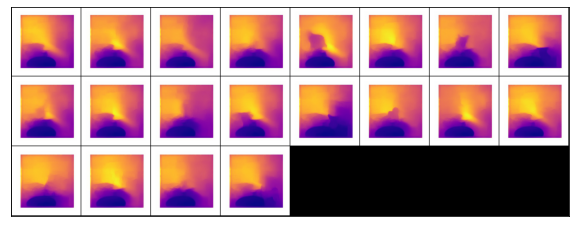

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


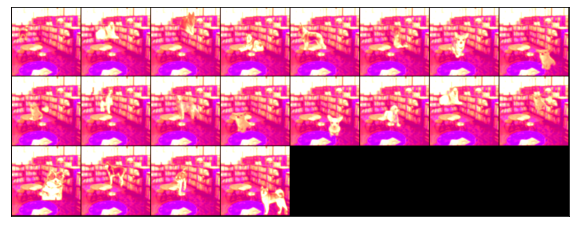

  0%|          | 0/16 [00:00<?, ?it/s]

Training Epoch: 31
  loss: 0.858973503112793
Train Epoch: 31  [0/500  (0%)]	Loss:0.858974


Actual mask


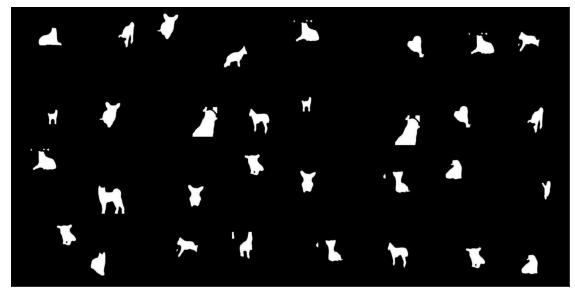

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


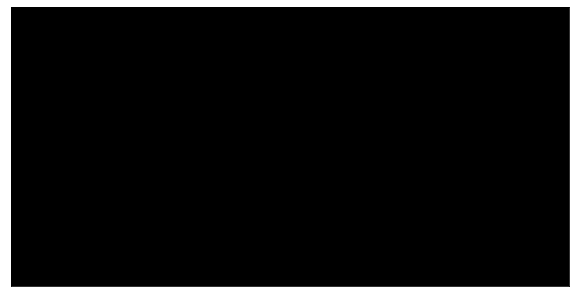



Actual Depth


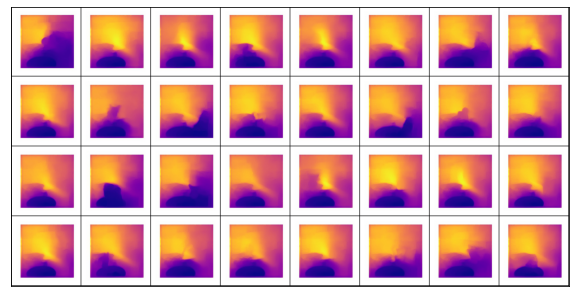

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


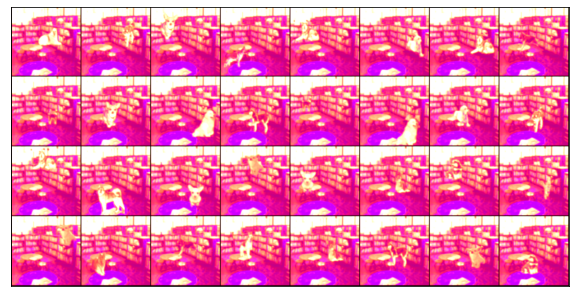

 12%|█▎        | 2/16 [00:05<00:43,  3.11s/it]

  loss: 0.8399530649185181


 19%|█▉        | 3/16 [00:06<00:35,  2.70s/it]

  loss: 0.8817612528800964


 25%|██▌       | 4/16 [00:08<00:28,  2.39s/it]

  loss: 0.8721566796302795


 31%|███▏      | 5/16 [00:10<00:24,  2.18s/it]

  loss: 0.8604141473770142


 38%|███▊      | 6/16 [00:11<00:20,  2.04s/it]

  loss: 0.8644614219665527


 44%|████▍     | 7/16 [00:13<00:17,  1.93s/it]

  loss: 0.8423686027526855


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8600218892097473


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8592516779899597


 62%|██████▎   | 10/16 [00:18<00:10,  1.76s/it]

  loss: 0.886080265045166


 69%|██████▉   | 11/16 [00:20<00:08,  1.73s/it]

  loss: 0.8916283249855042


 75%|███████▌  | 12/16 [00:21<00:06,  1.71s/it]

  loss: 0.8816280364990234


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.8588252067565918


 88%|████████▊ | 14/16 [00:25<00:03,  1.69s/it]

  loss: 0.8469444513320923


 94%|█████████▍| 15/16 [00:26<00:01,  1.69s/it]

  loss: 0.8793314695358276


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8664218187332153
Training Epoch: 32
  loss: 0.881159782409668
Train Epoch: 32  [0/500  (0%)]	Loss:0.881160


Actual mask


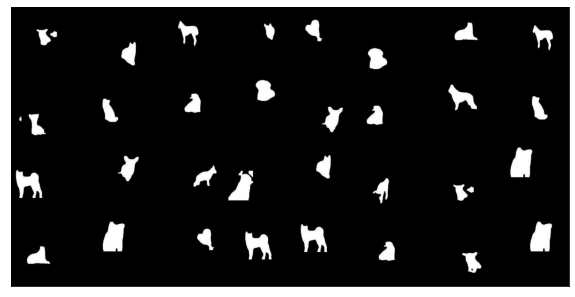

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


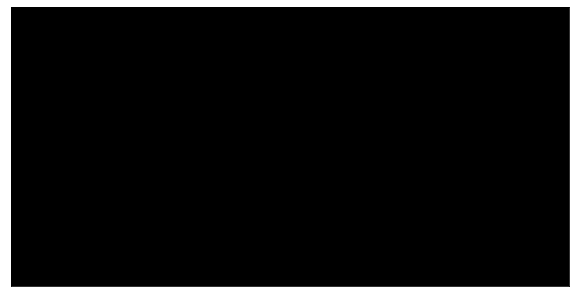



Actual Depth


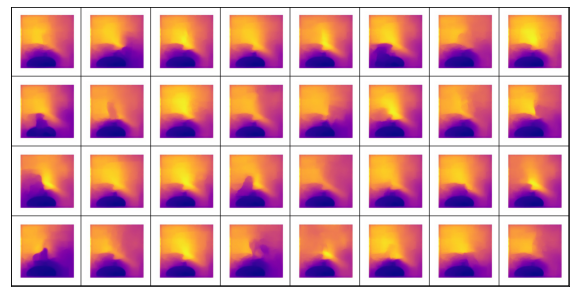

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


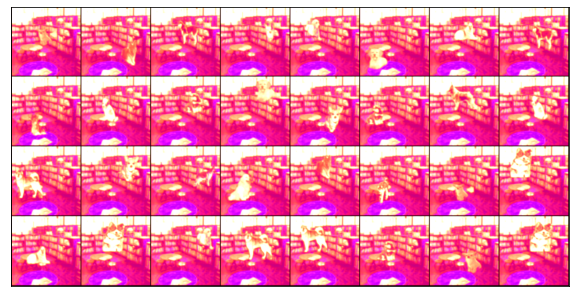

 12%|█▎        | 2/16 [00:05<00:43,  3.13s/it]

  loss: 0.8732430338859558


 19%|█▉        | 3/16 [00:06<00:35,  2.70s/it]

  loss: 0.869875431060791


 25%|██▌       | 4/16 [00:08<00:28,  2.39s/it]

  loss: 0.848328709602356


 31%|███▏      | 5/16 [00:10<00:23,  2.17s/it]

  loss: 0.843870997428894


 38%|███▊      | 6/16 [00:11<00:20,  2.02s/it]

  loss: 0.8849407434463501


 44%|████▍     | 7/16 [00:13<00:17,  1.92s/it]

  loss: 0.8630051016807556


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8507107496261597


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8689444065093994


 62%|██████▎   | 10/16 [00:18<00:10,  1.76s/it]

  loss: 0.880441427230835


 69%|██████▉   | 11/16 [00:20<00:08,  1.73s/it]

  loss: 0.8399380445480347


 75%|███████▌  | 12/16 [00:21<00:06,  1.72s/it]

  loss: 0.8598820567131042


 81%|████████▏ | 13/16 [00:23<00:05,  1.70s/it]

  loss: 0.8383456468582153


 88%|████████▊ | 14/16 [00:25<00:03,  1.70s/it]

  loss: 0.8610852956771851


 94%|█████████▍| 15/16 [00:26<00:01,  1.69s/it]

  loss: 0.8405035734176636


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.888762354850769
Training Epoch: 33
  loss: 0.8532682061195374
Train Epoch: 33  [0/500  (0%)]	Loss:0.853268


Actual mask


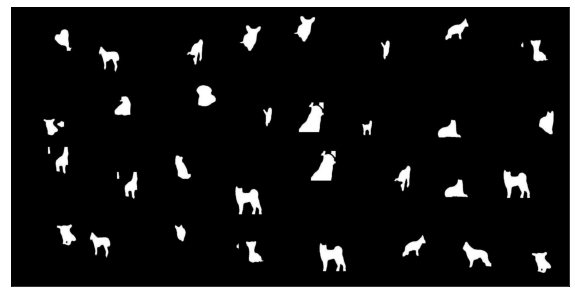

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


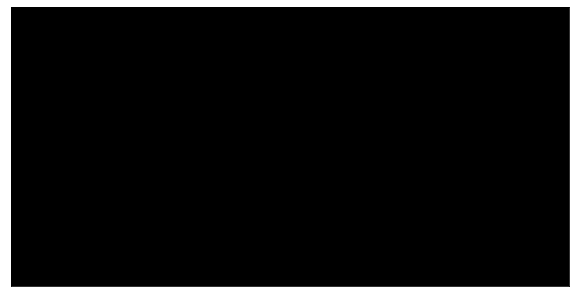



Actual Depth


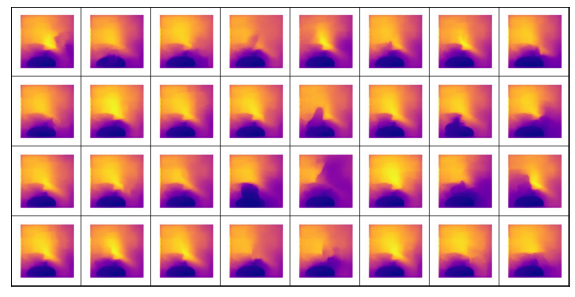

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


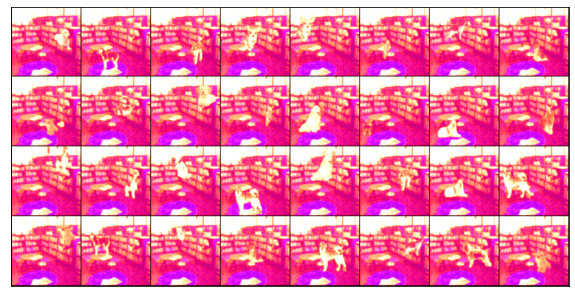

 12%|█▎        | 2/16 [00:05<00:44,  3.14s/it]

  loss: 0.833662748336792


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 0.8424855470657349


 25%|██▌       | 4/16 [00:08<00:28,  2.40s/it]

  loss: 0.8658477067947388


 31%|███▏      | 5/16 [00:10<00:24,  2.19s/it]

  loss: 0.8641454577445984


 38%|███▊      | 6/16 [00:11<00:20,  2.04s/it]

  loss: 0.8726438283920288


 44%|████▍     | 7/16 [00:13<00:17,  1.93s/it]

  loss: 0.8556217551231384


 50%|█████     | 8/16 [00:15<00:14,  1.86s/it]

  loss: 0.8653445243835449


 56%|█████▋    | 9/16 [00:16<00:12,  1.80s/it]

  loss: 0.8371407985687256


 62%|██████▎   | 10/16 [00:18<00:10,  1.77s/it]

  loss: 0.8719613552093506


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.8509072065353394


 75%|███████▌  | 12/16 [00:22<00:06,  1.72s/it]

  loss: 0.8792892694473267


 81%|████████▏ | 13/16 [00:23<00:05,  1.71s/it]

  loss: 0.8480883836746216


 88%|████████▊ | 14/16 [00:25<00:03,  1.71s/it]

  loss: 0.8545886278152466


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.8575347661972046


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8718581795692444
Training Epoch: 34
  loss: 0.8458647727966309
Train Epoch: 34  [0/500  (0%)]	Loss:0.845865


Actual mask


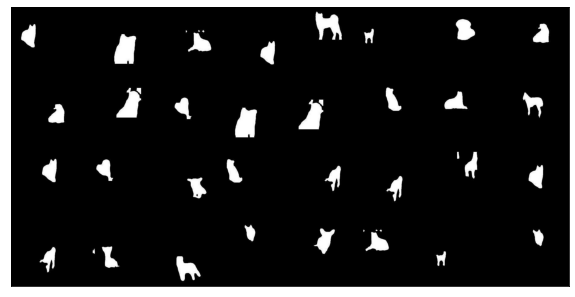

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


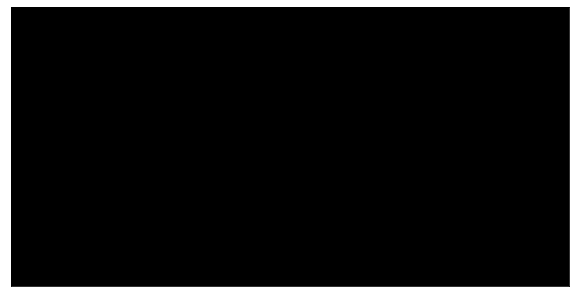



Actual Depth


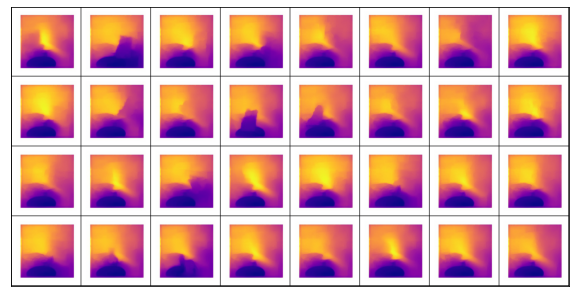

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


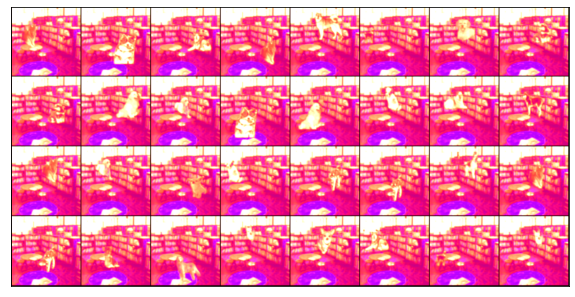

 12%|█▎        | 2/16 [00:05<00:46,  3.35s/it]

  loss: 0.8583890199661255


 19%|█▉        | 3/16 [00:07<00:37,  2.86s/it]

  loss: 0.8724304437637329


 25%|██▌       | 4/16 [00:08<00:30,  2.50s/it]

  loss: 0.8631381988525391


 31%|███▏      | 5/16 [00:10<00:24,  2.26s/it]

  loss: 0.8236861824989319


 38%|███▊      | 6/16 [00:12<00:20,  2.09s/it]

  loss: 0.8508448600769043


 44%|████▍     | 7/16 [00:14<00:17,  1.97s/it]

  loss: 0.8394390940666199


 50%|█████     | 8/16 [00:15<00:15,  1.88s/it]

  loss: 0.8511672616004944


 56%|█████▋    | 9/16 [00:17<00:12,  1.82s/it]

  loss: 0.8255541920661926


 62%|██████▎   | 10/16 [00:19<00:10,  1.78s/it]

  loss: 0.8607279658317566


 69%|██████▉   | 11/16 [00:20<00:08,  1.75s/it]

  loss: 0.8634524345397949


 75%|███████▌  | 12/16 [00:22<00:06,  1.74s/it]

  loss: 0.8665405511856079


 81%|████████▏ | 13/16 [00:24<00:05,  1.72s/it]

  loss: 0.8685954809188843


 88%|████████▊ | 14/16 [00:25<00:03,  1.71s/it]

  loss: 0.8541685938835144


 94%|█████████▍| 15/16 [00:27<00:01,  1.70s/it]

  loss: 0.8418796062469482


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8499897718429565
Training Epoch: 35
  loss: 0.8320497870445251
Train Epoch: 35  [0/500  (0%)]	Loss:0.832050


Actual mask


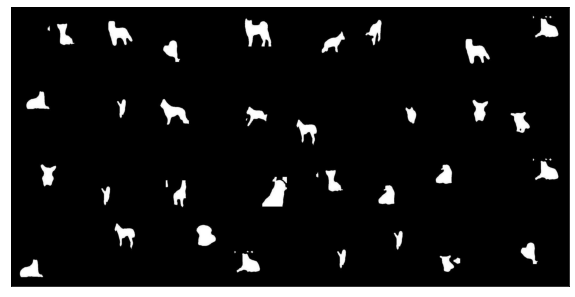

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


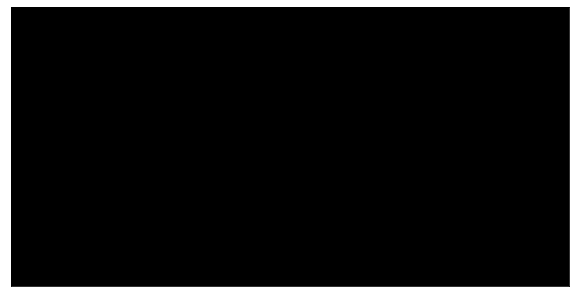



Actual Depth


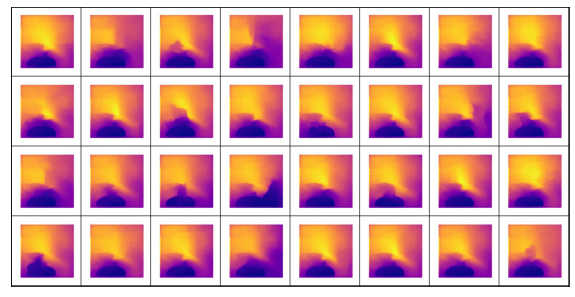

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


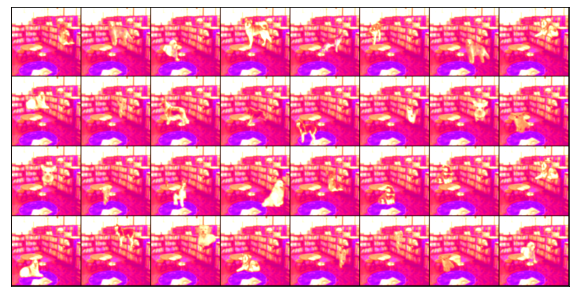

 12%|█▎        | 2/16 [00:05<00:45,  3.24s/it]

  loss: 0.8284810781478882


 19%|█▉        | 3/16 [00:07<00:36,  2.78s/it]

  loss: 0.8479887843132019


 25%|██▌       | 4/16 [00:08<00:29,  2.44s/it]

  loss: 0.8496558666229248


 31%|███▏      | 5/16 [00:10<00:24,  2.21s/it]

  loss: 0.8753317594528198


 38%|███▊      | 6/16 [00:12<00:20,  2.05s/it]

  loss: 0.8476078510284424


 44%|████▍     | 7/16 [00:13<00:17,  1.94s/it]

  loss: 0.8590030074119568


 50%|█████     | 8/16 [00:15<00:14,  1.86s/it]

  loss: 0.8506880402565002


 56%|█████▋    | 9/16 [00:17<00:12,  1.80s/it]

  loss: 0.8593313097953796


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.829150378704071


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.841126561164856


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8467342257499695


 81%|████████▏ | 13/16 [00:23<00:05,  1.68s/it]

  loss: 0.8467601537704468


 88%|████████▊ | 14/16 [00:25<00:03,  1.67s/it]

  loss: 0.8243286609649658


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8448410630226135


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8386905193328857
Training Epoch: 36
  loss: 0.8381839394569397
Train Epoch: 36  [0/500  (0%)]	Loss:0.838184


Actual mask


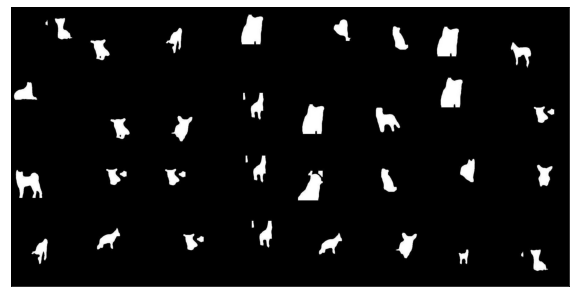

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


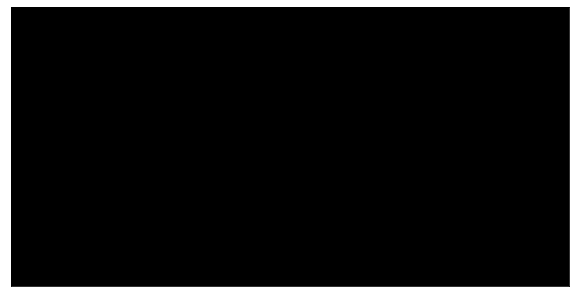



Actual Depth


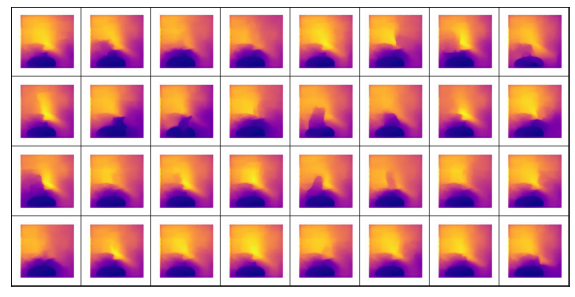

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


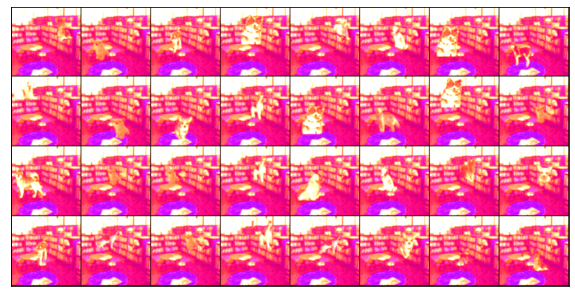

 12%|█▎        | 2/16 [00:05<00:44,  3.21s/it]

  loss: 0.8510732650756836


 19%|█▉        | 3/16 [00:06<00:35,  2.75s/it]

  loss: 0.8567870855331421


 25%|██▌       | 4/16 [00:08<00:29,  2.42s/it]

  loss: 0.8163048624992371


 31%|███▏      | 5/16 [00:10<00:24,  2.19s/it]

  loss: 0.8550121784210205


 38%|███▊      | 6/16 [00:11<00:20,  2.03s/it]

  loss: 0.840114951133728


 44%|████▍     | 7/16 [00:13<00:17,  1.92s/it]

  loss: 0.8514347076416016


 50%|█████     | 8/16 [00:15<00:14,  1.84s/it]

  loss: 0.8485924005508423


 56%|█████▋    | 9/16 [00:16<00:12,  1.79s/it]

  loss: 0.8219857215881348


 62%|██████▎   | 10/16 [00:18<00:10,  1.75s/it]

  loss: 0.8384087085723877


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8491025567054749


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8326441645622253


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8455570340156555


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8343107104301453


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8146370649337769


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8243808150291443
Training Epoch: 37
  loss: 0.8416473269462585
Train Epoch: 37  [0/500  (0%)]	Loss:0.841647


Actual mask


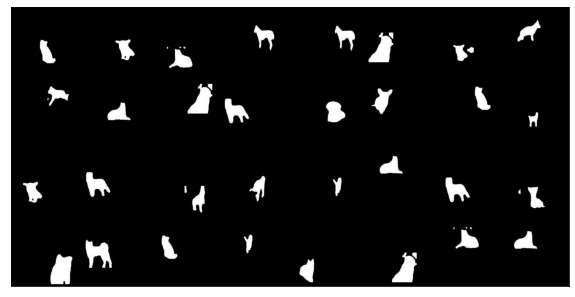

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


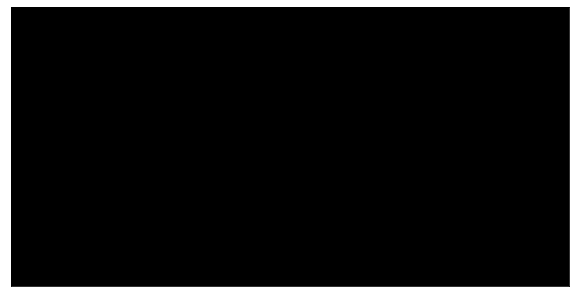



Actual Depth


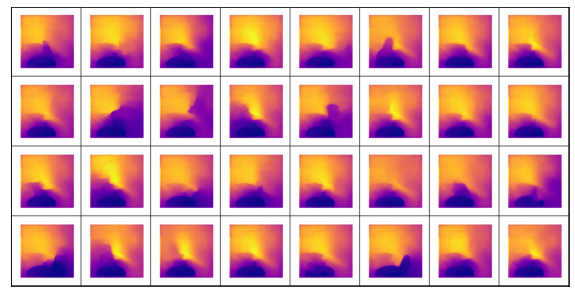

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


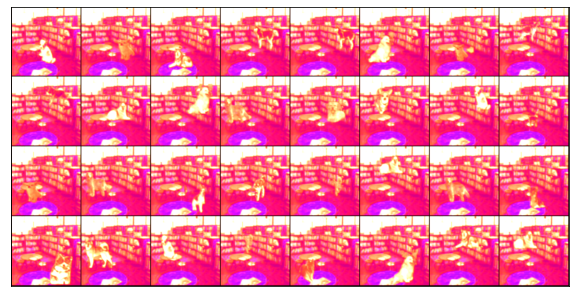

 12%|█▎        | 2/16 [00:05<00:43,  3.12s/it]

  loss: 0.8417335748672485


 19%|█▉        | 3/16 [00:06<00:34,  2.69s/it]

  loss: 0.8533236980438232


 25%|██▌       | 4/16 [00:08<00:28,  2.38s/it]

  loss: 0.8328282237052917


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.8245013356208801


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8326966762542725


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.826557993888855


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8218418955802917


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8199285268783569


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.8277857303619385


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8461921811103821


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8396465182304382


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8536115884780884


 88%|████████▊ | 14/16 [00:24<00:03,  1.68s/it]

  loss: 0.8024643063545227


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8400235176086426


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8239378929138184
Training Epoch: 38
  loss: 0.8487218618392944
Train Epoch: 38  [0/500  (0%)]	Loss:0.848722


Actual mask


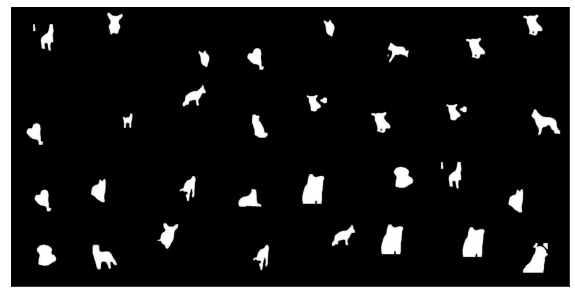

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


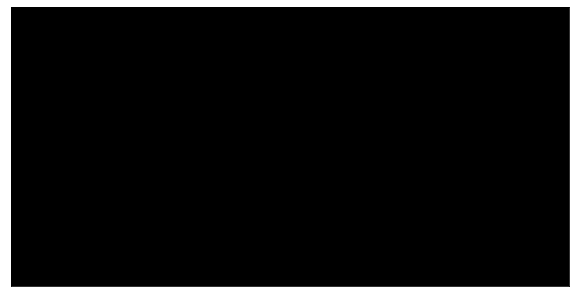



Actual Depth


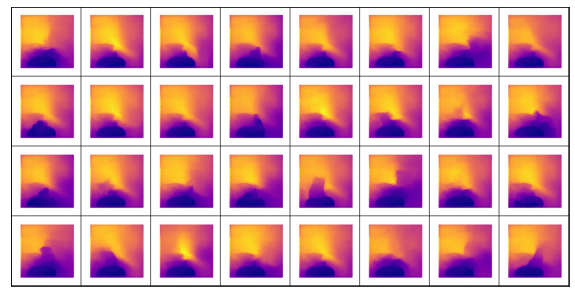

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


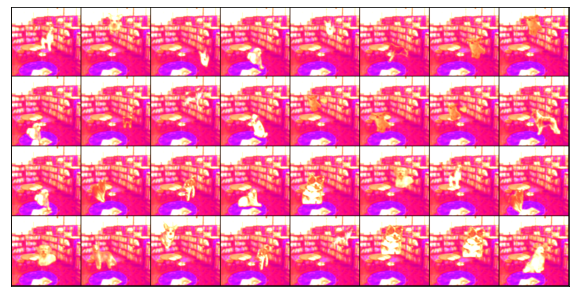

 12%|█▎        | 2/16 [00:05<00:44,  3.16s/it]

  loss: 0.8360399603843689


 19%|█▉        | 3/16 [00:06<00:35,  2.71s/it]

  loss: 0.8258754014968872


 25%|██▌       | 4/16 [00:08<00:28,  2.39s/it]

  loss: 0.8409485816955566


 31%|███▏      | 5/16 [00:10<00:23,  2.17s/it]

  loss: 0.8341771364212036


 38%|███▊      | 6/16 [00:11<00:20,  2.02s/it]

  loss: 0.8306999206542969


 44%|████▍     | 7/16 [00:13<00:17,  1.91s/it]

  loss: 0.8359785079956055


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.8233884572982788


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8421339392662048


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.8227275609970093


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8594194650650024


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8425249457359314


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.787235677242279


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.797455906867981


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8064781427383423


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.8406753540039062
Training Epoch: 39
  loss: 0.8148453831672668
Train Epoch: 39  [0/500  (0%)]	Loss:0.814845


Actual mask


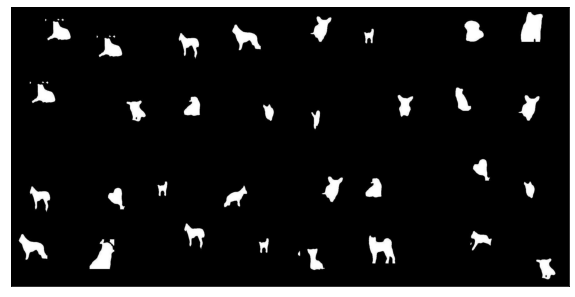

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


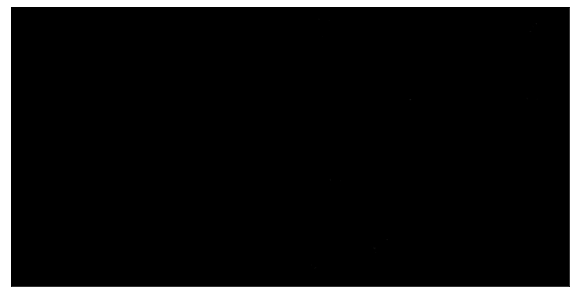



Actual Depth


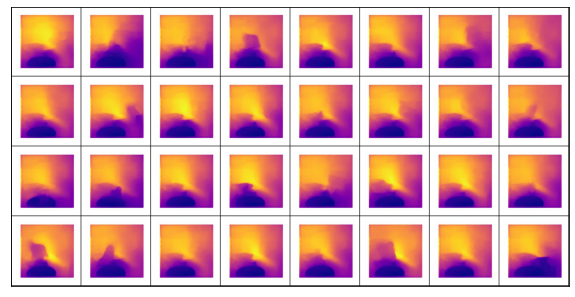

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


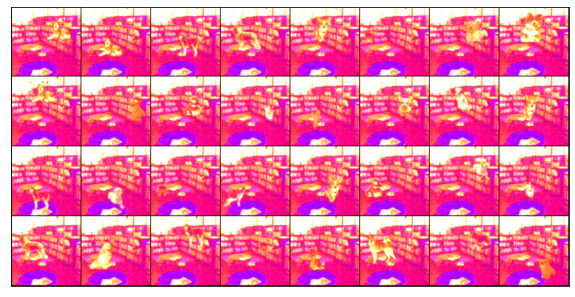

 12%|█▎        | 2/16 [00:05<00:43,  3.12s/it]

  loss: 0.8185006380081177


 19%|█▉        | 3/16 [00:06<00:34,  2.68s/it]

  loss: 0.8369725942611694


 25%|██▌       | 4/16 [00:08<00:28,  2.37s/it]

  loss: 0.8200645446777344


 31%|███▏      | 5/16 [00:10<00:23,  2.16s/it]

  loss: 0.8095459342002869


 38%|███▊      | 6/16 [00:11<00:20,  2.01s/it]

  loss: 0.8097481727600098


 44%|████▍     | 7/16 [00:13<00:17,  1.90s/it]

  loss: 0.8030171394348145


 50%|█████     | 8/16 [00:15<00:14,  1.83s/it]

  loss: 0.810634434223175


 56%|█████▋    | 9/16 [00:16<00:12,  1.78s/it]

  loss: 0.8126559853553772


 62%|██████▎   | 10/16 [00:18<00:10,  1.74s/it]

  loss: 0.8216134309768677


 69%|██████▉   | 11/16 [00:20<00:08,  1.72s/it]

  loss: 0.8301328420639038


 75%|███████▌  | 12/16 [00:21<00:06,  1.70s/it]

  loss: 0.8366504907608032


 81%|████████▏ | 13/16 [00:23<00:05,  1.69s/it]

  loss: 0.8149616718292236


 88%|████████▊ | 14/16 [00:25<00:03,  1.68s/it]

  loss: 0.8297458291053772


 94%|█████████▍| 15/16 [00:26<00:01,  1.67s/it]

  loss: 0.8052771091461182


  0%|          | 0/16 [00:00<?, ?it/s]

  loss: 0.7981460690498352
Training Epoch: 40
  loss: 0.8203977346420288
Train Epoch: 40  [0/500  (0%)]	Loss:0.820398


Actual mask


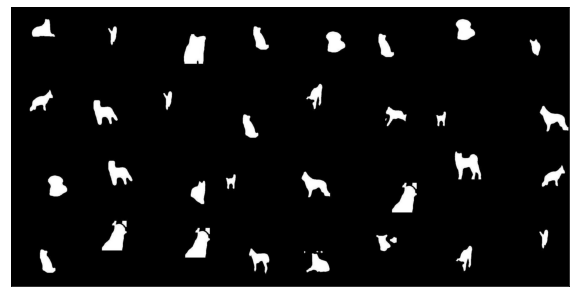

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


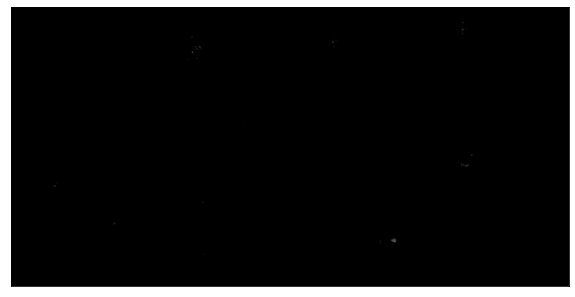



Actual Depth


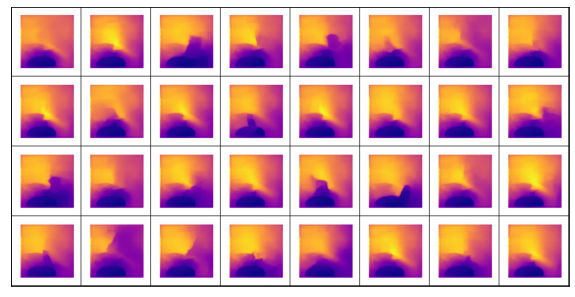

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


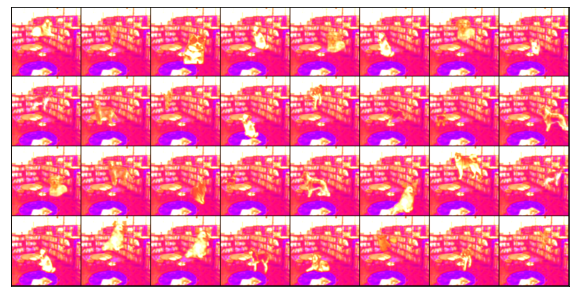

  6%|▋         | 1/16 [00:03<00:59,  3.99s/it]

  loss: 0.8393604755401611
Train Epoch: 40  [3/500  (6%)]	Loss:0.839360


Actual mask


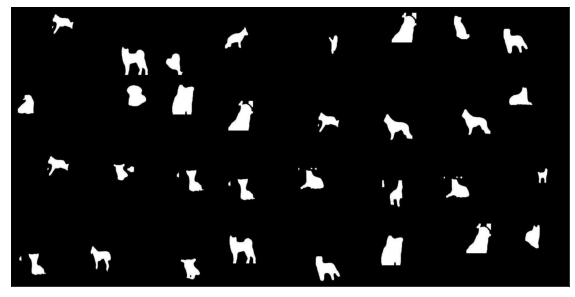

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


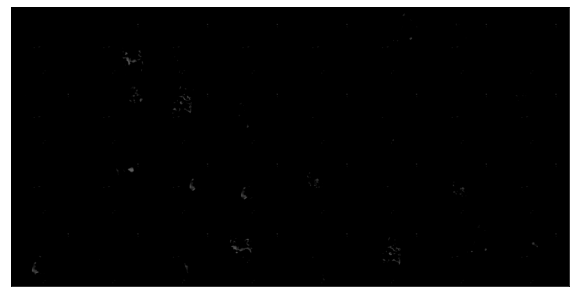



Actual Depth


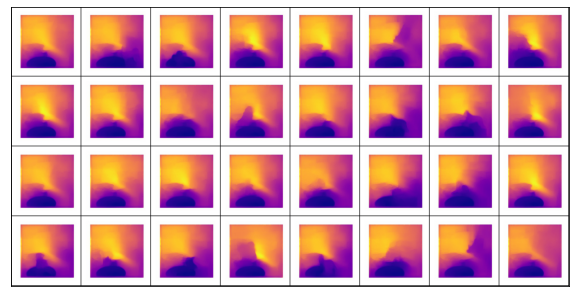

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


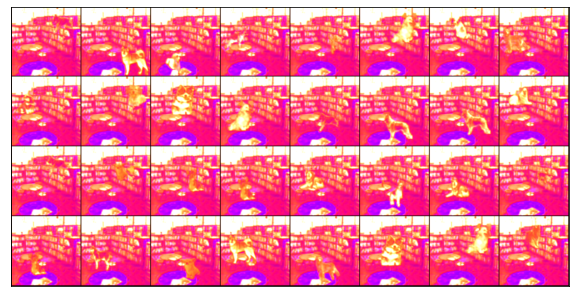

 12%|█▎        | 2/16 [00:07<00:55,  3.94s/it]

  loss: 0.7921334505081177
Train Epoch: 40  [6/500  (12%)]	Loss:0.792133


Actual mask


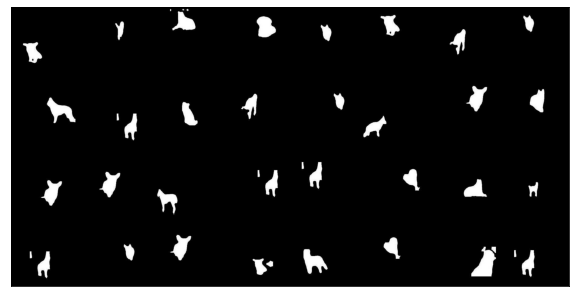

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


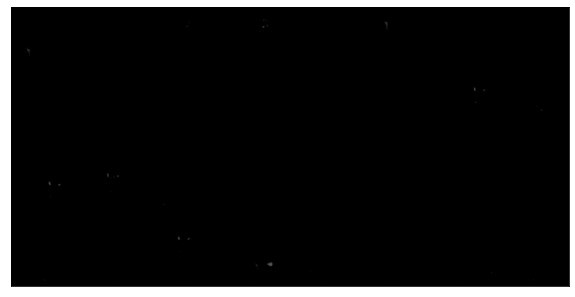



Actual Depth


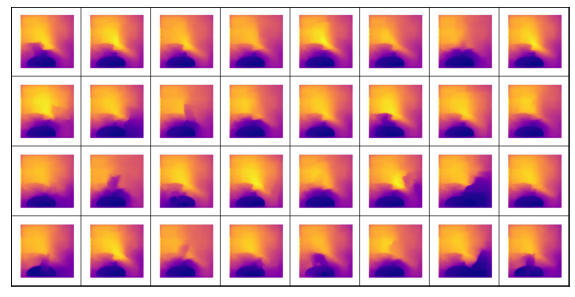

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


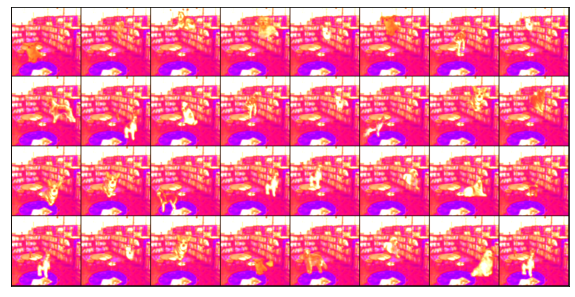

 19%|█▉        | 3/16 [00:11<00:50,  3.92s/it]

  loss: 0.8126968145370483
Train Epoch: 40  [9/500  (19%)]	Loss:0.812697


Actual mask


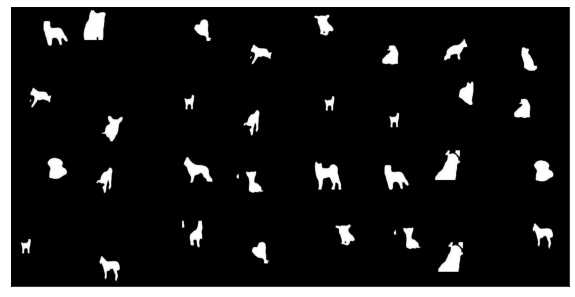

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


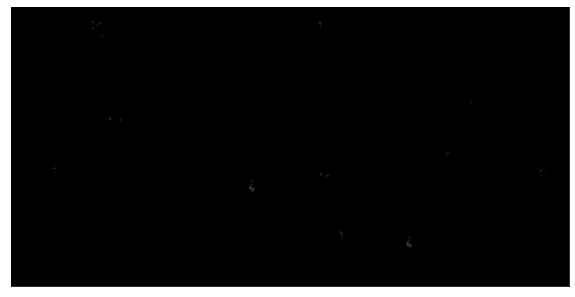



Actual Depth


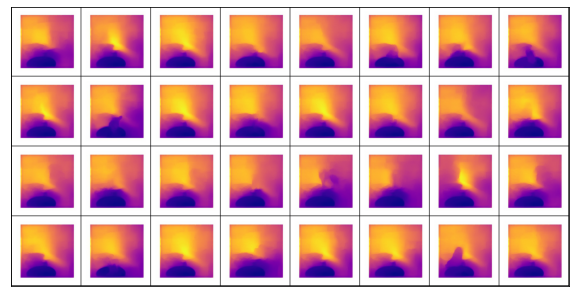

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


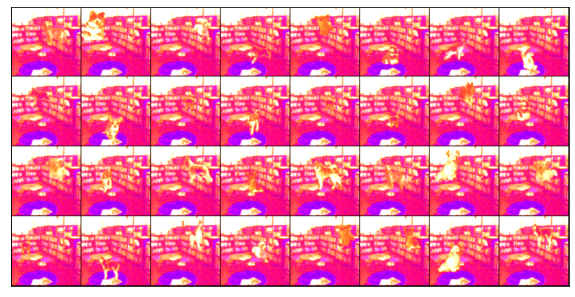

 25%|██▌       | 4/16 [00:15<00:46,  3.90s/it]

  loss: 0.8447039723396301
Train Epoch: 40  [12/500  (25%)]	Loss:0.844704


Actual mask


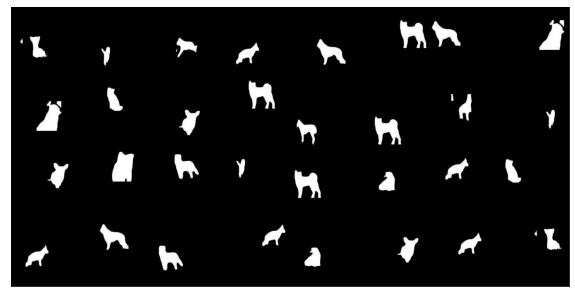

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


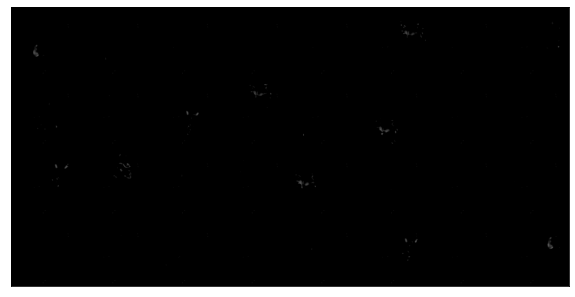



Actual Depth


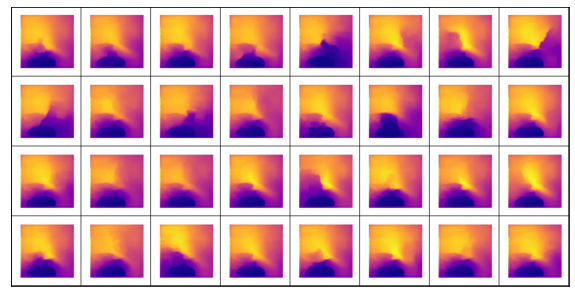

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


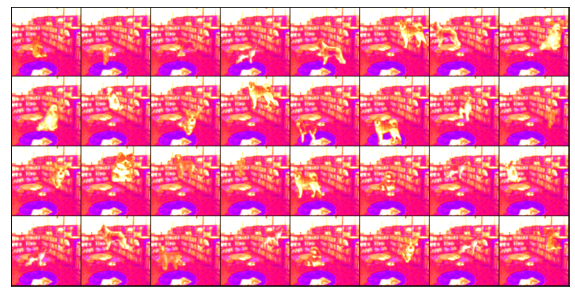

 31%|███▏      | 5/16 [00:19<00:42,  3.89s/it]

  loss: 0.8149136304855347
Train Epoch: 40  [15/500  (31%)]	Loss:0.814914


Actual mask


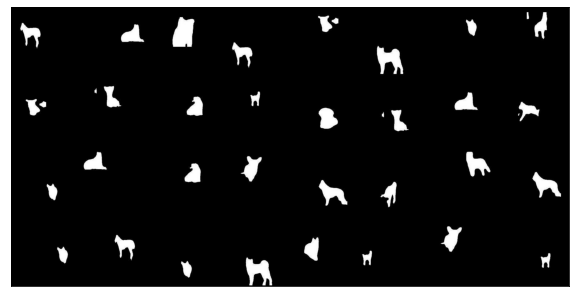

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


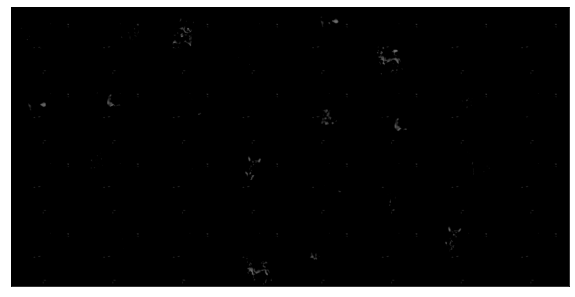



Actual Depth


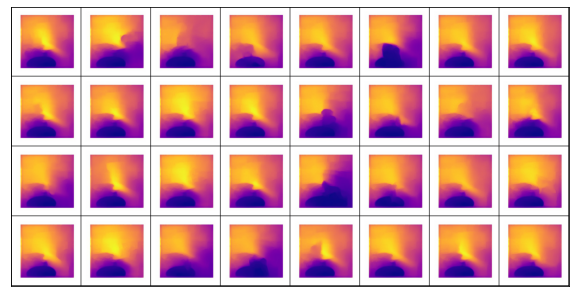

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


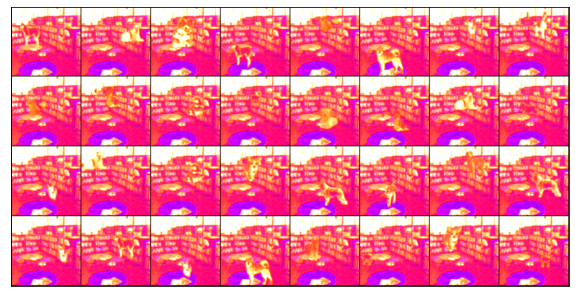

 38%|███▊      | 6/16 [00:23<00:38,  3.86s/it]

  loss: 0.8464146852493286
Train Epoch: 40  [18/500  (38%)]	Loss:0.846415


Actual mask


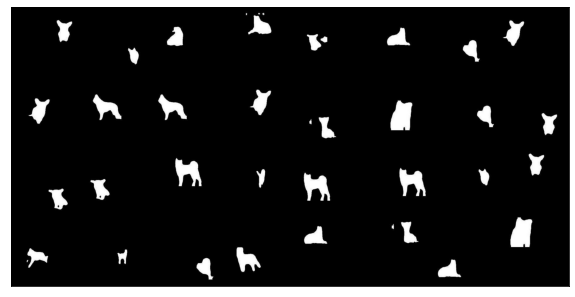

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


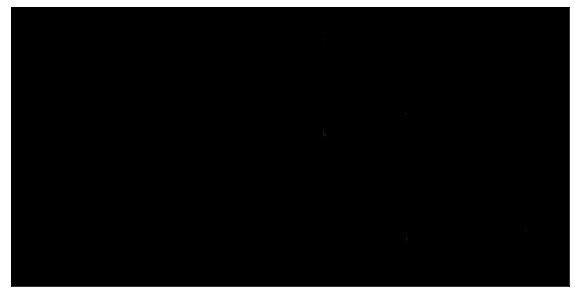



Actual Depth


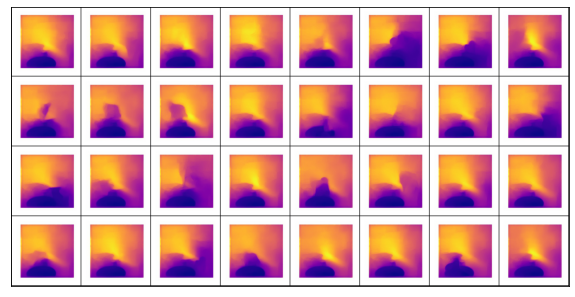

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth


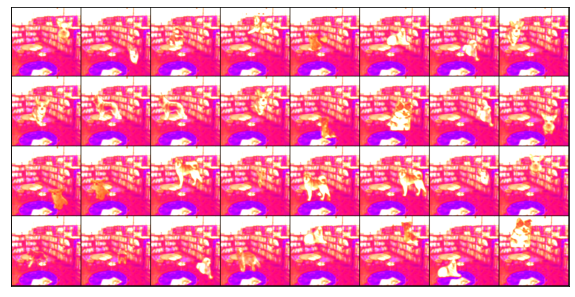

 44%|████▍     | 7/16 [00:27<00:34,  3.88s/it]

  loss: 0.7939026951789856
Train Epoch: 40  [21/500  (44%)]	Loss:0.793903


Actual mask


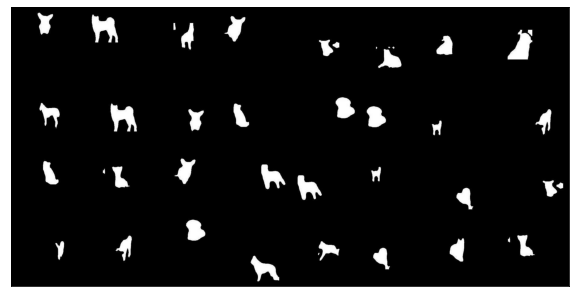

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted mask


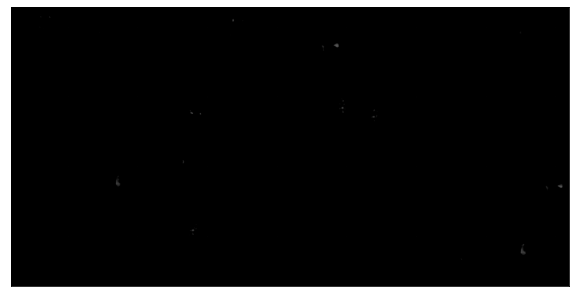



Actual Depth


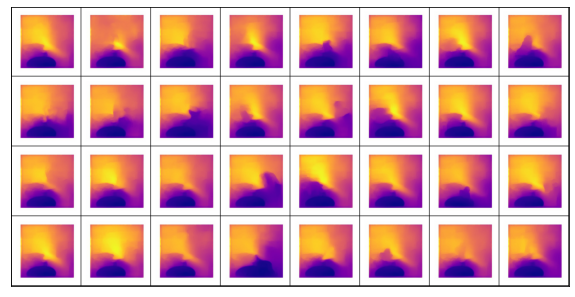

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Predicted Depth
Buffered data was truncated after reaching the output size limit.

In [37]:
for epoch in range(1, 100):
    print('Training Epoch: {}'.format(epoch))
    train(model, criterion, device, trainloader, optimizer, epoch=epoch)